# TANQUE SIMPLE

En esta notebook estudio el comportamiento en el caso mas simple de la industria, el llenado de un tanque mediante una entrada y una salida.

## Balance de masa:
A=E-S+G-C

En este caso, al tratarse de un caso simple, la tasa de evaporacion de agua se desprecia, por lo que no hay ni consumo (C) ni generacion (G), resultando en :

A= E-S

Siendo la Entrada y Salida en caudales, puede re arreglarse la ecuacion para epresarla en aaltura, que es lo que se busca controlar:

Area * dh/dt = Qin - Qout

## 1. Imports

In [1]:
!pip install torchinfo

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import random
import os

from typing import Dict, Any, List
import torch
import torch.nn as nn
from torchinfo import summary

import sys
sys.path.append('..')  # Subir un nivel para acceder a las carpetas

# Imports del proyecto
from Environment.simulation_env import SimulationPIDEnv # Ambiente de simulación PID
from Simuladores.tanque_simple import TankSimulator # Simulador de tanque simple
from Agentes.DQN.algorithm_DQN import DQNAgent  # Agente DQN
from utilis import train_DQN

# Configuración de matplotlib
plt.style.use('seaborn-v0_8-darkgrid')
%matplotlib inline

print("✅ Imports completados")
print(f"PyTorch version: {torch.__version__}")
print(f"Device disponible: {'cuda' if torch.cuda.is_available() else 'cpu'}")

✅ Imports completados
PyTorch version: 2.8.0+cu126
Device disponible: cuda


In [5]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Thu Oct 23 15:10:10 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   36C    P8              9W /   70W |       2MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [11]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('To enable a high-RAM runtime, select the Runtime > "Change runtime type"')
  print('menu, and then select High-RAM in the Runtime shape dropdown. Then, ')
  print('re-execute this cell.')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 13.6 gigabytes of available RAM

To enable a high-RAM runtime, select the Runtime > "Change runtime type"
menu, and then select High-RAM in the Runtime shape dropdown. Then, 
re-execute this cell.


In [10]:
torch.zeros(1).cuda()

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(f"Running on {DEVICE}")

random.seed(42)
np.random.seed(42)
torch.manual_seed(42)
torch.backends.cudnn.deterministic = True

print("Cuda Available:", torch.cuda.is_available())

Running on cuda:0
Cuda Available: True


## W&B

In [12]:
!pip install wandb

In [13]:
import wandb

wandb.login()


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter:

 ··········


wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: valeriaeskenazi (valeriaeskenazi-universidad-ort-uruguay) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


True

In [13]:
WANDB_TEAM_NAME = "valeriaeskenazi-universidad-ort-uruguay"
WANDB_PROJECT = "Tesis_maestría"

sweep_config = {
    "name": "pid_rl_dqn_experiments",
    "method": "bayes",  # ← Recomendado: explora inteligentemente
    # Opciones: "grid", "random", "bayes"

    "metric": {
        "name": "final_avg_reward",  # ← Métrica principal
        "goal": "maximize"  # ← Maximizar reward
    },

    "parameters": {
        # ========== ARQUITECTURA DE RED ==========
        "hidden_dims": {
            "values": [
                [32, 32],
                [64, 64],
                [128, 64],
                [128, 128, 64],
                [256, 128, 64]
            ]
        },

        # ========== HIPERPARÁMETROS DE AGENTE ==========
        "lr": {
            "values": [0.0001, 0.001, 0.01]
        },

        "gamma": {
            "values": [0.95, 0.99, 0.999]
        },

        "epsilon_decay": {
            "values": [0.99, 0.995, 0.999]
        },

        "batch_size": {
            "values": [32, 64, 128]
        },

        "memory_size": {
            "values": [5000, 10000, 20000]
        },

        "target_update_freq": {
            "values": [50, 100, 200]
        },

        # ========== PARÁMETROS DE AMBIENTE ==========
        "delta_percent": {
            "values": [0.1, 0.2, 0.3, 0.5]
        },

        "dead_band": {
            "values": [0.1, 0.2, 0.3]
        },

        # ========== ENTRENAMIENTO ==========
        "n_episodes": {
            "value": 200  # Fijo para todos los experimentos
        }
    }
}

sweep_id = wandb.sweep(sweep_config, project=WANDB_PROJECT)

Create sweep with ID: vew9hsm3
Sweep URL: https://wandb.ai/valeriaeskenazi-universidad-ort-uruguay/Tesis_maestr%C3%ADa/sweeps/vew9hsm3


In [15]:
def wandb_log_callback(episode, episode_reward, avg_reward, success_rate, epsilon, q_loss=None, steady_state_error=None):
    """
    Callback para loguear métricas a W&B por episodio.
    """
    log_dict = {
        "episode": episode,
        "episode_reward": episode_reward,
        "avg_episode_reward": avg_reward,
        "success_rate": success_rate,
        "epsilon": epsilon
    }

    if q_loss is not None:
        log_dict["q_loss"] = q_loss

    if steady_state_error is not None:
        log_dict["steady_state_error"] = steady_state_error

    wandb.log(log_dict)

In [15]:
def sweep_run():
    """
    Función que se ejecutará en cada run del sweep.
    """
    # Inicializar un nuevo run
    wandb.init()
    os.makedirs('results', exist_ok=True)
    os.makedirs('models', exist_ok=True)

    # ========== REPRODUCIBILIDAD ==========
    SEED = 42
    random.seed(SEED)
    np.random.seed(SEED)
    torch.manual_seed(SEED)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(SEED)
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False

    # Loguear la semilla en W&B
    wandb.config.update({"seed": SEED}, allow_val_change=True)

    # Leer la configuración del run
    config = wandb.config
    run_hidden_dims = config.hidden_dims
    run_lr = config.lr
    run_gamma = config.gamma
    run_epsilon_decay = config.epsilon_decay
    run_batch_size = config.batch_size
    run_memory_size = config.memory_size
    run_target_update_freq = config.target_update_freq
    run_delta_percent = config.delta_percent
    run_dead_band = config.dead_band
    run_n_episodes = config.n_episodes

    # ========== CONFIGURAR AMBIENTE ==========
    env_config = {
        'upper_range': 10.0,
        'lower_range': 0.0,
        'setpoint': 5.0,
        'dead_band': run_dead_band,
        'max_episode_steps': 200,
        'dt': 1.0,
        'delta_percent': run_delta_percent,
        'initial_pid': (1.0, 0.1, 0.05)
    }

    env = SimulationPIDEnv(config=env_config, control_mode='pid_tuning')
    tank = TankSimulator(area=1.0, cv=0.1, max_height=10.0, max_flow_in=0.5, dt=1.0)
    env.connect_external_process(tank)

    # ========== CONFIGURAR AGENTE ==========
    agent = DQNAgent(
        state_dim=6,
        action_dim=7,
        hidden_dims=tuple(run_hidden_dims),
        lr=run_lr,
        gamma=run_gamma,
        epsilon_start=1.0,
        epsilon_min=0.01,
        epsilon_decay=run_epsilon_decay,
        memory_size=run_memory_size,
        batch_size=run_batch_size,
        target_update_freq=run_target_update_freq,
        device='cpu'
    )

  # ========== ENTRENAR CON LOGGING PROGRESIVO ==========
    results = test_with_visualization(
        n_episodes=run_n_episodes,
        env_config=env_config,
        agent=agent,
        save_path=f'results/sweep_{wandb.run.name}.png',
        log_callback=wandb_log_callback  # ← Pasar callback
    )

    # ========== LOGUEAR MÉTRICAS FINALES ADICIONALES ==========
    tracker_summary = results['tracker_summary']

    wandb.log({
        "final_avg_reward": tracker_summary['avg_episode_reward'],
        "final_success_rate": tracker_summary['success_rate'],
        "final_epsilon": results['agent_epsilon'],
        "total_episodes": tracker_summary['total_episodes']
    })

    # Guardar modelo
    model_path = f"models/pid_dqn_{wandb.run.name}.pth"
    agent.save(model_path)
    wandb.save(model_path)

    # Guardar gráfico
    wandb.save(f'results/sweep_{wandb.run.name}.png')

    print(f"\n✅ Run completado: {wandb.run.name}")
    print(f"   Reward promedio: {tracker_summary['avg_episode_reward']:.2f}")
    print(f"   Tasa de éxito: {tracker_summary['success_rate']:.2%}")

    wandb.finish()

wandb: Agent Starting Run: v4r62x2k with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [32, 32]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


/usr/local/lib/python3.12/dist-packages/gymnasium/spaces/box.py:236: UserWarning: WARN: Box low's precision lowered by casting to float32, current low.dtype=float64
  gym.logger.warn(
/usr/local/lib/python3.12/dist-packages/gymnasium/spaces/box.py:306: UserWarning: WARN: Box high's precision lowered by casting to float32, current high.dtype=float64
  gym.logger.warn(


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (32, 32)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  190.29 | Avg:  190.29 | ε: 0.694 | Suc

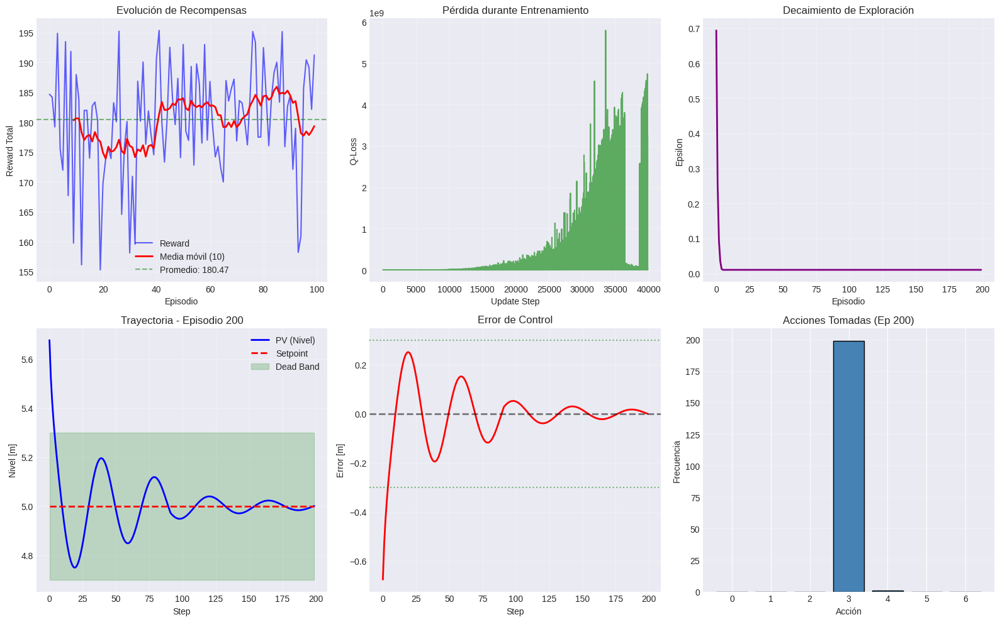


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       156
  Tasa de éxito:            78.00%
  Reward promedio (global): 180.47
  Error estado estacionario: 0.1322

  Últimos 10 episodios:
    Reward promedio:        179.34
    Desviación estándar:    11.30

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_drawn-sweep-1.pth

✅ Run completado: drawn-sweep-1
   Reward promedio: 180.47
   Tasa de éxito: 78.00%


avg_episode_reward,█▇▇▆▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▃▃▃▃▃▄▄▄▄▄
episode,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
episode_reward,██▆▇▅▇▅▇▇▅▁▃▅▁▁▅▂▂▇▁▆▇█▆▅█▇▅▇▅▇▅▅▅█▆▄▄▅█
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▅▆▆▅█▂▂▂▂▃
steady_state_error,▁▂▂▁▂▂▂▂▁▂██▇▇▂▆▁██▄▁▁▁█▁█▂▁▁▂▁▁▂▁▁▁▁▂▁█
success_rate,▂▇██▇▆▆▄▃▂▂▂▁▁▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅
+1,...


wandb: Agent Starting Run: gr7gtyuw with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  182.84 | Avg:  182.84 | ε: 0.429 | 

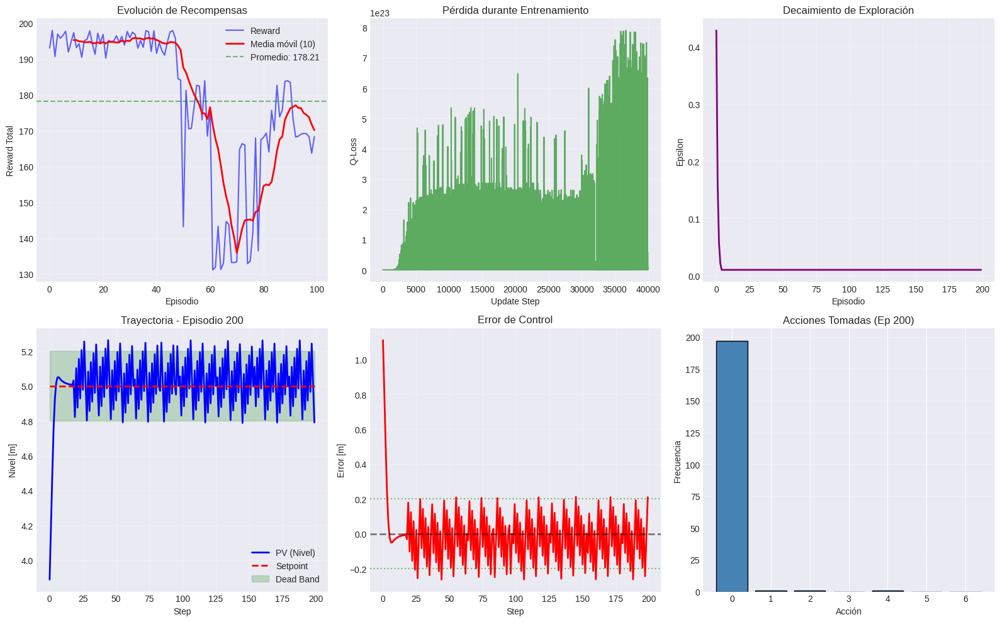


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       131
  Tasa de éxito:            65.50%
  Reward promedio (global): 178.21
  Error estado estacionario: 0.2310

  Últimos 10 episodios:
    Reward promedio:        170.14
    Desviación estándar:    4.96

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_swept-sweep-2.pth

✅ Run completado: swept-sweep-2
   Reward promedio: 178.21
   Tasa de éxito: 65.50%


avg_episode_reward,▇▂▂▂▃▃▃▃▃▃▂▂▁▁▁▂▂▂▂▃▃▃▃▃▄▅▅▅▆▆▆▆▇▇████▇▇
episode,▁▁▁▂▂▂▂▂▂▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇██
episode_reward,▆▃▁▂▆▆▆▆▆▆▂▁▁███▇███▇████▇███▂▅▅▆▁▅▅▆▇▅▅
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▂▃▃▃▃▃▄▄▄█▄▅▄▆▄▄▅▄▄▅▄▃▄▄▃▄▂▄▂▃▃▃▃▄▆▂▅▅▄
steady_state_error,▅██▁▁▂▇█▂█▇▇█▇██▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂█▂▂▁▁▂▁
success_rate,▁▁▁▁▁▂▃▄▃▄▆▆▆▅▅▅▄▄▅▅▆▆▇▇▇▇▇█████████████
+1,...


wandb: Agent Starting Run: at5h8jcb with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  191.95 | Avg:  191.95 | ε: 0.694

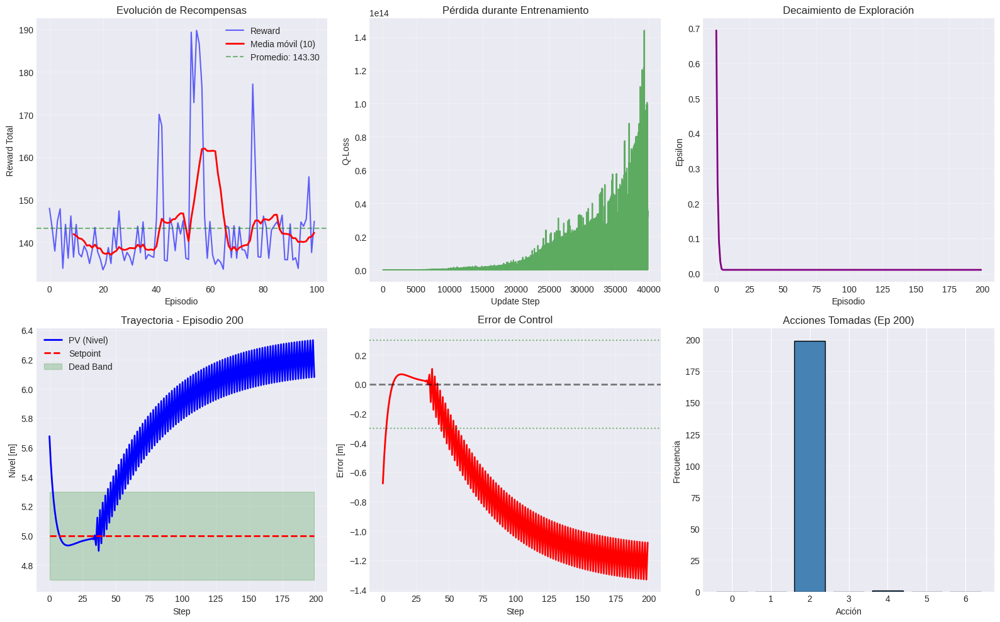


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       32
  Tasa de éxito:            16.00%
  Reward promedio (global): 143.30
  Error estado estacionario: 1.0934

  Últimos 10 episodios:
    Reward promedio:        142.25
    Desviación estándar:    6.08

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_glorious-sweep-3.pth

✅ Run completado: glorious-sweep-3
   Reward promedio: 143.30
   Tasa de éxito: 16.00%


avg_episode_reward,█▇██▇▅▅▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
episode,▁▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇██
episode_reward,█▅▇▆▁▁▂▁▁▁▁▁▂▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▂▂▁▂▂▂▂▇▂▁▁▂
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▃▃▃▃▄▄▄▅▅▅█
steady_state_error,▂▁▁▁█████▂▇████████▇███▇▇▇▇▅▇▁▁█▇█▇▇▇▇▇█
success_rate,██▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: f3h76b15 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.04 | Avg:  186.04 | ε: 0.480 | 

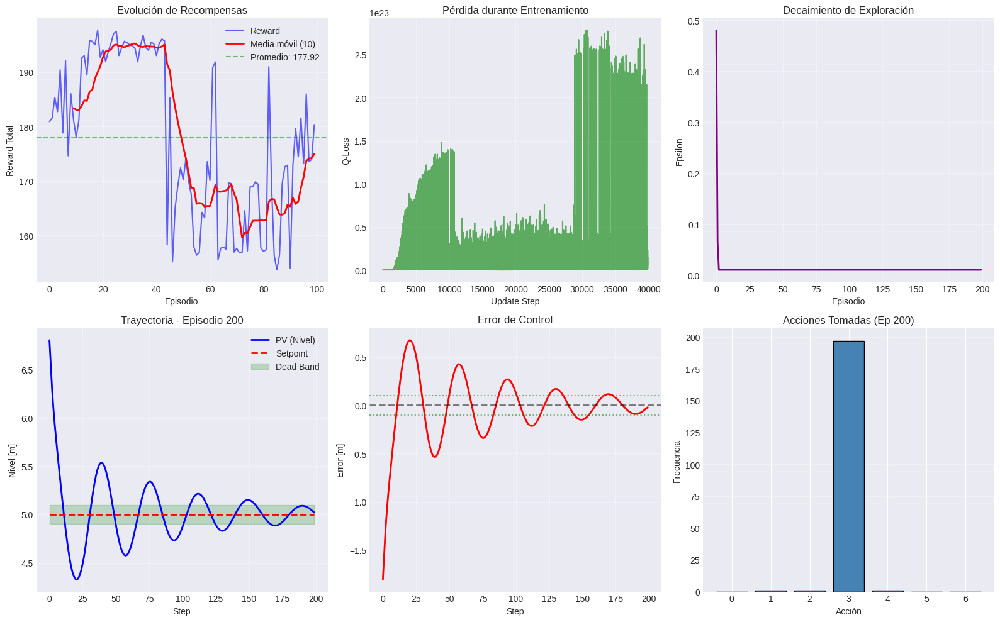


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       154
  Tasa de éxito:            77.00%
  Reward promedio (global): 177.92
  Error estado estacionario: 0.0761

  Últimos 10 episodios:
    Reward promedio:        174.98
    Desviación estándar:    8.17

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_cerulean-sweep-4.pth

✅ Run completado: cerulean-sweep-4
   Reward promedio: 177.92
   Tasa de éxito: 77.00%


avg_episode_reward,▃▃▃▄▅▆███▇▆▆▆▅▄▂▂▂▂▂▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▃▃
episode,▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇██
episode_reward,▄▅▆█▇█▂▁▂▃▃▂▄▁▁▃▁▄▁▆▃▂▄▄▅▇▇▇█████▁▃▁▃▁▃▅
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▂▄▃▃▃▄▄▃▄▆▅▅▆▅▅▆▅▅▅▅▄▄▄▅▄▄▃▃▃▃▅▅▅▆▅▅█▇
steady_state_error,▇▆▅▇▁▁▁▁▁▁████▇▆▇▇▇▇▄▃▄▁▂▁▁▁▁███▇▇▇█▇▆▅▇
success_rate,▁▃▃▄▅▇▇▇█████████▇▇▇▇▇▇█████████████████
+1,...


wandb: Agent Starting Run: ra32izzq with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.49 | Avg:  185.49 | ε: 0.480 | 

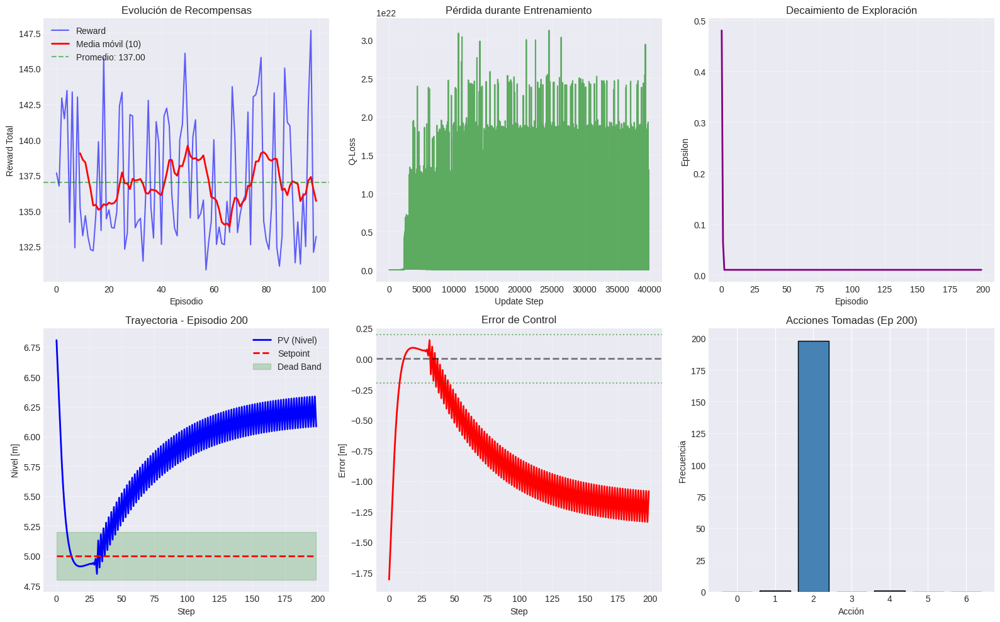


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       12
  Tasa de éxito:            6.00%
  Reward promedio (global): 137.00
  Error estado estacionario: 1.1444

  Últimos 10 episodios:
    Reward promedio:        135.69
    Desviación estándar:    5.09

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_sleek-sweep-5.pth

✅ Run completado: sleek-sweep-5
   Reward promedio: 137.00
   Tasa de éxito: 6.00%


avg_episode_reward,███▇▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
episode,▁▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇███
episode_reward,▆█▇▂▃▂▂▃▃▁▂▂▃▃▂▁▂▁▂▁▁▁▂▁▁▂▁▂▂▂▁▁▂▃▂▃▃▁▁▁
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▄▅▆▆▆▇▇▇▆▇▇▇▇▇▇▆▆▇▆▆▆▇▆▇▇▇▆▇▆▆██▆▇▆▆
steady_state_error,▁▁████▆██▇█████▇█▆██▇██▇▇▇██▇██▇▇█▇▇█▇▄█
success_rate,██▇▇▆▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 9es5wh6f with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [32, 32]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (32, 32)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.26 | Avg:  189.26 | ε: 0.844 | Succes

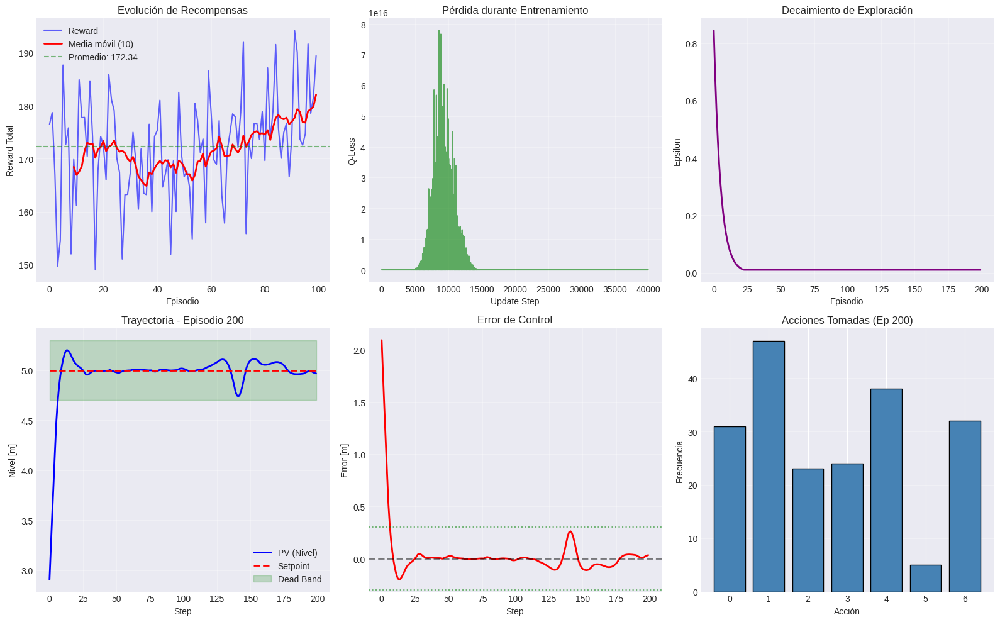


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       104
  Tasa de éxito:            52.00%
  Reward promedio (global): 172.34
  Error estado estacionario: 0.4430

  Últimos 10 episodios:
    Reward promedio:        182.09
    Desviación estándar:    8.01

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_bright-sweep-6.pth

✅ Run completado: bright-sweep-6
   Reward promedio: 172.34
   Tasa de éxito: 52.00%


avg_episode_reward,██▇▄▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▁▁▁▁▁▂▂▂▂▂▂▂▂▂▃
episode,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇██
episode_reward,█▄▂▂▄▂▁▃▂▄▆▆▄▄▆▄▇▅▃▂▅▃▅▄▃▅▄▃▂▄▄▃▁▄▁▄▅▄▅▆
epsilon,█▄▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▂▃▅█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▂▄▂▅▇▇▇▇▇▇▁▁▅▁▂▁▁▁▆▂▂▁▂▁▅▂█▇▇▇▃▇█▅▂▇▅▅▁▁
success_rate,███▇▅▃▂▁▁▁▁▂▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
+1,...


wandb: Agent Starting Run: 6tnh0npl with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.83 | Avg:  189.83 | ε: 0.694 |

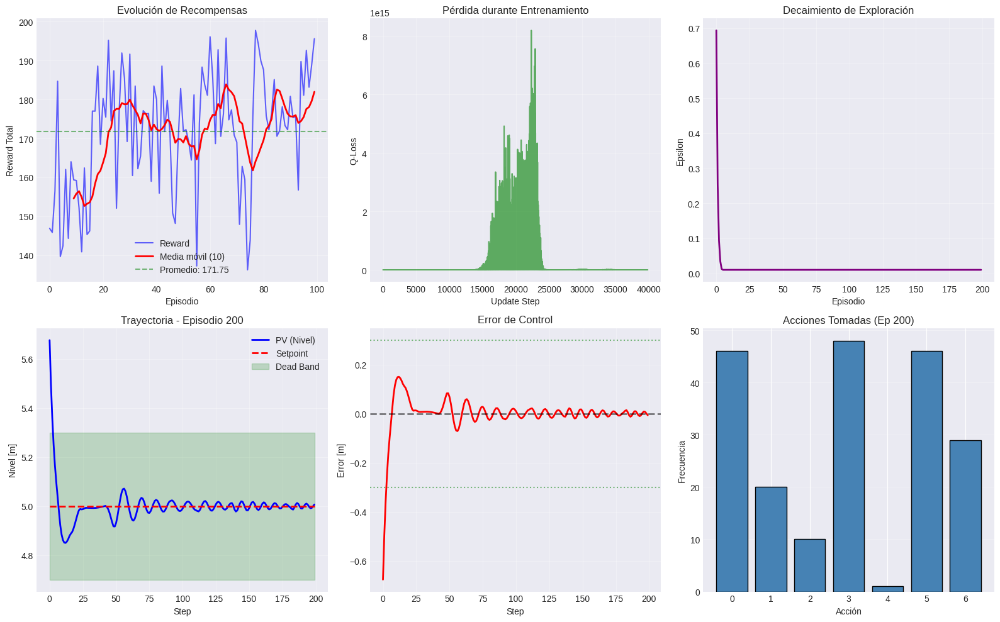


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       115
  Tasa de éxito:            57.50%
  Reward promedio (global): 171.75
  Error estado estacionario: 0.5231

  Últimos 10 episodios:
    Reward promedio:        181.95
    Desviación estándar:    10.64

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_comic-sweep-7.pth

✅ Run completado: comic-sweep-7
   Reward promedio: 171.75
   Tasa de éxito: 57.50%


avg_episode_reward,█████▇▇▇▇▇▇▇▇▇▇▆▅▄▄▄▄▄▄▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▂▂
episode,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅▆▆▇▇▇▇▇▇██
episode_reward,█▆▇▅█▆▇▆▅▇▆▄▂▂▅▆▅▆▅▂▂▁▂▆▄▅▅▄▆▇▅▂▄▃█▅▆▅▆█
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▃▅▅▅▅▄▆█▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▂▁▂▁▂▁▁▅▁▁█▆▃█▄▂█▂██▁▂▃▁▇▁▁▇▅▄▃▄▁▂▁▁▂▄▁▂
success_rate,███▇▇▇▇▇▇█▇▇▇▇▆▇▆▆▅▅▄▄▄▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: bmzgnwft with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.28 | Avg:  189.28 | ε: 0.183 | Succes

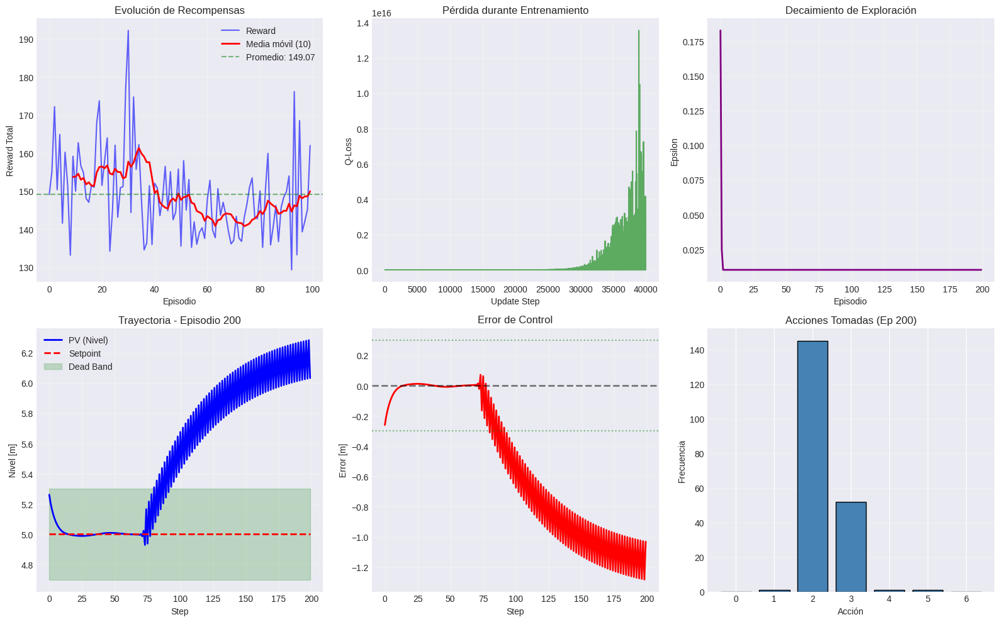


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       39
  Tasa de éxito:            19.50%
  Reward promedio (global): 149.07
  Error estado estacionario: 1.1423

  Últimos 10 episodios:
    Reward promedio:        149.93
    Desviación estándar:    14.48

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_sleek-sweep-8.pth

✅ Run completado: sleek-sweep-8
   Reward promedio: 149.07
   Tasa de éxito: 19.50%


avg_episode_reward,█▅▄▅▄▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▄▄▄▄▄▄▄▄▄▃▃▃▂▂▂▂▂▂▁▁
episode,▁▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇██
episode_reward,█▇▃▆▄▄▂▂▅▅▅▅▇█▇▅▆▅▃▄▅▄▁▃▁▃▁▁▃▂▂▁▂▂▃▂▃▃▃▅
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▃▂▃▂▃▅▅▇█
steady_state_error,▁▇▅██▆█▄▂▄▂▄▂▂▁▁▇▇▇▆▇▆█▆▆▇█▇███▇█▇▇▇▇██▇
success_rate,▆▃▂▄▄▁▁▁▁▂▂▃▃▄▇██▇▆▆▆▆▆▅▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▃
+1,...


wandb: Agent Starting Run: vnmetkpr with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  184.06 | Avg:  184.06 | ε: 0.844 | Succ

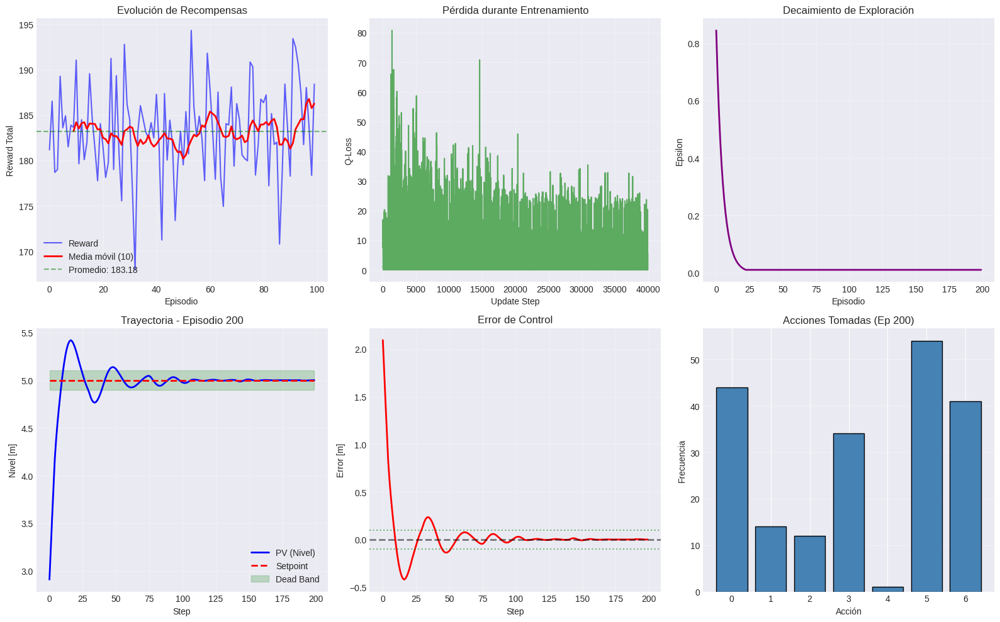


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       112
  Tasa de éxito:            56.00%
  Reward promedio (global): 183.18
  Error estado estacionario: 0.1479

  Últimos 10 episodios:
    Reward promedio:        186.24
    Desviación estándar:    5.20

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_celestial-sweep-9.pth

✅ Run completado: celestial-sweep-9
   Reward promedio: 183.18
   Tasa de éxito: 56.00%


avg_episode_reward,█▆▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▂▂▂▂▂▁▁▂▂▂▂▂▂▃▂▂▃▃▃▃▃▄
episode,▁▁▂▂▂▂▂▂▂▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇████
episode_reward,▅▅▅▃▆▃▆▃▃▅▄▂▇▂▂▇▁▆█▆▄▅▄▄▃▄▆▄▅▅▁▄▄▄▅▅▅▆▆▃
epsilon,█▇▅▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▃▃▃█▄▄▆▃▄▃▂▂▂▅▂▅▃▄▂▂▂▂▂▃▂▃▂▂▃▃▂▃▁▂▁▂▂▂▁▁
steady_state_error,▁▂▃█▃▅▁▂▁▁▅▁▂▁▃▃▁▁▁▁▄▁▂▇▆▃▆▁▆▃▂▂▂▁▂▂▁▁▁▁
success_rate,█▄▅▃▃▃▃▂▂▂▁▁▁▂▁▂▁▂▂▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▃▃
+1,...


wandb: Agent Starting Run: 4eb3et8r with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.0001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  188.84 | Avg:  188.84 | ε: 0.480 |

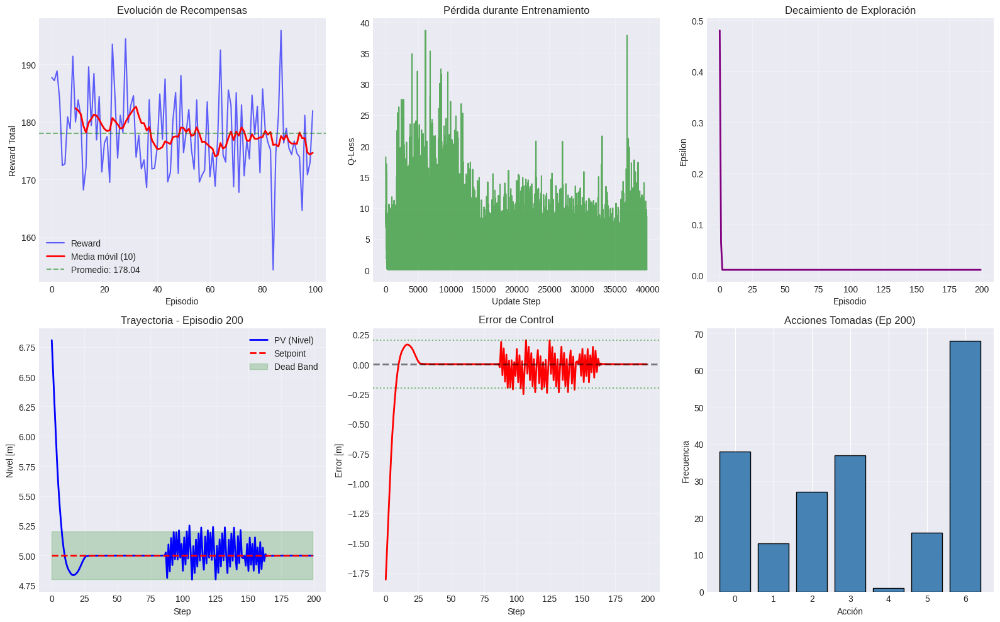


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       142
  Tasa de éxito:            71.00%
  Reward promedio (global): 178.04
  Error estado estacionario: 0.1950

  Últimos 10 episodios:
    Reward promedio:        174.64
    Desviación estándar:    4.68

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_upbeat-sweep-10.pth

✅ Run completado: upbeat-sweep-10
   Reward promedio: 178.04
   Tasa de éxito: 71.00%


avg_episode_reward,██▃▄▄▃▄▄▄▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂
episode,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇███
episode_reward,█▃▅▆▄▁▃▆▃▂▅▄▂▂▃▄▃▄▃▄▅▁▃▆▃▄▅▄▄▆▆▆▂▂▃█▃▃▁▅
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▁▁▂▂▂▁▁▂▁▂▁▂▁▁▁▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▂▁▁▁▁▁▃▂▂▁▂▂▅▂▇▂▁▃▂▂█▇▁▁▅▁▂▄▂▁▂▂▁█▂▂▇▁▁▃
success_rate,▄█▃▄▃▁▂▃▃▃▃▂▁▁▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▂▃▂▃▂
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 4bak22ni with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.01
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  190.25 | Avg:  190.25 | ε: 0.844 | Succe

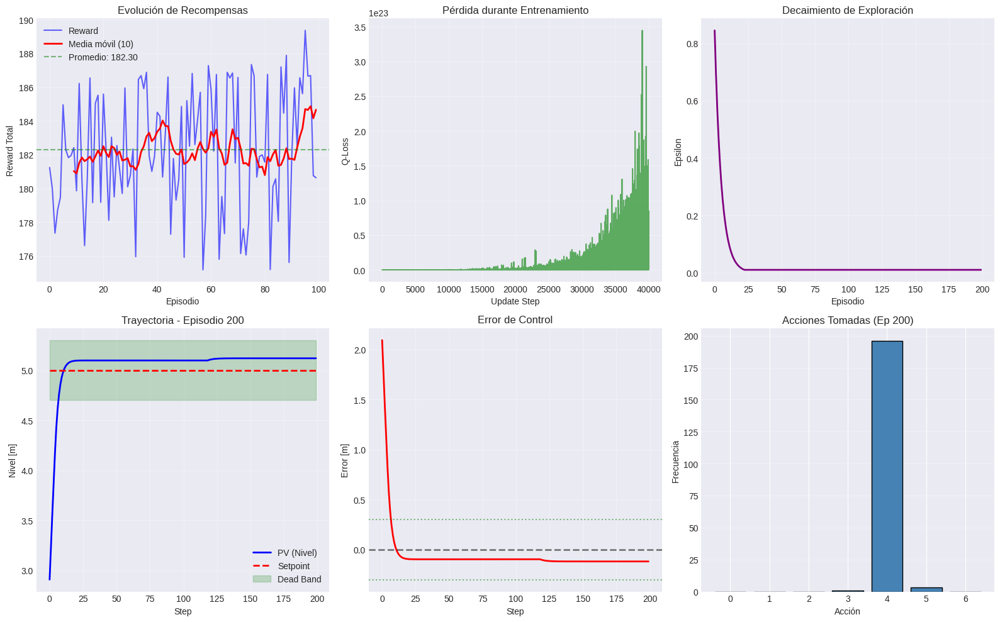


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       196
  Tasa de éxito:            98.00%
  Reward promedio (global): 182.30
  Error estado estacionario: 0.1002

  Últimos 10 episodios:
    Reward promedio:        184.66
    Desviación estándar:    2.83

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_zany-sweep-11.pth

✅ Run completado: zany-sweep-11
   Reward promedio: 182.30
   Tasa de éxito: 98.00%


avg_episode_reward,█▆▆▂▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂
episode,▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
episode_reward,█▄▅▇▁▇▇▂▄▃▇▄▅▃▁▃▄▄▇▃▄▆▄▅▃▇▇▄▆▂▄▃▇▇▃▅▅▇▇▇
epsilon,█▅▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▃▄▄▅▆█
steady_state_error,▂▁▅█▃▂▃▃▂▂▂▂▃▂▃▂▃▂▂▂▃▃▂▃▃▂▃▂▂▃▃▃▂▂▂▂▂▂▂▂
success_rate,██▄▄▄▃▁▁▂▂▄▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
+1,...


wandb: Agent Starting Run: j5t1ayxm with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [32, 32]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (32, 32)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  190.06 | Avg:  190.06 | ε: 0.503 | Succ

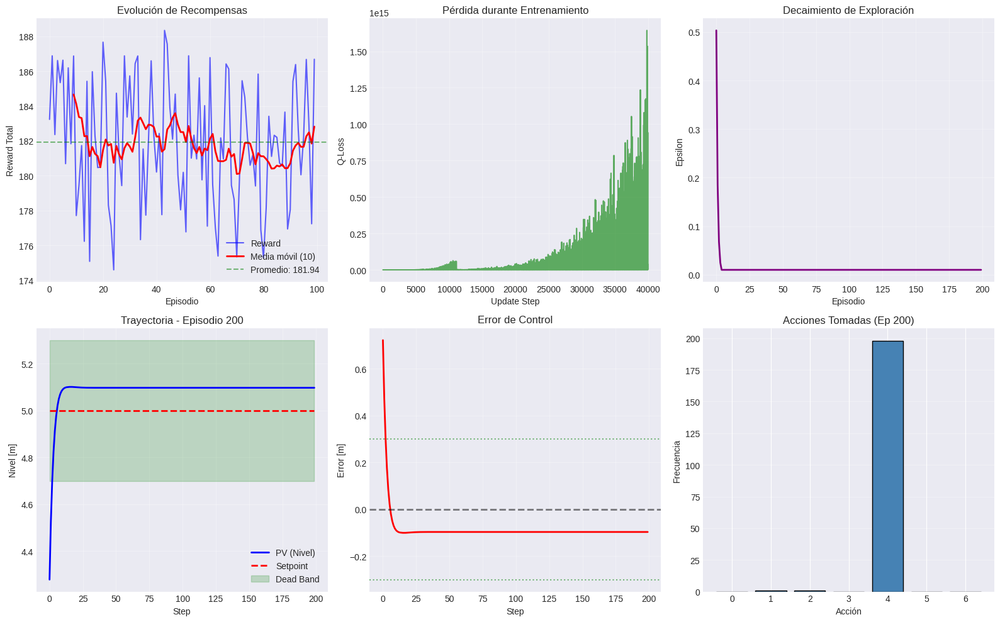


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       195
  Tasa de éxito:            97.50%
  Reward promedio (global): 181.94
  Error estado estacionario: 0.1001

  Últimos 10 episodios:
    Reward promedio:        182.82
    Desviación estándar:    3.33

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_clear-sweep-12.pth

✅ Run completado: clear-sweep-12
   Reward promedio: 181.94
   Tasa de éxito: 97.50%


avg_episode_reward,▅▁▁▁▃▅▆▇▇██▇▇▇▇▇▇▇▇▇▇████████▇▇▇▇▇██▇█▇▇
episode,▁▁▁▁▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▆▆▇▇████
episode_reward,▆█▁▄▅▄▂█▅▃█▆▄▅▄▅▃▃▂▅▃▄▄▅▅▄▄▅▅▄▅▃▄▅▂▃▃▂▃▅
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▃▂▂▃▂▃▃▄▄▄▇▆▅▇█
steady_state_error,█▁▁▁▁▁▁▁▂▁▂▂▂▁▂▁▂▂▂▁▂▂▂▂▂▂▁▂▂▂▁▂▂▂▂▂▂▂▁▂
success_rate,▁▂▃▅▅▆▆▆▇▇▇▇▇▇▇█████████████████████████
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ky8ov735 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.37 | Avg:  189.37 | ε: 0.930 |

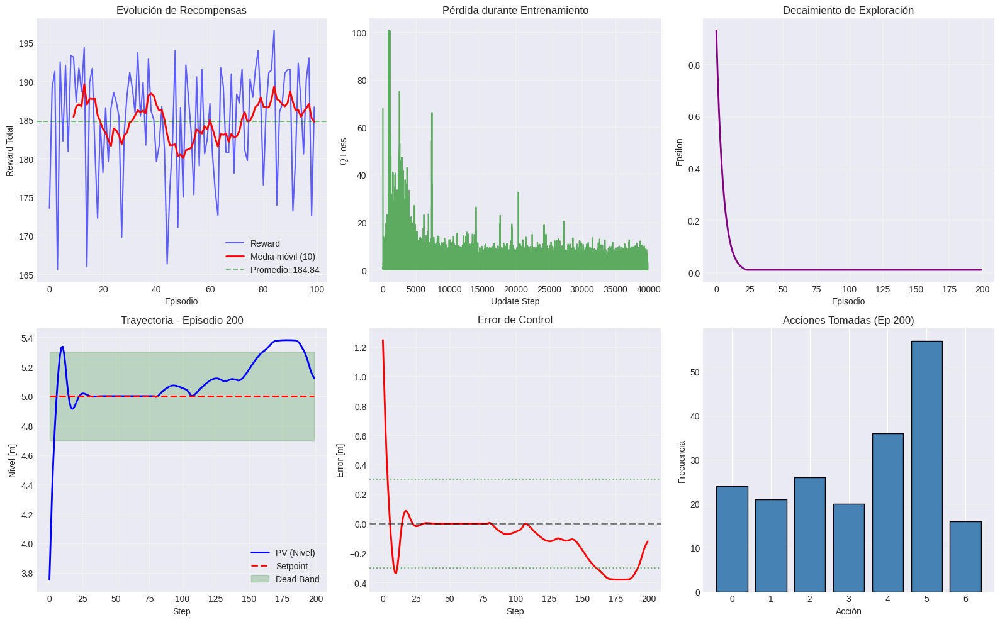


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       184
  Tasa de éxito:            92.00%
  Reward promedio (global): 184.84
  Error estado estacionario: 0.1055

  Últimos 10 episodios:
    Reward promedio:        184.75
    Desviación estándar:    7.30

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_stellar-sweep-13.pth

✅ Run completado: stellar-sweep-13
   Reward promedio: 184.84
   Tasa de éxito: 92.00%


avg_episode_reward,█▇▅▃▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▂▂▂▂▂▂▂▂▂▂▂▃▃▃
episode,▁▁▁▁▁▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇█████
episode_reward,▇▇▆▄▃▅▃▆▃▃▆▆▃▇▅▇▇█▅▃▆▇▇█▁▇█▄▆▄▄▅▅▄█▃▆▇▇▆
epsilon,█▇▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▃▃▃▂▂▂▂▂▄▁▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▂▂▁▁▆▄▂▁▄▁▄▁▄▂▁▄▂▁▃█▁▁▁▂▃▄▁▃▅▁▂▃▁▁▃▁▁▃▃
success_rate,█▁▂▅▁▂▂▁▂▃▃▄▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅
+1,...


wandb: Agent Starting Run: u8yxce3g with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  190.90 | Avg:  190.90 | ε: 0.844 | 

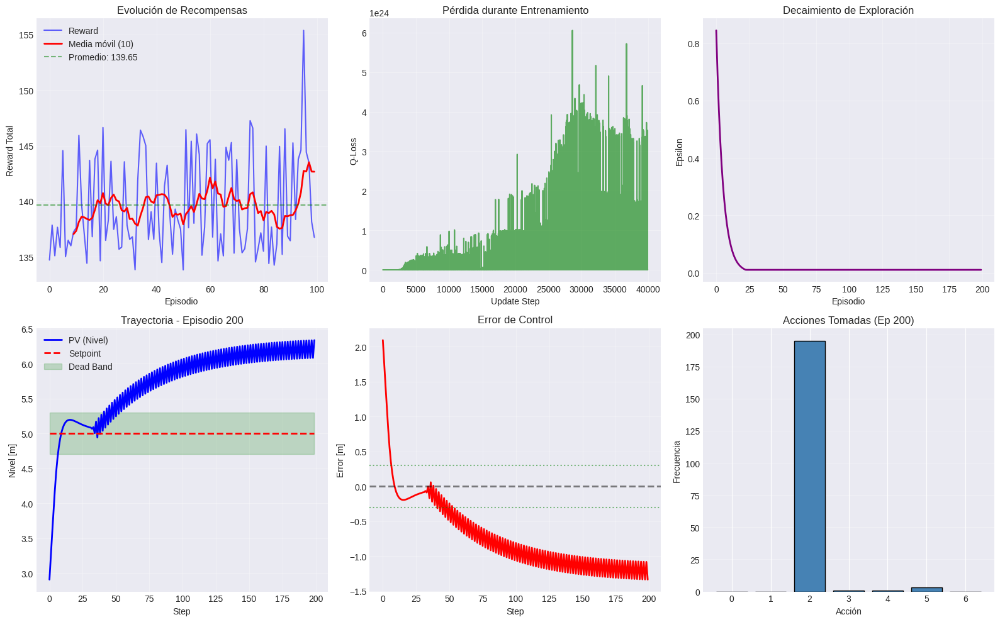


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       58
  Tasa de éxito:            29.00%
  Reward promedio (global): 139.65
  Error estado estacionario: 1.1660

  Últimos 10 episodios:
    Reward promedio:        142.65
    Desviación estándar:    5.38

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_pretty-sweep-14.pth

✅ Run completado: pretty-sweep-14
   Reward promedio: 139.65
   Tasa de éxito: 29.00%


avg_episode_reward,███▇▇████████▇▇▇▇▇▆▆▆▆▆▆▅▅▅▄▃▃▃▃▂▂▂▁▁▁▁▁
episode,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇██
episode_reward,▇▄▅▅▆▇▆▇▇▇▅▄▆▇█▅▁▁▂▁▁▁▁▂▂▁▂▁▂▂▁▂▂▁▁▁▁▁▁▂
epsilon,█▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▃▃▃▄▅▅▅▆▅▇▇▆▆▅▆▆▆█▇▆▆▆▆▇
steady_state_error,▁▁▅▄▄▂▂▂▂▂▁▁▂▁▂▁▆▇███▇▇▇██▇█▇▇▇▇▇▆▇██▆▇▇
success_rate,██▆▄▃▂▂▃▃▃▄▄▅▅▅▅▅▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁
+1,...


wandb: Agent Starting Run: d2izgc07 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.0001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.33 | Avg:  189.33 | ε: 0.480 | Succ

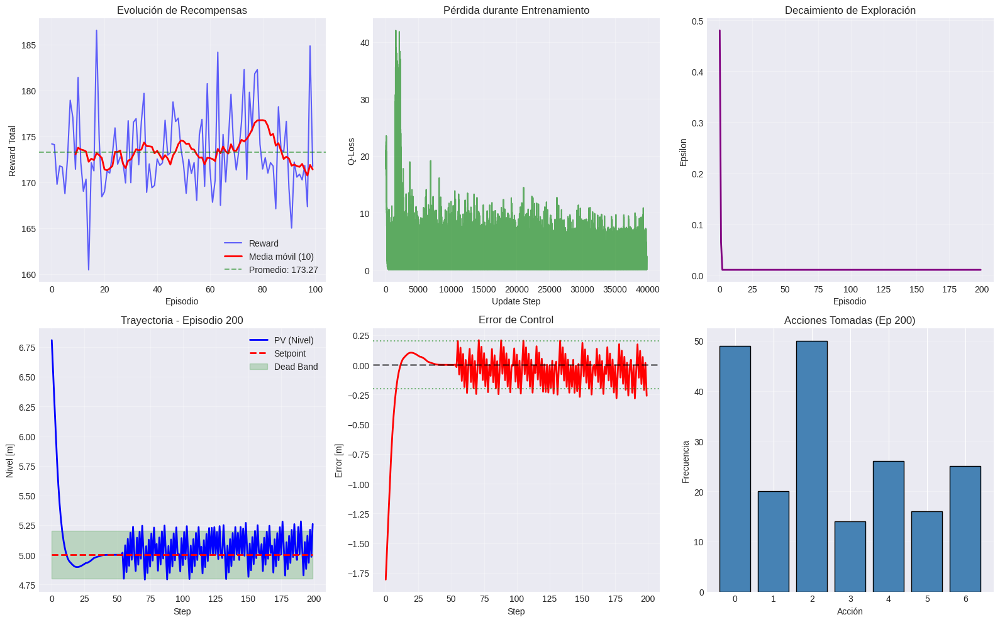


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       152
  Tasa de éxito:            76.00%
  Reward promedio (global): 173.27
  Error estado estacionario: 0.1121

  Últimos 10 episodios:
    Reward promedio:        171.38
    Desviación estándar:    4.95

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_zany-sweep-15.pth

✅ Run completado: zany-sweep-15
   Reward promedio: 173.27
   Tasa de éxito: 76.00%


avg_episode_reward,█▂▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▂▁▁▁
episode,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇██
episode_reward,▇▇▃▁▅▅▅▅▄▅▆▆▅▅▇█▅▅▄▄▆▄▅▄▅▄▄▅▄▄▄▄▅▅▆▄▄▆▅▇
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▂▂█▂▂▂▁▂▂▂▂▁▂▂▂▂▂▂▁▂▂▂▂▂▂▁▁▁▁▂▂▁▂▁▁▁▁▁▁▁
steady_state_error,▁▁▄▁▁▄▄▂▃█▅▄▂▁▄▃▃▃▂▂▄▂▄▂▅▁▄▁▂▅▁▁▄▂▃▂▁▂▄▁
success_rate,██▄▃▂▃▂▂▁▁▁▁▁▁▁▂▂▃▃▃▃▃▃▃▃▃▃▃▃▄▄▃▃▃▃▃▃▃▃▃
+1,...


wandb: Agent Starting Run: 5325rv1l with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.0001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  187.04 | Avg:  187.04 | ε: 0.429 | Suc

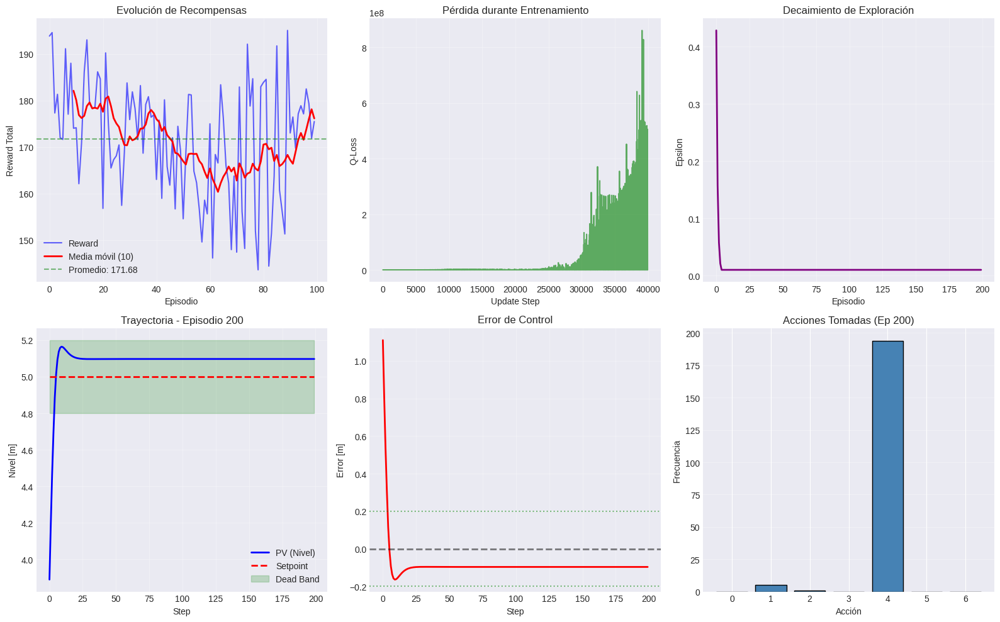


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       111
  Tasa de éxito:            55.50%
  Reward promedio (global): 171.68
  Error estado estacionario: 0.4733

  Últimos 10 episodios:
    Reward promedio:        176.12
    Desviación estándar:    3.59

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_fallen-sweep-16.pth

✅ Run completado: fallen-sweep-16
   Reward promedio: 171.68
   Tasa de éxito: 55.50%


avg_episode_reward,█▆▅▅▅▃▃▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▃▄▄▃▂▂▂▂▂▁▁▁▁
episode,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇█
episode_reward,█▆▅▅▇▆▃▃▃▃▇▅▃▄▅██▁█▆▆▄▆▅▃▅▆▄▆▄▆▄▅▃▄▂▃▆▁▆
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▅▄▆▅▅█
steady_state_error,▁▁▂▂▂█▂▅▅▇▂▁▇▂▁▁▅▁▆▆▁▁▁▁▂▁▂▂▁▁▁▁▁▁▂▆▇▇▆▇
success_rate,███▅▅▄▄▃▂▂▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: zgxoa5u7 with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  184.90 | Avg:  184.90 | ε: 0.844 | Succes

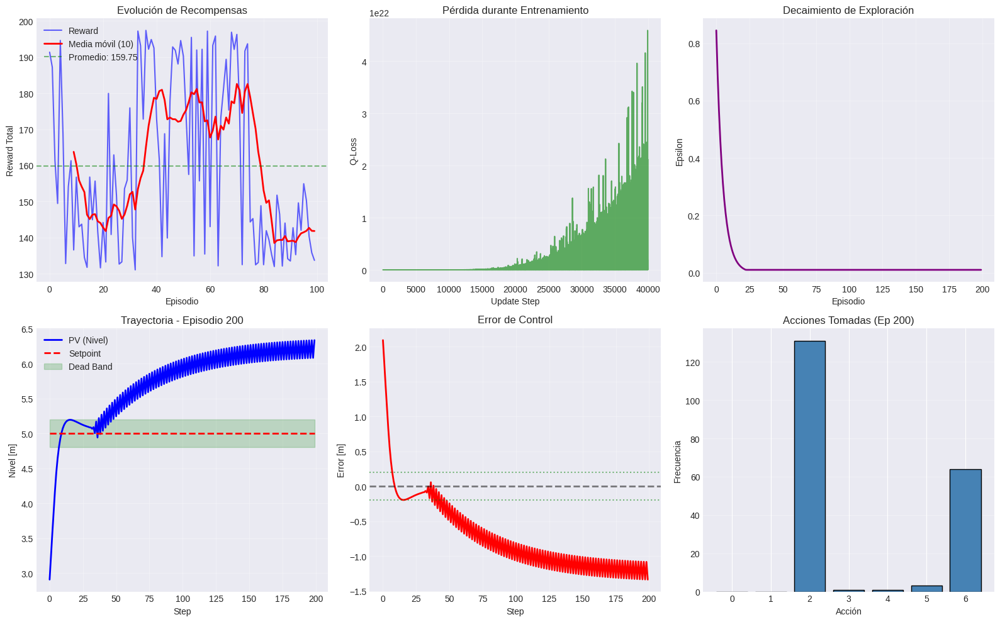


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       46
  Tasa de éxito:            23.00%
  Reward promedio (global): 159.75
  Error estado estacionario: 0.8423

  Últimos 10 episodios:
    Reward promedio:        141.83
    Desviación estándar:    7.21

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_wild-sweep-17.pth

✅ Run completado: wild-sweep-17
   Reward promedio: 159.75
   Tasa de éxito: 23.00%


avg_episode_reward,██▇▇▇▆▆▄▄▃▃▃▃▃▃▃▃▃▃▃▂▂▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▂▂
episode,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇█
episode_reward,▇▇▆▆▆▅▃▁▄▁▂▅▃█▁▁▂▄▄▃▂▆▂▃▁█▇██▄▇▁▅▆█▂▃▁▂▁
epsilon,█▅▃▃▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▃▃▄▃▆▅█
steady_state_error,▁▁▁▁▂▃▇█▇▇████▇▆▆▆▁▃█▇▄▇▇▇▇▇▁▇▇▁▂▁▇▁▁▁█▇
success_rate,█▇▆▅▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: cpsbxg6y with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [32, 32]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (32, 32)
   Learning rate: 0.001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  187.80 | Avg:  187.80 | ε: 0.694 | Succe

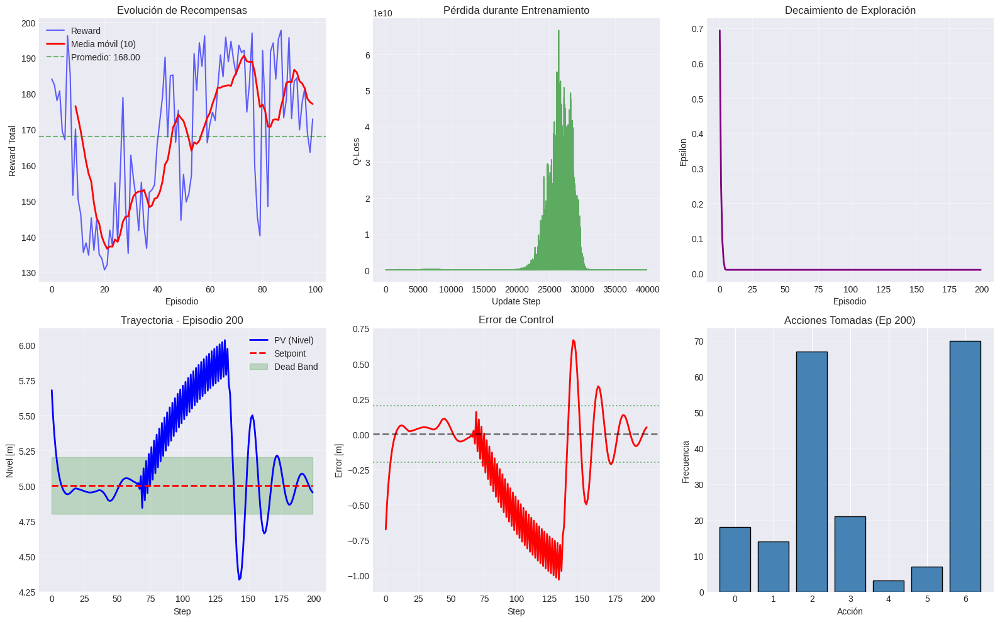


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       83
  Tasa de éxito:            41.50%
  Reward promedio (global): 168.00
  Error estado estacionario: 0.5341

  Últimos 10 episodios:
    Reward promedio:        177.08
    Desviación estándar:    8.90

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_crisp-sweep-18.pth

✅ Run completado: crisp-sweep-18
   Reward promedio: 168.00
   Tasa de éxito: 41.50%


avg_episode_reward,█▆▃▃▂▂▂▁▁▁▂▂▂▃▃▂▂▃▃▃▃▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄
episode,▁▁▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇████
episode_reward,▃▂▆▆▂▃▁▁▁▅▇▅▄▃▅▆▂▄▄▂▆▆▁▆▂▁▁▃▃▅█▅▇▅▂▃██▆▆
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▄▅▆▅█▇█▁▁▁▁▁▁▁▁▁▁
steady_state_error,▄▇▂▂▁██▇▇▂▇▁▅▇▂▁▂▇█▇██▇████▄▂▂▂▂▁▁▁▁▁▅▃▁
success_rate,█▅▂▂▂▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂
+1,...


wandb: Agent Starting Run: 8lsiwnlb with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.0001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  183.87 | Avg:  183.87 | ε: 0.844 

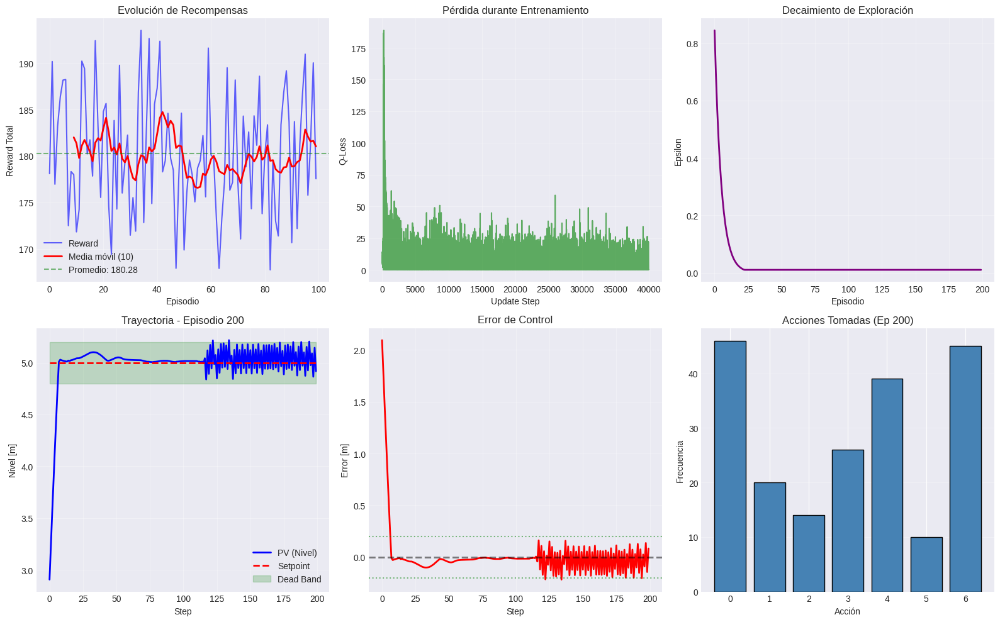


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       161
  Tasa de éxito:            80.50%
  Reward promedio (global): 180.28
  Error estado estacionario: 0.1163

  Últimos 10 episodios:
    Reward promedio:        181.02
    Desviación estándar:    6.67

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_stellar-sweep-19.pth

✅ Run completado: stellar-sweep-19
   Reward promedio: 180.28
   Tasa de éxito: 80.50%


avg_episode_reward,▄█▇▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
episode,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
episode_reward,▅█▅▃▃▆▃▄▅▇▄▅▃▄▇▃▄▄▅▁▅▃▁▂▄▆▄▃▃▃▃▄▃▆▃▆▄▁▁▂
epsilon,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▃▂▃▂▂▃▂▂▃▂▂▂▁▂▂▃▂▃▂▂▂▂▂▂▁▂▃▃▂▃▁▂▂▂▃▂▂▂▂
steady_state_error,▁▁▃▂▁▁█▂▅▃▂▃▅▁▁▂▁▃▁▃▆▆▁▂▁▂▅▁▁▄▄▃▂▃▂▁▁▂▁▁
success_rate,▁▅▇▂▅▃▅▅▆▄▅▆▆▇▇▇▇███████▇▇▇▇█▆▇▇▇▇▇▇▇▇▇▇
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: iyduv0mh with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  182.94 | Avg:  182.94 | ε: 0.930 | Succ

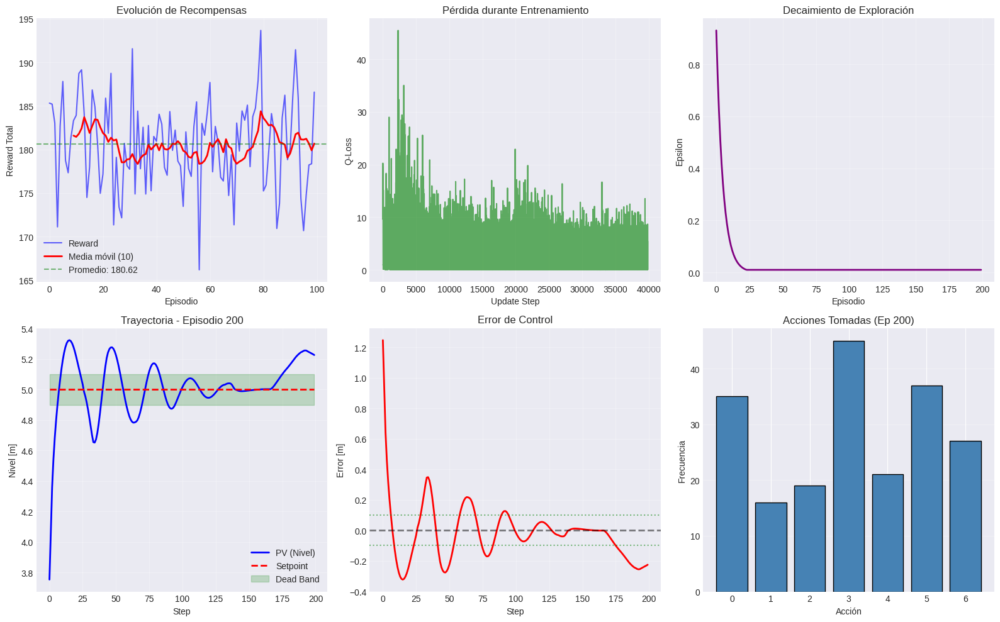


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       123
  Tasa de éxito:            61.50%
  Reward promedio (global): 180.62
  Error estado estacionario: 0.1414

  Últimos 10 episodios:
    Reward promedio:        180.67
    Desviación estándar:    6.28

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_distinctive-sweep-20.pth

✅ Run completado: distinctive-sweep-20
   Reward promedio: 180.62
   Tasa de éxito: 61.50%


avg_episode_reward,█▆▄▄▃▃▂▂▂▂▃▃▃▃▃▄▅▅▅▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▁▁
episode,▁▁▁▁▁▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇████
episode_reward,▄▄▅▃▃▄▂▃▂▅▃▃▅▆▆▁█▆▂▃▅▆▄▆▅▅▄▄▇▄▂▄▅▆▂▅▅▇▂▃
epsilon,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,██▇▅▆▅▄▄▄▅▄▅▃▄▃▃▃▂▃▃▃▃▃▅▂▃▃▅▂▃▁▁▂▃▂▁▂▁▂▁
steady_state_error,▂▁▁▃█▁▁▁▅▃▃▁▂▂▁▃▂▁▁▁▃▁▁▃▂▂▁▇▁▁▅▄▆█▂▃▁▃▃▃
success_rate,██▁▁▂▂▁▁▂▂▂▂▃▃▃▄▃▃▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
+1,...


wandb: Agent Starting Run: hvchgfni with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  184.10 | Avg:  184.10 | ε: 0.183 | Succes

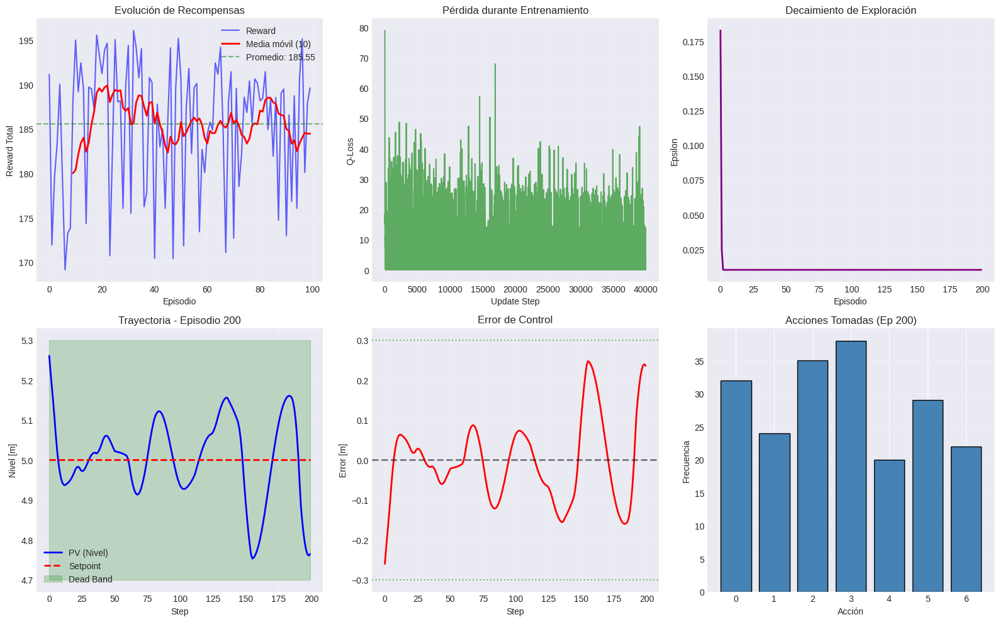


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       181
  Tasa de éxito:            90.50%
  Reward promedio (global): 185.55
  Error estado estacionario: 0.1034

  Últimos 10 episodios:
    Reward promedio:        184.46
    Desviación estándar:    7.02

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_copper-sweep-21.pth

✅ Run completado: copper-sweep-21
   Reward promedio: 185.55
   Tasa de éxito: 90.50%


avg_episode_reward,▃▅▂▁▁▁▂▄▄▃▆▆▅▅▅▅▅▅▅▅▆▆▆▇▇███▇▇▆▆▆▆▆▇▇▇▇▇
episode,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▇▇▇▇▇██
episode_reward,▃▅▄▄▁▇▆▆▆▃█▆▃▃█▄█▆█▇█▄▇▂▆█▃▇▃▇▇▂▇▂▆▆▆▂▆▆
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▄█▃▄▂▁▄▃▇▆▄█▇▄▆▄▅▃▃█▅▆▆▅▃▃█▃▆▂▄▄▄▃▂▅▆▂▇▇
steady_state_error,▄▂▁▃▁▂▁▅█▁▃▁▁▁▁▁▃▂▂▁▁▃▁▁▃▁▂▁▁▁▂▁▁▂▁▃▄▂▁▂
success_rate,▁▂▅▄▅▅▅▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇██████████████
+1,...


wandb: Agent Starting Run: fjx2lnum with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  182.94 | Avg:  182.94 | ε: 0.930 | Succ

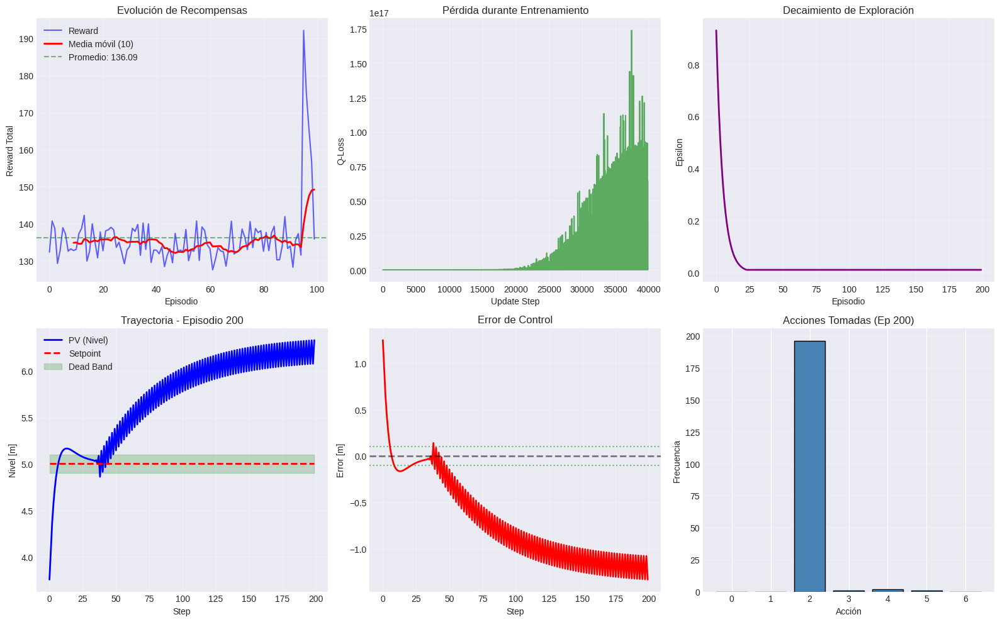


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       56
  Tasa de éxito:            28.00%
  Reward promedio (global): 136.09
  Error estado estacionario: 1.1523

  Últimos 10 episodios:
    Reward promedio:        149.18
    Desviación estándar:    20.83

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_dauntless-sweep-22.pth

✅ Run completado: dauntless-sweep-22
   Reward promedio: 136.09
   Tasa de éxito: 28.00%


avg_episode_reward,██▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▁▁▁
episode,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████
episode_reward,▇▆▇▆▅█▇▄▄▆▄▆▅▆▆▂▁▁▁▂▂▂▂▂▂▁▂▂▂▂▁▁▂▁▂▂▂▁█▂
epsilon,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▄▄▆▅▅▆▆▇▇█
steady_state_error,▃▃▅▅▁▂▄█▁▁▂▁▂▂▂▂▅▂▂▂▂▂▁▂▂██▇███▇▇▇█▇▇██▇
success_rate,█▅▄▂▂▁▃▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂
+1,...


wandb: Agent Starting Run: 4i4mo9kp with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.37 | Avg:  189.37 | ε: 0.930 | Succe

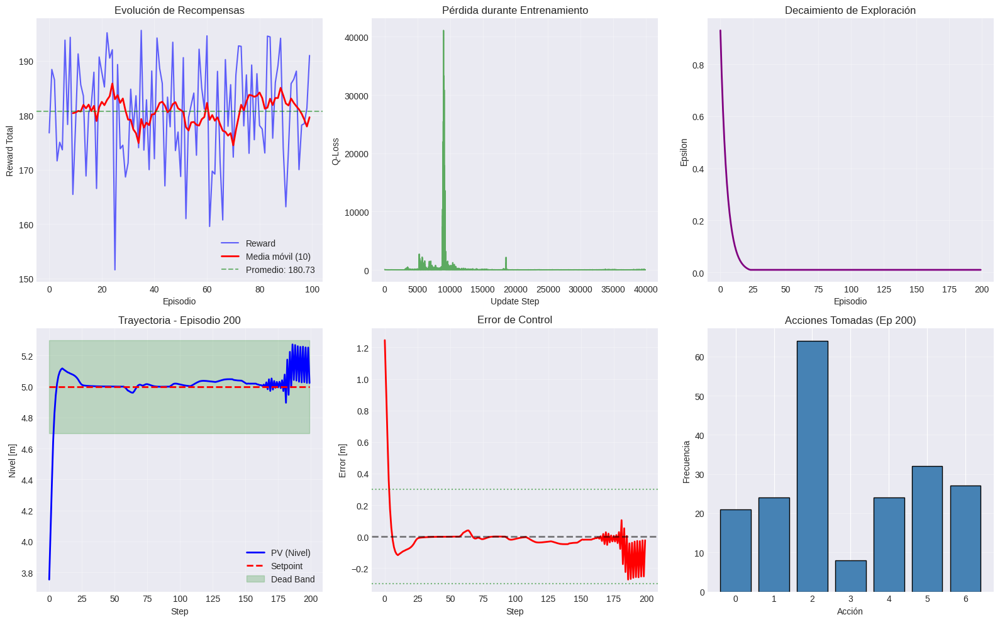


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       151
  Tasa de éxito:            75.50%
  Reward promedio (global): 180.73
  Error estado estacionario: 0.2036

  Últimos 10 episodios:
    Reward promedio:        179.62
    Desviación estándar:    8.32

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_peachy-sweep-23.pth

✅ Run completado: peachy-sweep-23
   Reward promedio: 180.73
   Tasa de éxito: 75.50%


avg_episode_reward,█▇▇▇▄▃▃▃▁▁▂▁▁▂▂▂▂▂▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
episode,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇█████
episode_reward,▇█▇▄▇▃▆▆▄▂▄▃▅▄▇▆▅▄▅▇▂▇▇▄▅▅▄█▁▇▅▆▆▂▇▅▇▅█▄
epsilon,█▇▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▄▅█▃▅▇▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▁▁▇▂▃▃▅▂█▂▁▁▁▁▁▁▃▂▇▆▁▄▂▁▁▁▁█▁▁▂▂▁▂▁▂▂▁▁
success_rate,███▄▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▄
+1,...


wandb: Agent Starting Run: 7cblp8nb with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.51 | Avg:  189.51 | ε: 0.252 | Success

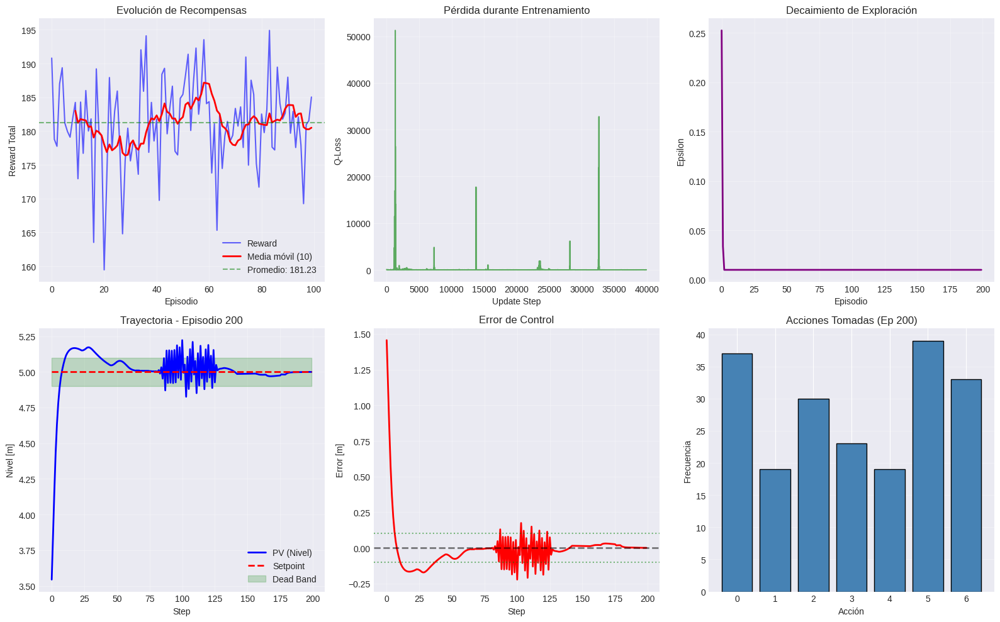


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       112
  Tasa de éxito:            56.00%
  Reward promedio (global): 181.23
  Error estado estacionario: 0.1551

  Últimos 10 episodios:
    Reward promedio:        180.50
    Desviación estándar:    4.78

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_honest-sweep-24.pth

✅ Run completado: honest-sweep-24
   Reward promedio: 181.23
   Tasa de éxito: 56.00%


avg_episode_reward,█▁▃▃▃▆▆▆▆▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄
episode,▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇████
episode_reward,▇▆▇▆▆▇▇▆▄▃▆█▅▆▆▆▅▆▅▄▄▅▄▇▆▆▁▄▅▆▄▆█▇▆▅█▆▄▅
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▂▂▇▄▃▃▃▃█▃▂▂▃▂▁▄▃▂▃▂▄▂▃▄▁▄▂▂▃▂▁▂▂▁▁▁▁▃▂▂
steady_state_error,▆▃▄▁▁▁▂▁▂▁▄▃▃▁▇▂▃█▂▂▂▁▇▂▄▂▆▃▄▃▃▄▃▃▁▁▁▂▁▁
success_rate,▁▄▇███▇▇▇▇▇▇▇▇▆▆▆▆▆▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▇
+1,...


wandb: Agent Starting Run: cz0rv0el with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.77 | Avg:  186.77 | ε: 0.694 | Succes

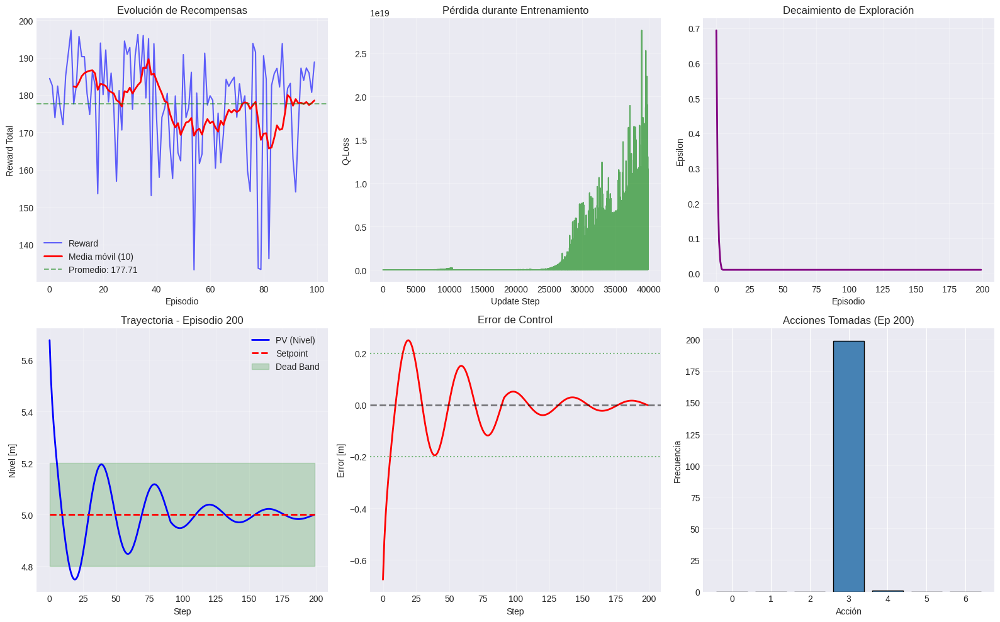


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       165
  Tasa de éxito:            82.50%
  Reward promedio (global): 177.71
  Error estado estacionario: 0.2525

  Últimos 10 episodios:
    Reward promedio:        178.53
    Desviación estándar:    11.19

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_ruby-sweep-25.pth

✅ Run completado: ruby-sweep-25
   Reward promedio: 177.71
   Tasa de éxito: 82.50%


avg_episode_reward,█▇▇▅▅▅▅▆▆▆▆▆▅▅▅▄▄▄▄▄▄▅▅▅▄▃▃▂▃▂▂▂▂▂▁▁▁▁▁▁
episode,▁▁▁▁▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇████
episode_reward,▅▃▃▇█▆▇▅▆▇▄█▆▅▆▇▅▇▆▆▅▆▄▅▇▇▅▆▁▄▆▂▆▆▆▁▇▆▆▆
epsilon,█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▃▃▃▄▄▄▄▃▄▃▄█
steady_state_error,▂▁▁▁▂▇▁▁▁▁▁▂▁▁▁▁▁▅▁▂▂▂▂▂▂▂▁▇▁▇▁▁▁▁▁▂▁▁█▁
success_rate,███▄▃▁▃▃▃▃▄▄▄▅▅▅▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▁▁▂▁▁▁
+1,...


wandb: Agent Starting Run: n0eu14xt with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.0001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  187.87 | Avg:  187.87 | ε: 0.872 | Succ

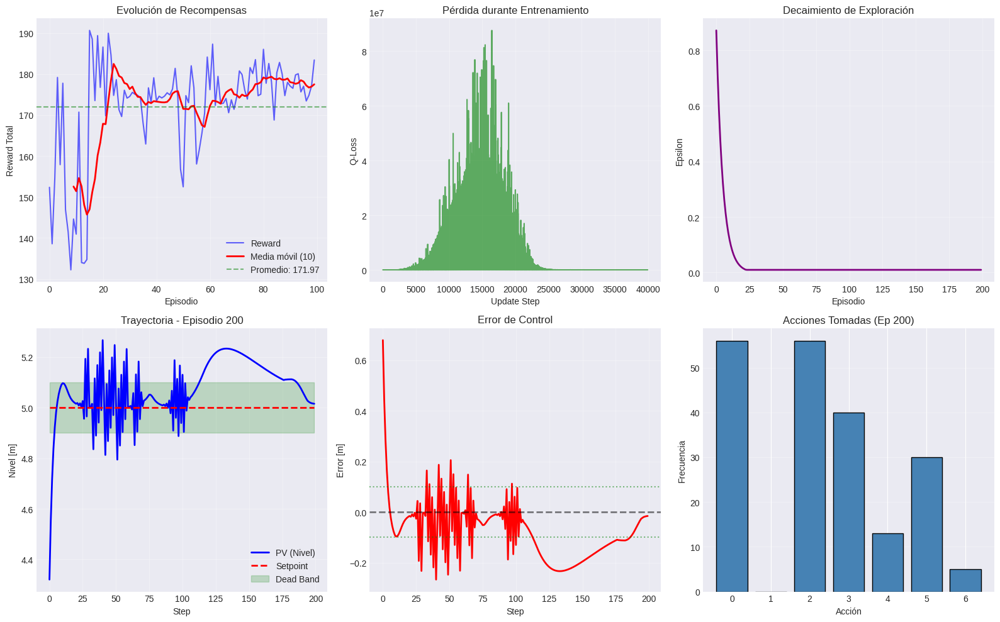


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       73
  Tasa de éxito:            36.50%
  Reward promedio (global): 171.97
  Error estado estacionario: 0.2998

  Últimos 10 episodios:
    Reward promedio:        177.49
    Desviación estándar:    2.75

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_sleek-sweep-26.pth

✅ Run completado: sleek-sweep-26
   Reward promedio: 171.97
   Tasa de éxito: 36.50%


avg_episode_reward,▇███▇▂▂▂▃▄▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▃▃▃▄▄
episode,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▇▇▇▇▇█████
episode_reward,▇▇▃▂▇▆█▁▄▃▃▄▄▇▄▆▃▃▄▄▁██▇▆▆▆▅▅▆▇▆▆▆▆▇▆▆▆▆
epsilon,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▂▃▃▂▆▅▆█▇▆▅▅▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▂█▇▁▁▁▄▁▆▆▇▃▆▆▃▇▄▇▅▁▂▇▁▇▁▁▂▁▁▂▂▆▂▂▁▃▁▁▂
success_rate,██▆▃▃▄▅▅▅▄▄▃▃▂▂▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▃▂▂▂
+1,...


wandb: Agent Starting Run: 70ebh70w with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  190.78 | Avg:  190.78 | ε: 0.694 | Succes

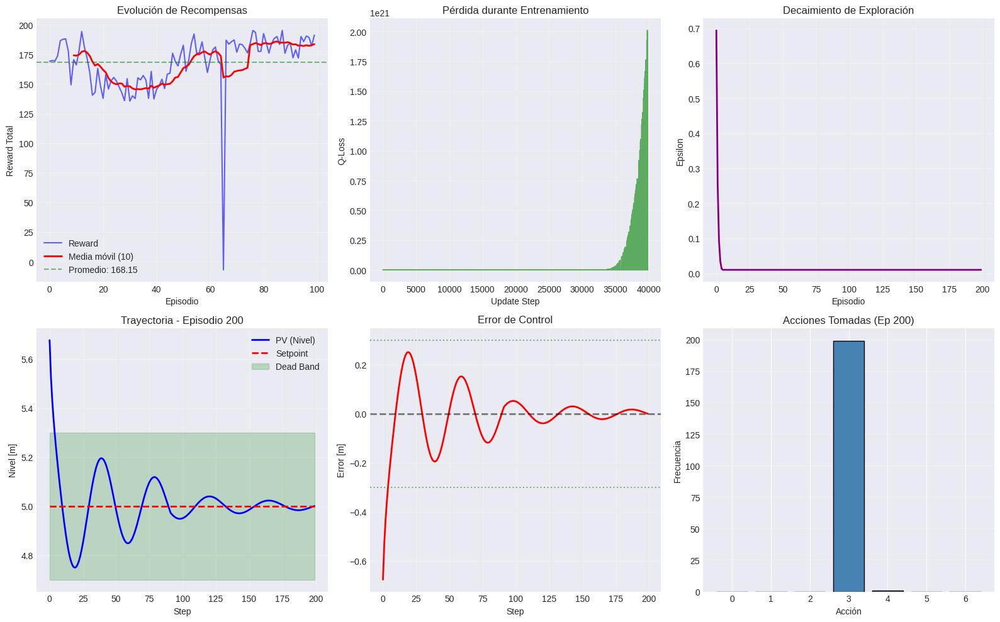


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       117
  Tasa de éxito:            58.50%
  Reward promedio (global): 168.15
  Error estado estacionario: 0.5564

  Últimos 10 episodios:
    Reward promedio:        183.61
    Desviación estándar:    6.92

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_resilient-sweep-27.pth

✅ Run completado: resilient-sweep-27
   Reward promedio: 168.15
   Tasa de éxito: 58.50%


avg_episode_reward,█▇▆▆▆▆▆▆▆▆▆▅▅▄▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▁▁▁▂▂▂▂▂▁▂
episode,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇████
episode_reward,▇▇█▇▇▅█▇▇▅▄▁▁▃██▇▇▅▄▅▇▇▅▆▁▃▂▃▂▁▂▄▅▅▆▆█▇▇
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▃▅▄▇█
steady_state_error,▂▁▂▂▁▂█▆▇▂█▇▇▂▆▁▁▁▁▁▁▃▃▁▁▇█▇█▆▁▂▁▄▁▁▁▂▂▁
success_rate,█████▇▆▆▆▇▄▃▃▃▂▃▂▃▂▃▃▃▃▃▃▃▃▃▂▂▂▂▁▁▁▁▂▂▂▂
+1,...


wandb: Agent Starting Run: etex2f8h with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [32, 32]
wandb: 	lr: 0.0001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (32, 32)
   Learning rate: 0.0001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  182.84 | Avg:  182.84 | ε: 0.183 | Succe

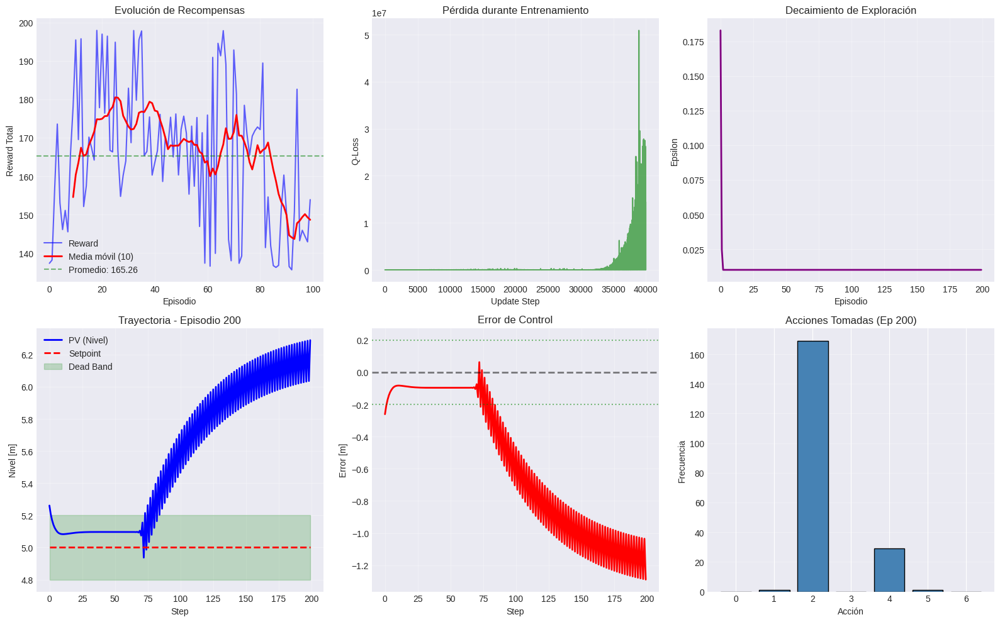


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       103
  Tasa de éxito:            51.50%
  Reward promedio (global): 165.26
  Error estado estacionario: 0.6053

  Últimos 10 episodios:
    Reward promedio:        148.62
    Desviación estándar:    12.65

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_sandy-sweep-28.pth

✅ Run completado: sandy-sweep-28
   Reward promedio: 165.26
   Tasa de éxito: 51.50%


avg_episode_reward,████▇▇▆▅▅▅▄▄▃▃▃▃▃▃▂▂▂▁▂▁▁▂▂▁▂▂▂▂▂▂▂▂▁▁▁▁
episode,▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
episode_reward,▇█▇▇▇▇█▇▇▆▆▆▆▁▆▆▄▃▅▄▅▅▆▅▆▆█▅▅▆▅▅▇██▄▄▅▄▄
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▃▃▄█
steady_state_error,▁▁▁▁▁▁▂▂▁▁▁█▁▁▂▁▄▁▁▄▄▄▄▃▄▂▃▁▁▂▁▃▁▄▄▃▄▃▄▁
success_rate,█████▅▅▅▄▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁
+1,...


wandb: Agent Starting Run: q5btrwgo with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.74 | Avg:  186.74 | ε: 0.872 | 

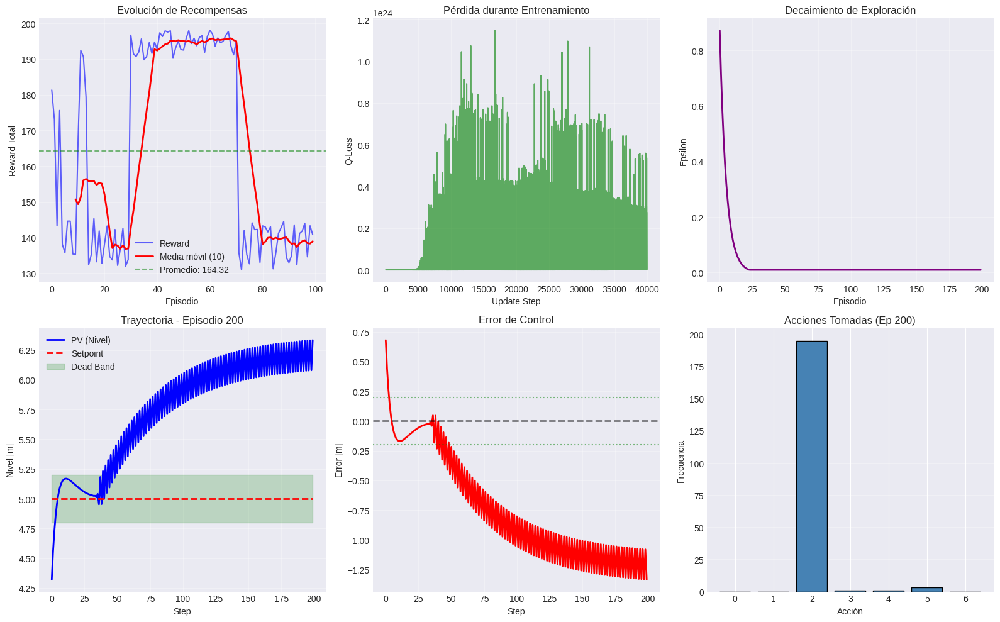


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       107
  Tasa de éxito:            53.50%
  Reward promedio (global): 164.32
  Error estado estacionario: 0.6287

  Últimos 10 episodios:
    Reward promedio:        138.92
    Desviación estándar:    4.42

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_autumn-sweep-29.pth

✅ Run completado: autumn-sweep-29
   Reward promedio: 164.32
   Tasa de éxito: 53.50%


avg_episode_reward,█▇██▇▇▆▅▅▄▄▂▂▂▂▁▂▂▃▃▃▃▃▃▂▂▂▂▁▁▃▃▄▅▅▅▄▃▃▂
episode,▁▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇█
episode_reward,▇▇▇▆▅▅▆▁▂▇█▆▇▆██▆▆▂▂▂▁▂▂▇▇███████▁▁▂▂▂▁▁
epsilon,█▆▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▂▂▂▃▄▅▅▅▇▇▅▇▄▄▄▂▃▂▂▃▅▆▄▅▅█▆▅▄▂▃▂▁▄▅
steady_state_error,▂▁▂▁▅▆▂▇▇█▁▂▂▁▁▁▅▁█▇█▇███▁▁▁▁▁▁▁▁▁▁▇▇▇▇▆
success_rate,█▅▄▄▃▃▁▂▂▂▁▂▂▂▂▃▃▃▃▃▄▄▅▄▄▄▃▃▄▄▄▄▄▄▄▄▄▄▄▃
+1,...


wandb: Agent Starting Run: dhtmitsq with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  183.26 | Avg:  183.26 | ε: 0.503 | 

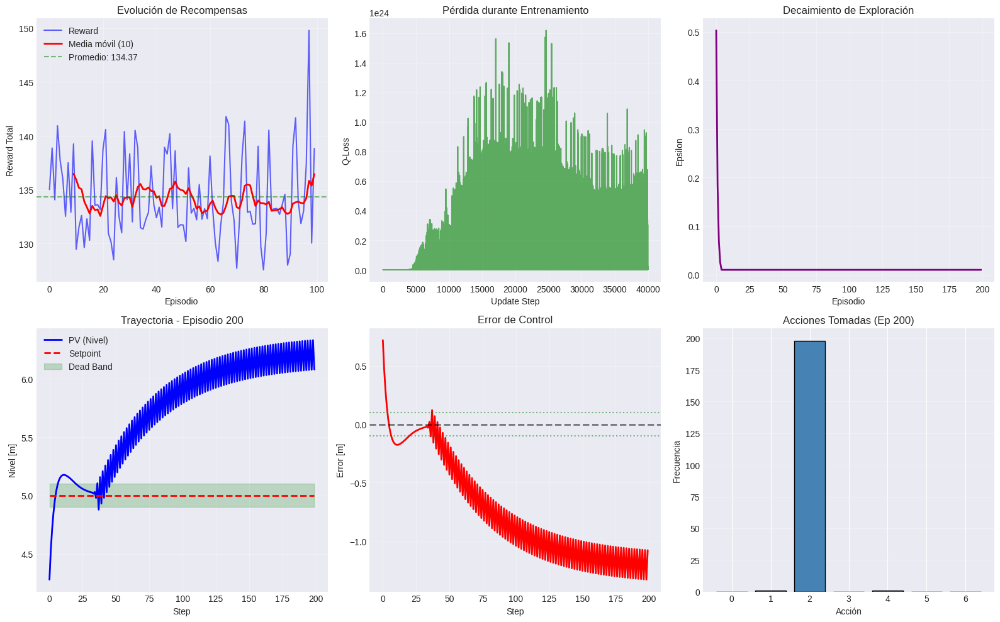


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       16
  Tasa de éxito:            8.00%
  Reward promedio (global): 134.37
  Error estado estacionario: 1.1736

  Últimos 10 episodios:
    Reward promedio:        136.47
    Desviación estándar:    5.94

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_sweepy-sweep-30.pth

✅ Run completado: sweepy-sweep-30
   Reward promedio: 134.37
   Tasa de éxito: 8.00%


avg_episode_reward,███▇▇▇▇▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
episode,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▇▇▇▇▇████
episode_reward,▆▇▅▃█▅▂▁▁▄▁▂▂▁▁▁▁▂▁▂▂▁▂▁▂▁▁▁▁▁▂▁▁▁▂▁▁▁▁▁
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▂▂▂▃▃▄▅▅▅█▆▇▆▆▆█▆▆▅▆▄▅▅▅▅▅▅▄▆▆
steady_state_error,▅▅▅▄▆▂▆█▆▆█▆▄██████▆▆▆▁▆█▆▆██▆█▆█▆█▆▆██▆
success_rate,█▃▃▂▂▂▃▃▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: bwtj31yx with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  176.98 | Avg:  176.98 | ε: 0.503 |

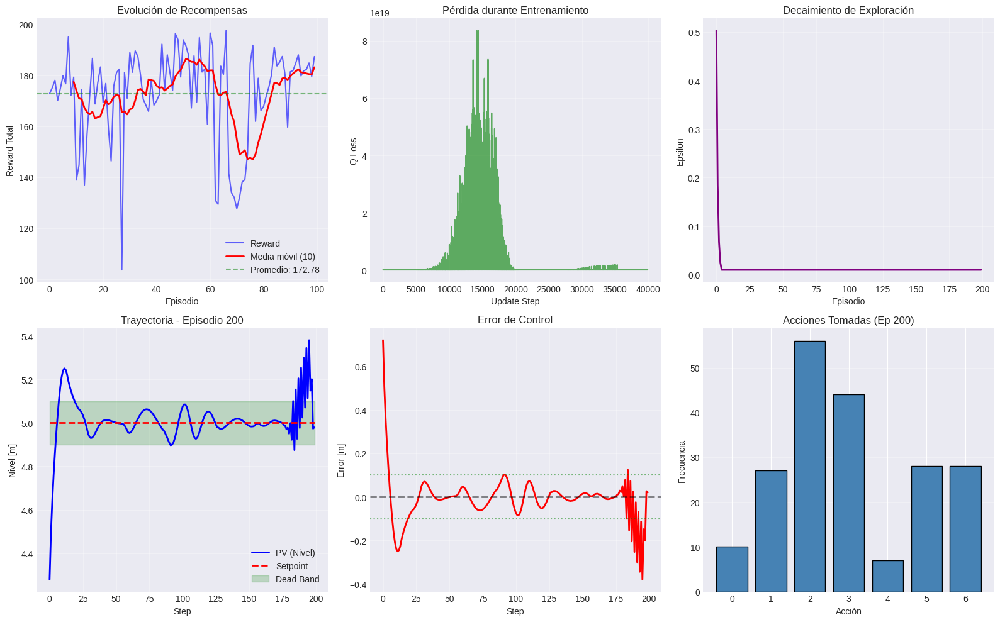


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       74
  Tasa de éxito:            37.00%
  Reward promedio (global): 172.78
  Error estado estacionario: 0.2794

  Últimos 10 episodios:
    Reward promedio:        183.14
    Desviación estándar:    2.80

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_prime-sweep-31.pth

✅ Run completado: prime-sweep-31
   Reward promedio: 172.78
   Tasa de éxito: 37.00%


avg_episode_reward,█▆▄▃▃▃▃▃▃▃▃▂▂▁▁▁▁▁▂▂▂▃▃▃▃▃▃▄▃▄▄▄▅▆▆▇▇▇▇▇
episode,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇█
episode_reward,▆▇▆▂▂▃▃▄▂▂▁▂▃▂▁▇▃▅▅█▆▆▅▃▂▆▇▆▅▅███▅▅▂▄▆▇▆
epsilon,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▂▂▇█▇▅▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁█▇█▇▇█▄▄█▇▆▆▇█▆▆█▇▁▂▂▁█▂▂▁▃▁▂▁▁▇▁▁▂▁▁▂▂
success_rate,▇▅▂▃▂▂▂▂▂▂▁▁▁▁▁▁▁▂▂▂▃▃▃▄▄▄▄▄▅▅▆▆▆▆▇▇▇▇▇█
+1,...


wandb: Agent Starting Run: kdpidooz with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  187.18 | Avg:  187.18 | ε: 0.480 | Succes

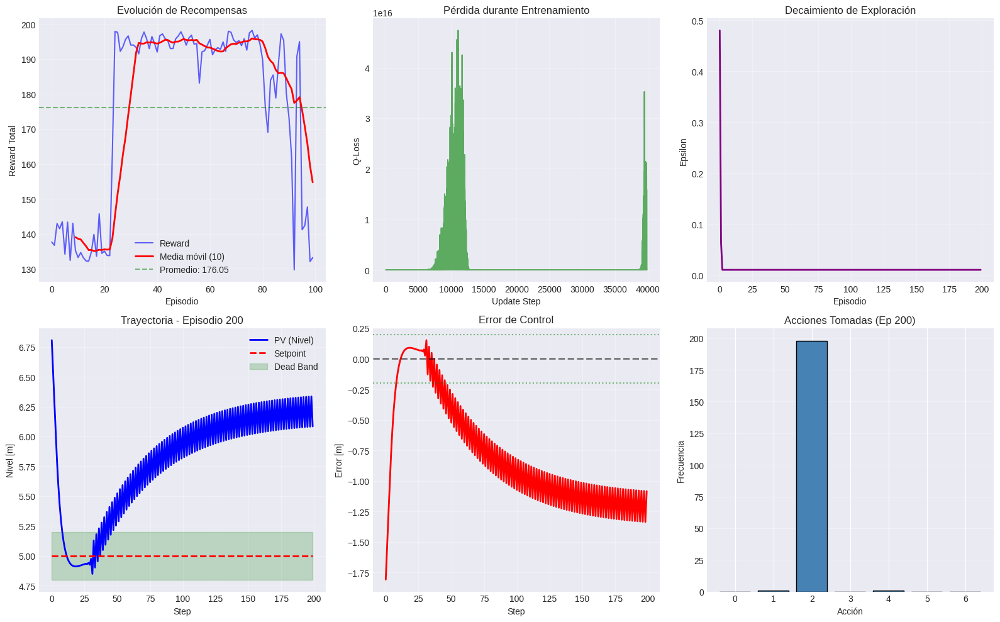


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       110
  Tasa de éxito:            55.00%
  Reward promedio (global): 176.05
  Error estado estacionario: 0.3405

  Últimos 10 episodios:
    Reward promedio:        154.72
    Desviación estándar:    23.02

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_drawn-sweep-32.pth

✅ Run completado: drawn-sweep-32
   Reward promedio: 176.05
   Tasa de éxito: 55.00%


avg_episode_reward,█▇▇▇▇▇▇▇▇▆▅▄▄▄▄▄▅▄▃▃▂▂▂▁▁▂▂▃▃▃▄▄▄▅▅▅▆▆▆▆
episode,▁▁▁▁▁▂▂▂▃▃▃▃▃▃▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇████
episode_reward,▇▆▇▇▇█▆▅▆▃▅▄▅▇█▆█▂▁▁▁▁▂▂▂▁▁██████▇██▇▇█▃
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▂█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▂▄▂▁▁▅▆█▇▆▁▄▃▁██▇▇█▇███▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█
success_rate,███▇▇▆▆▄▃▂▂▂▂▂▂▃▃▂▂▂▂▂▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▃
+1,...


wandb: Agent Starting Run: o4e94w1o with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  188.26 | Avg:  188.26 | ε: 0.480 | S

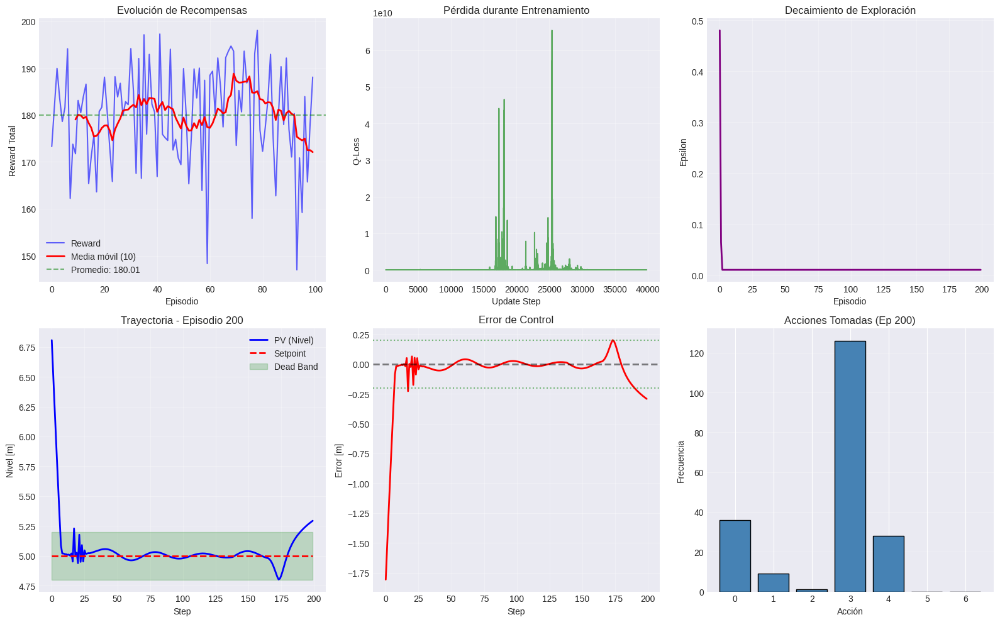


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       145
  Tasa de éxito:            72.50%
  Reward promedio (global): 180.01
  Error estado estacionario: 0.2638

  Últimos 10 episodios:
    Reward promedio:        172.09
    Desviación estándar:    11.66

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_magic-sweep-33.pth

✅ Run completado: magic-sweep-33
   Reward promedio: 180.01
   Tasa de éxito: 72.50%


avg_episode_reward,█▆▇▇▆▆▅▅▅▅▆▅▅▅▅▄▃▄▄▄▃▃▃▃▃▃▃▂▂▂▂▁▁▁▁▂▃▃▃▂
episode,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇███
episode_reward,▆▇█▆▆▅█▆▆▅▇▆▁▇▆▆▇▄▅▃▄▃▆▆▆▆██▇▇▁▇▆▇▆▇▇▇▆▅
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▅▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▂▁▁▁▂▁▁▁▁▁▂▂▁▂▂▁▂▅▂▁▂▁▂▁▁▁▇▄▁▁▁▁▁▄▁█▁▁▂▂
success_rate,██▇▇▇▄▅▄▄▄▅▄▄▄▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▂▂▂▂▂
+1,...


wandb: Agent Starting Run: ukkoayem with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  182.50 | Avg:  182.50 | ε: 0.694

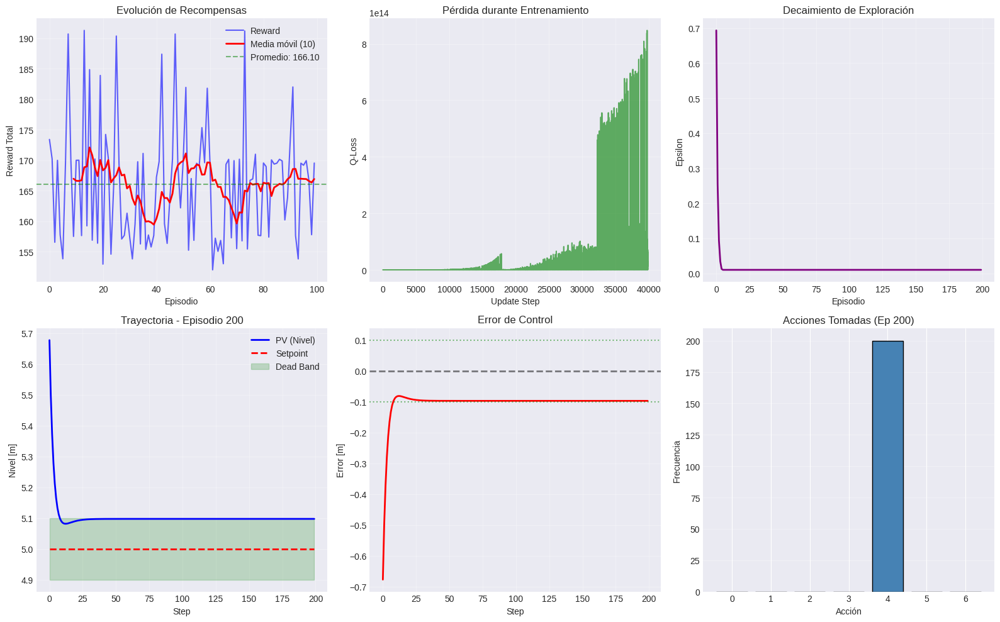


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       154
  Tasa de éxito:            77.00%
  Reward promedio (global): 166.10
  Error estado estacionario: 0.1112

  Últimos 10 episodios:
    Reward promedio:        166.93
    Desviación estándar:    7.96

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_usual-sweep-34.pth

✅ Run completado: usual-sweep-34
   Reward promedio: 166.10
   Tasa de éxito: 77.00%


avg_episode_reward,█▆▃▃▃▅▅▅▆▅▆▆▆▆▆▆▆▆▆▇▆▆▆▆▆▅▄▄▄▄▃▃▂▂▂▂▂▁▁▁
episode,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇██
episode_reward,▅▅█▄▂▇▅▆▁▅█▆▅▆▆▅▆▆▄▁▇▅▄▃█▂▁▄▂▄▄▄▂▁▄▂▁▂▄▂
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▃▄▃▄▄▄▆▅▄▅▇▅█
steady_state_error,▂▂▂█▁▁▂▁▁█▁▁▁▁▁▂▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▃█▂▂▂▂▂
success_rate,▁▄▃▂▃▅▆▆▆▆▆▇▇▇▇████████████▇▇▇▇▇▇▇▇▇▇▇▇▇
+1,...


wandb: Agent Starting Run: dwzk0fl0 with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  192.72 | Avg:  192.72 | ε: 0.872 

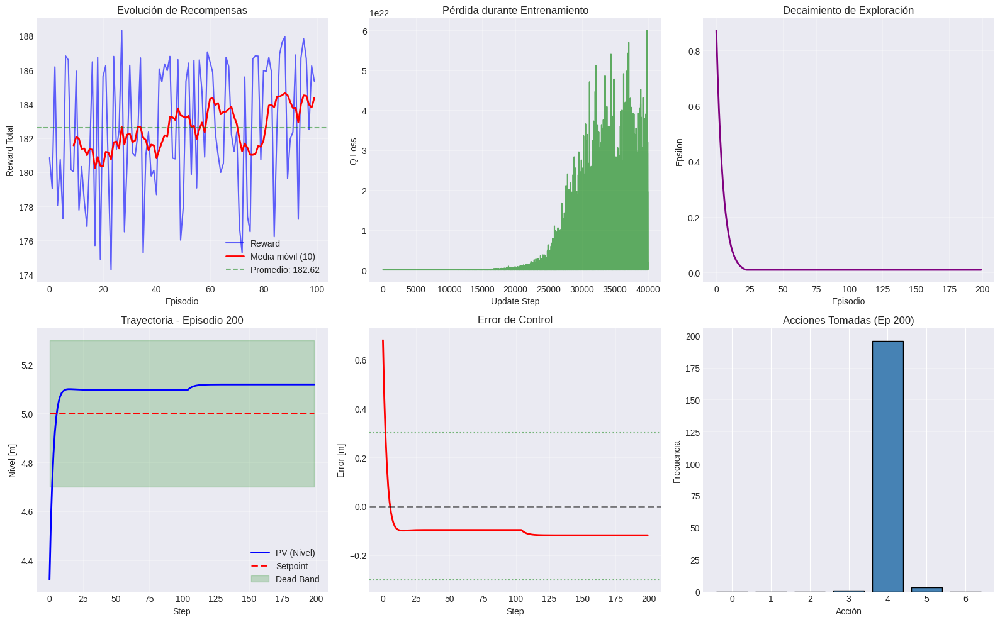


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       200
  Tasa de éxito:            100.00%
  Reward promedio (global): 182.62
  Error estado estacionario: 0.1003

  Últimos 10 episodios:
    Reward promedio:        184.37
    Desviación estándar:    3.12

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_apricot-sweep-35.pth

✅ Run completado: apricot-sweep-35
   Reward promedio: 182.62
   Tasa de éxito: 100.00%


avg_episode_reward,▄██▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▃▂▃▂▂▁▁▂▃▃▃▃▃▂▃▃▃▄
episode,▁▁▁▁▁▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇█████
episode_reward,▇▂▂▆▃▇▂▄▅▂▄▁▇▅▂▇▆▄▂▄▇▂▇▇▁▇▇▄▃▄▅▄▇▅▂▇▂█▅▇
epsilon,█▆▅▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▃▅▄▄▅▆▅▆██
steady_state_error,▇▁█▇▁█▃▃▃▃▄▃▃▃▃▂▃▄▃▃▄▃▃▄▃▃▃▃▃▃▃▄▃▃▄▃▃▃▃▄
success_rate,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: wdihqvv2 with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.0001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  176.98 | Avg:  176.98 | ε: 0.429 

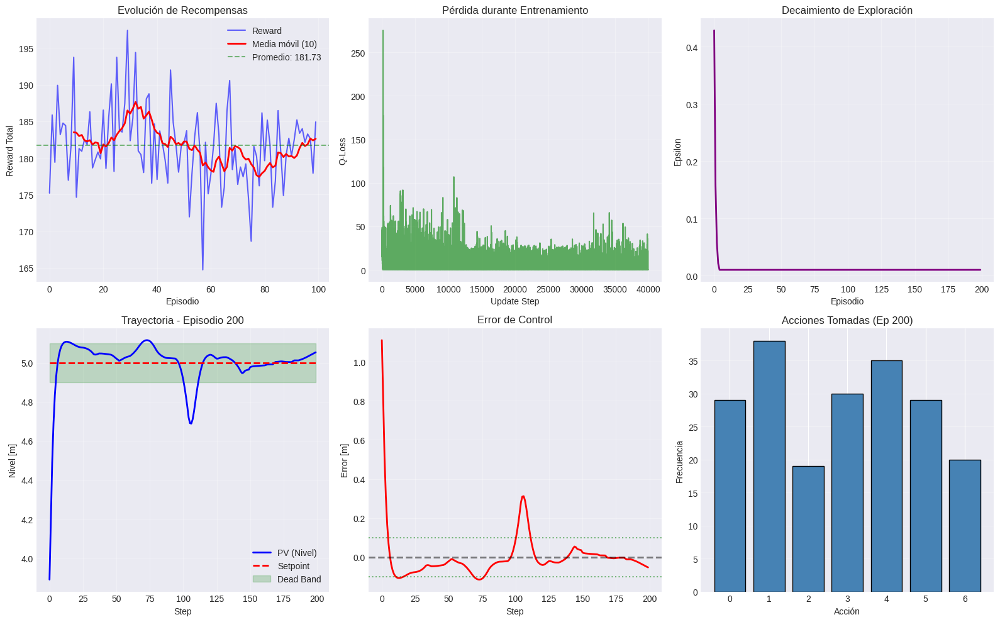


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       95
  Tasa de éxito:            47.50%
  Reward promedio (global): 181.73
  Error estado estacionario: 0.1539

  Últimos 10 episodios:
    Reward promedio:        182.61
    Desviación estándar:    2.06

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_electric-sweep-36.pth

✅ Run completado: electric-sweep-36
   Reward promedio: 181.73
   Tasa de éxito: 47.50%


avg_episode_reward,▃▆▁▂▃▄▄▅▅▅▅▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇█████████████
episode,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇██
episode_reward,▃▂▄▂▄▃▄▂▃▃▃▃▁▃▂▅▄▄▅▁▅▄▄▄▄▃▇▅█▇▂▄▂▄▄▄▃▅▄▄
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▅▅▆▇▃▆▁▂▄▂▁▃▂▃▂▂▃▂▂▃▂▄▃▃▁▁▂▂▄▂▃▃▂▃▃▂▃▃▂
steady_state_error,▅▁█▃▃▁▁▃▁▄▁▁▄▆▂▃▃▄▂▃▂▁▂▁▆▁▄▁▃▂▂▂▆▃▄▃▄▁▁▃
success_rate,▃▃▂▂▁▁▃▂▄▅▅▅▆▅▆▇▇▇▆▆▇▇█████████▇█████▇▇▇
+1,...


wandb: Agent Starting Run: s8kcsy8f with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.73 | Avg:  185.73 | ε: 0.480 | Succ

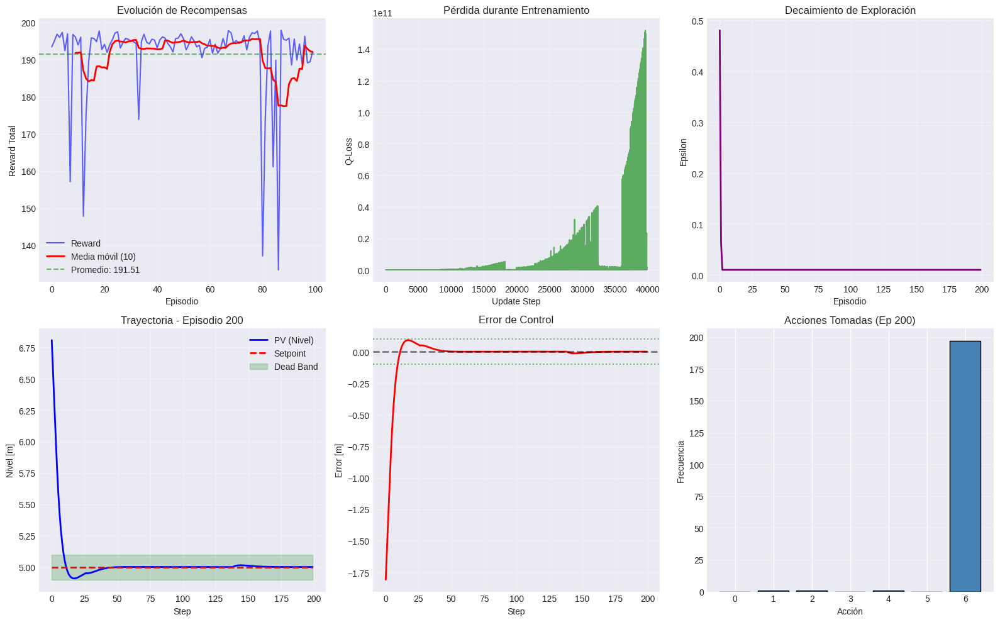


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       185
  Tasa de éxito:            92.50%
  Reward promedio (global): 191.51
  Error estado estacionario: 0.0282

  Últimos 10 episodios:
    Reward promedio:        191.93
    Desviación estándar:    3.03

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_avid-sweep-37.pth

✅ Run completado: avid-sweep-37
   Reward promedio: 191.51
   Tasa de éxito: 92.50%


avg_episode_reward,▆▁▂▃▃▄▄▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇███████████████
episode,▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇██
episode_reward,██▁▇▁█▁███▁█▇████▇████████████▇████▁▄▁▇█
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▁▂▂▂▁▁▁▁▁▃█
steady_state_error,▅▁▁▁▁▁▁▁▇▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
success_rate,█▁▂▁▂▂▂▂▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▆▆▅▅
+1,...


wandb: Agent Starting Run: el0rsgst with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.0001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  183.49 | Avg:  183.49 | ε: 0.503 

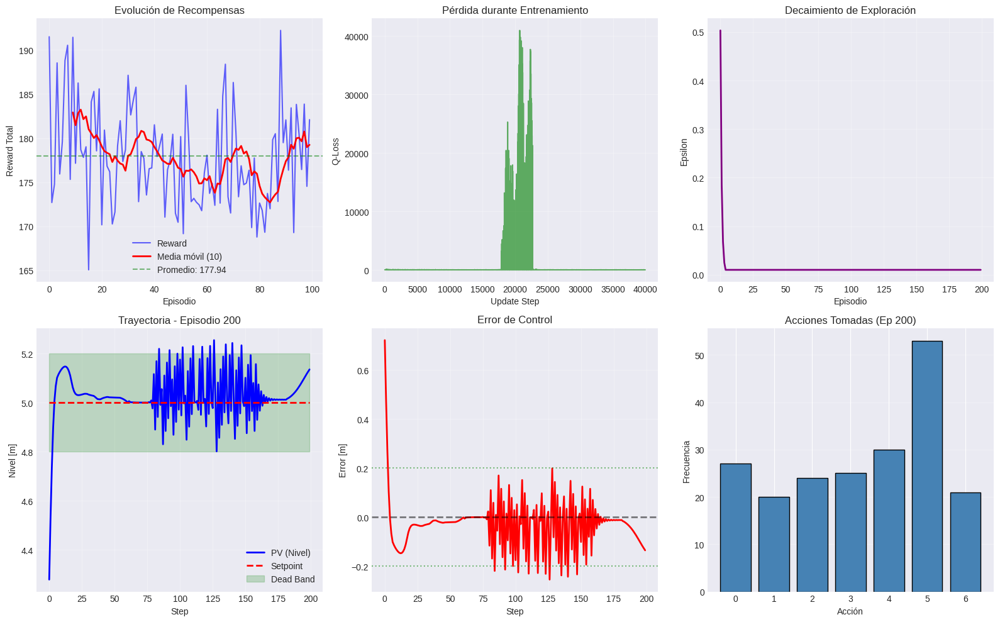


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       166
  Tasa de éxito:            83.00%
  Reward promedio (global): 177.94
  Error estado estacionario: 0.1092

  Últimos 10 episodios:
    Reward promedio:        179.23
    Desviación estándar:    4.64

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_daily-sweep-38.pth

✅ Run completado: daily-sweep-38
   Reward promedio: 177.94
   Tasa de éxito: 83.00%


avg_episode_reward,█▃▅▆▅▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▂▁▂▂
episode,▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇█████
episode_reward,▇▃▅▅▃█▇▄▁▄▇▂▂▃▃▃▆▄▇▃▄▄▆▅▅▆▄▄▄▅▄▃▂▃▇▆▃▂▅▃
epsilon,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▃▄▆▃█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁█▁▂▁▁▂▂▁▁▂▁▁▂▂▂▃▂▂▁▁▃▁▂▁▁▂▁▁▁▃▃▁▂▂▂▂▁▂▁
success_rate,██▃▄▁▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▆▆▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅
+1,...


wandb: Agent Starting Run: snxg1q03 with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  177.42 | Avg:  177.42 | ε: 0.503 |

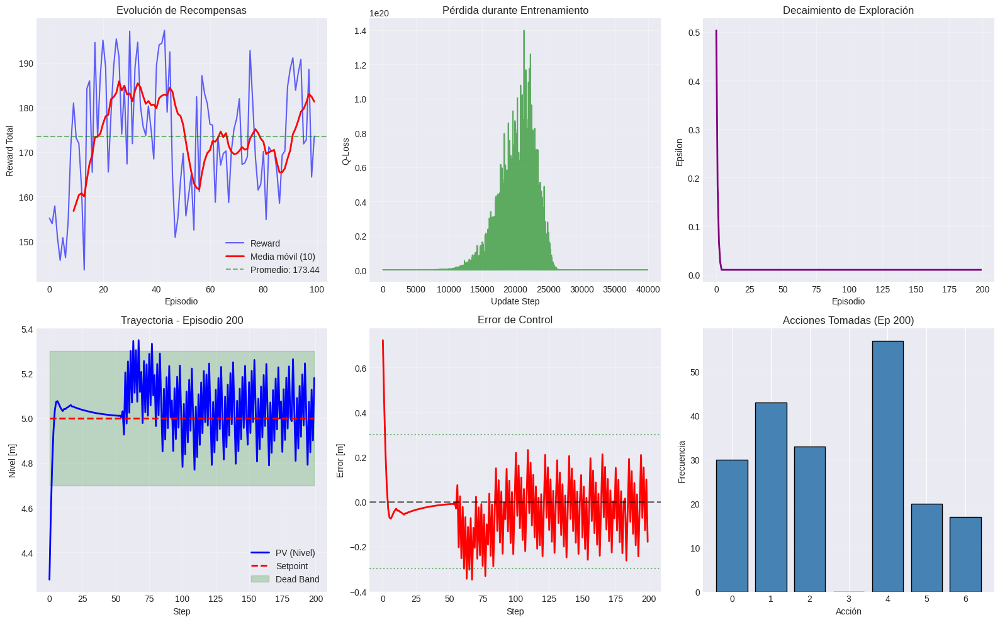


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       70
  Tasa de éxito:            35.00%
  Reward promedio (global): 173.44
  Error estado estacionario: 0.4135

  Últimos 10 episodios:
    Reward promedio:        181.29
    Desviación estándar:    9.22

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_morning-sweep-39.pth

✅ Run completado: morning-sweep-39
   Reward promedio: 173.44
   Tasa de éxito: 35.00%


avg_episode_reward,█▃▃▄▄▄▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▂▂▂▂▃▃▃▄▄▄▄▅▅▅
episode,▁▁▁▁▂▂▂▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇███
episode_reward,▆▅▃▅▄▅▄▃▂▂▄▂▃▃▆▃▄▄▃▂▁▂▃▂▃▆▇▇▇█▆▆█▃▄▆▆▆▅▅
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▄▄▄▅▅█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▆▄▃▂▂▇▇█▇▇▇▆███▇█▆▄▁▁▂▁▁▁▇▇▅▁▅▆▁▁▇▂▃▁▁▁
success_rate,█▇▆▅▄▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄
+1,...


wandb: Agent Starting Run: rq0cmx6z with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.0001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.67 | Avg:  186.67 | ε: 0.844 | Succ

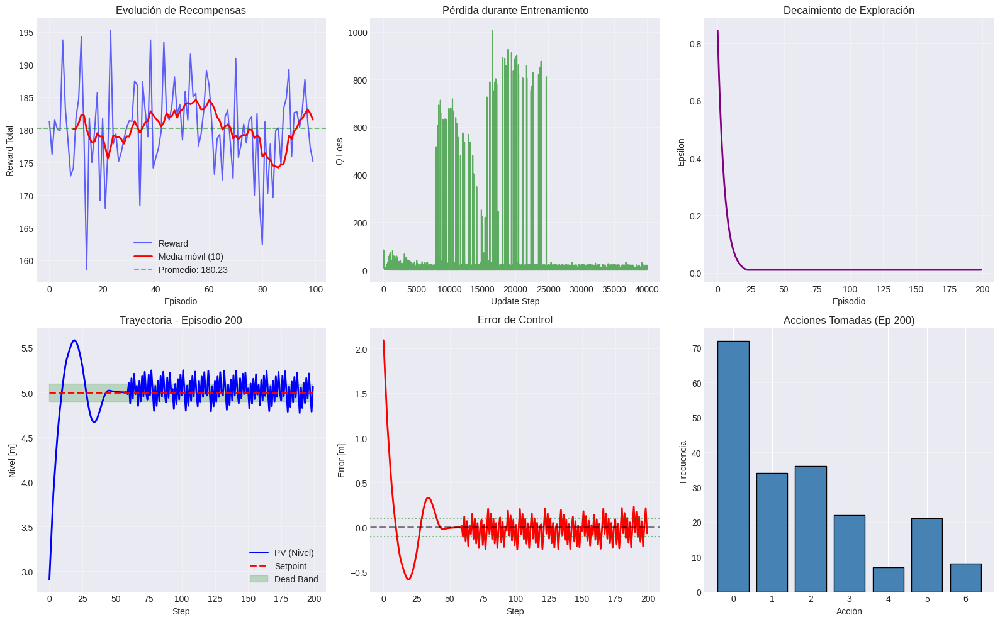


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       102
  Tasa de éxito:            51.00%
  Reward promedio (global): 180.23
  Error estado estacionario: 0.2286

  Últimos 10 episodios:
    Reward promedio:        181.56
    Desviación estándar:    4.41

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_earnest-sweep-40.pth

✅ Run completado: earnest-sweep-40
   Reward promedio: 180.23
   Tasa de éxito: 51.00%


avg_episode_reward,█▇▄▁▁▂▃▃▃▂▁▁▂▂▂▂▂▂▂▁▁▂▁▁▁▂▂▂▂▂▁▁▂▂▂▃▂▃▃▂
episode,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇██
episode_reward,▆▅▃▇▁▆▅▂█▃▁▅▅▆▄▇▆▅▄▄▇▇▆▄▆▃▄▄▅▇▆▇▆▅▄▅▆▅▃▆
epsilon,█▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▃▃▂▂▁▂▃▇▄▄▄▄▁▁▁█▂▂▁▂▂▁▁▁▁▁▂▂▁▁▁▂▁▁▁▂▂▁▁▁
steady_state_error,▁▁▁▁▁▃▁█▁▁▁▁▁▁▁▁▁▂▂▁▁▁▂▁▁▁▂▁▂▁▁▂▁▁▂▂▂▁▃▁
success_rate,▇█▇▇▆▅▅▄▄▂▃▃▃▃▃▃▃▂▂▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁
+1,...


wandb: Agent Starting Run: 1qzn8ddn with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  188.22 | Avg:  188.22 | ε: 0.872 |

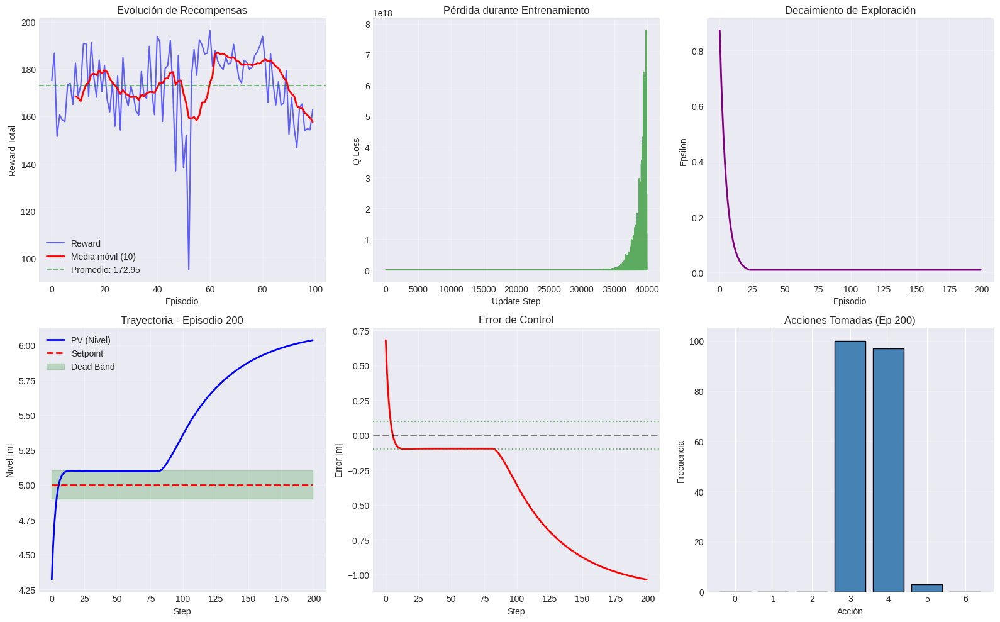


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       74
  Tasa de éxito:            37.00%
  Reward promedio (global): 172.95
  Error estado estacionario: 0.5140

  Últimos 10 episodios:
    Reward promedio:        157.68
    Desviación estándar:    6.44

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_restful-sweep-41.pth

✅ Run completado: restful-sweep-41
   Reward promedio: 172.95
   Tasa de éxito: 37.00%


avg_episode_reward,██▆▆▆▆▅▆▆▆▅▅▄▄▄▄▄▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▂▂▂▂▂▂
episode,▁▁▁▁▁▂▂▂▂▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇███
episode_reward,▇▇▇▇▇▇▇▇▅▅▆▆▇▇▆▇▅▆▆▆▇▆▆▆▆▇▆▆█▅▇▄▁█▇▇▇▇▇▅
epsilon,█▆▄▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▃█
steady_state_error,▁▂▁▁▁▁▁▁▁▃▂▁▁▂▁▁▁▁▂▁▁▂▂▂▂▂▂▂▁▁█▁▁▁▁▂▃▃▂▃
success_rate,▅▁▂▁▆███▆▆▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: cfzz762i with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  176.98 | Avg:  176.98 | ε: 0.503 |

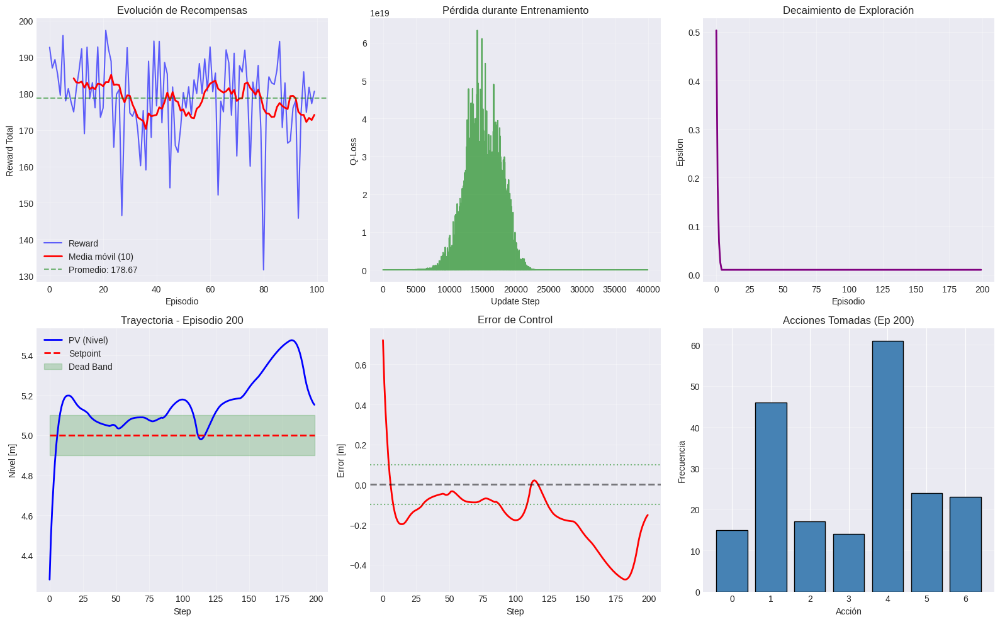


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       63
  Tasa de éxito:            31.50%
  Reward promedio (global): 178.67
  Error estado estacionario: 0.1803

  Últimos 10 episodios:
    Reward promedio:        174.15
    Desviación estándar:    10.60

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_fresh-sweep-42.pth

✅ Run completado: fresh-sweep-42
   Reward promedio: 178.67
   Tasa de éxito: 31.50%


avg_episode_reward,▅▅▃▃▂▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▂▂▂▂▂▃▃▄▄▄▅▆▆▇▇█████
episode,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▆▆▆▇▇▇▇▇█████
episode_reward,▆▆▂▂▅▁▃▄▁▃▁▁▂▃▁▅▄▆▅▇█▅▇▆██▆▇▆▆▇▆▇▆▄▆▇▅▆▆
epsilon,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▂▂▃▄▄█▇█▇▆▆█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁█▇▆▅▆█▇▇██▇▇▅▆▂▃▆▁▂▁▁▁▂▁▃▂▁▁▁▁▂▂▂▂▁▁▂▁▁
success_rate,▁▇▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▃▃▃▄▄▅▅▅▅▅▆▆▆▇▇▇▇▇▇████
+1,...


wandb: Agent Starting Run: zz7kqhyr with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.14 | Avg:  186.14 | ε: 0.930 | Succe

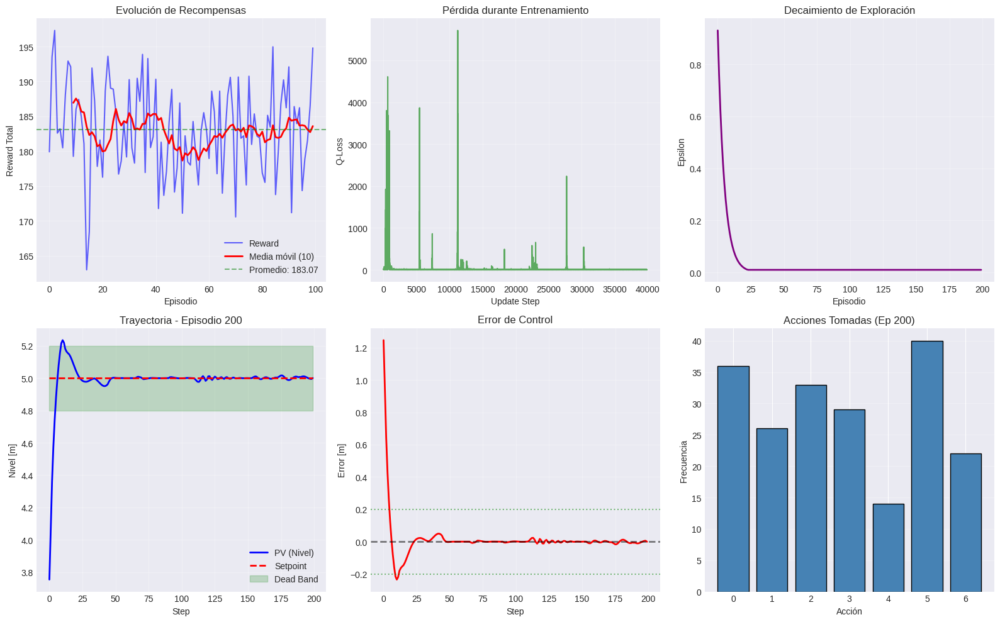


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       158
  Tasa de éxito:            79.00%
  Reward promedio (global): 183.07
  Error estado estacionario: 0.1250

  Últimos 10 episodios:
    Reward promedio:        183.59
    Desviación estándar:    6.99

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_giddy-sweep-43.pth

✅ Run completado: giddy-sweep-43
   Reward promedio: 183.07
   Tasa de éxito: 79.00%


avg_episode_reward,▇▆█▆▆▆▇▆▅▅▄▃▄▄▄▄▅▅▅▄▄▄▄▄▃▃▃▄▃▃▃▃▃▃▂▂▁▁▁▁
episode,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
episode_reward,▅▂▆▆▁▃▅▃▆▅▃▁▄▄▆▅▄▃▄▃█▅▄▂▇▃▇▂▂▃▄▃▆▄▂▄▂▄▂▅
epsilon,█▇▆▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▆▁▆▃▂▂▃▅▂▁▁▁▂▁▇▂▁▁▂▆▇▂▅▁▆▁█▅▄▃▃▂▂▁▃▂▁▁▁
success_rate,▁▆▃▅▅█▇▆▇█▇▇▇█▇▇█▆▇▇▇▇█▇▇▇▇▇▇▇█████▇▇▇▇▇
+1,...


wandb: Agent Starting Run: 6wsmsw79 with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  184.55 | Avg:  184.55 | ε: 0.844 | 

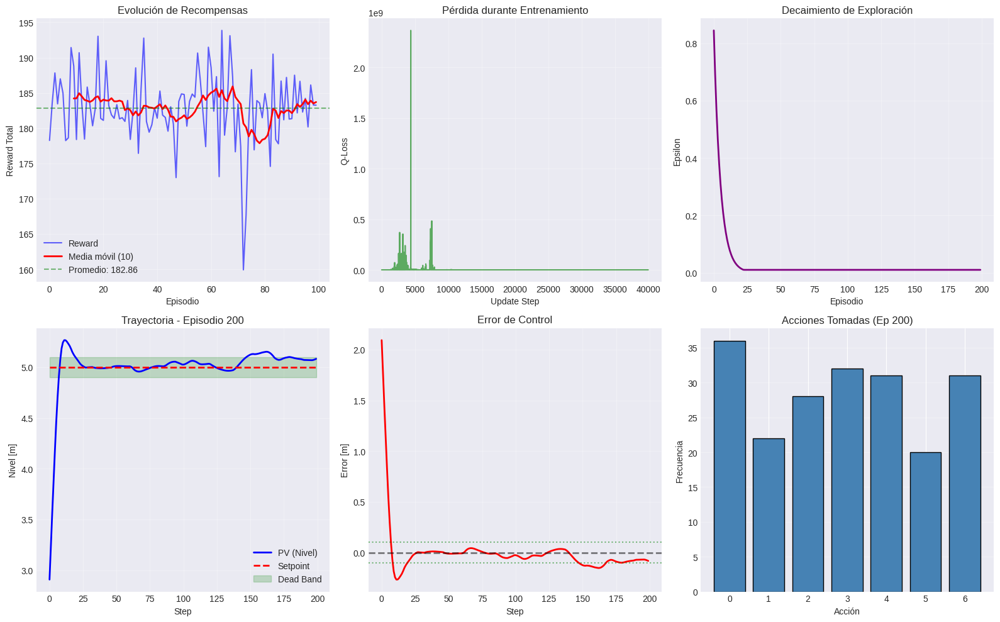


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       115
  Tasa de éxito:            57.50%
  Reward promedio (global): 182.86
  Error estado estacionario: 0.1236

  Últimos 10 episodios:
    Reward promedio:        183.69
    Desviación estándar:    2.28

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_devoted-sweep-44.pth

✅ Run completado: devoted-sweep-44
   Reward promedio: 182.86
   Tasa de éxito: 57.50%


avg_episode_reward,█▄▃▂▂▂▂▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▅▅▆
episode,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇█████
episode_reward,▄▇▂█▇▃▆▁▁▃▄▄▃▁▃▅▂▄▃▇▂▄▄█▃▃▄▂▄▄▅▅▇▆▆█▆▄▇▄
epsilon,█▇▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▂▂█▁▁▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▂▁▃▃█▂▂▂▃▃▄▁▂▁▂▄▃▂▁▂▂▃▅▁▂▂▂▃▁▁▄▂▄▂▁▁▁▄▁▃
success_rate,▇▄▃▃▃▂▂▁▃▃▃▄▄▅▅▆▆▆▇▇██▇▇▇▇▇▇█▇▇▇▇███████
+1,...


wandb: Agent Starting Run: omkcxk2b with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.14 | Avg:  186.14 | ε: 0.930 | Succe

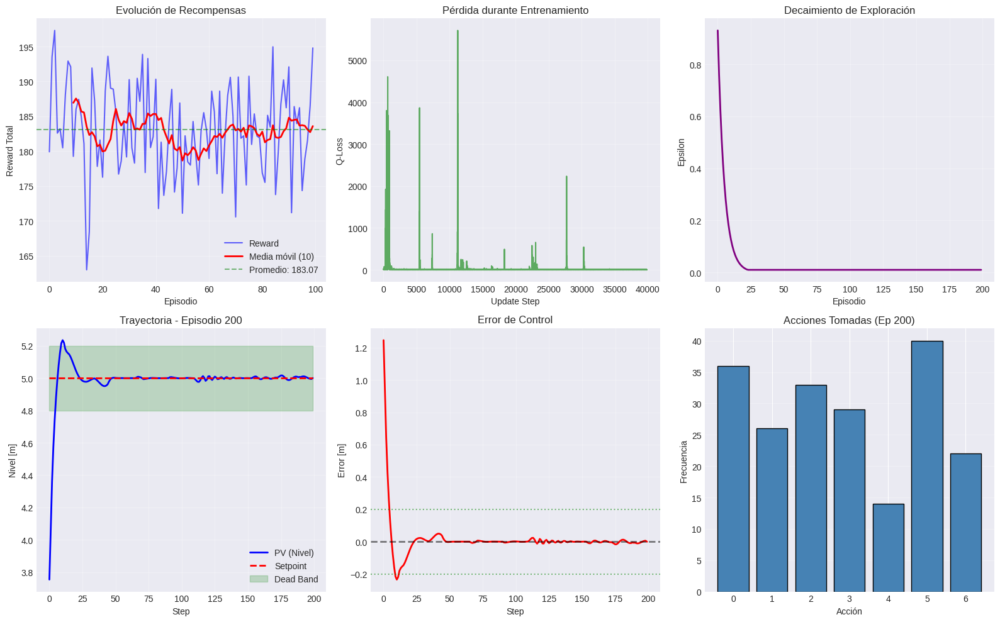


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       158
  Tasa de éxito:            79.00%
  Reward promedio (global): 183.07
  Error estado estacionario: 0.1250

  Últimos 10 episodios:
    Reward promedio:        183.59
    Desviación estándar:    6.99

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_dainty-sweep-45.pth

✅ Run completado: dainty-sweep-45
   Reward promedio: 183.07
   Tasa de éxito: 79.00%


avg_episode_reward,▆█▅▅▅▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▃▃▃▂▂▃▂▂▂▂▂▂▂▁▁▁▁▁
episode,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇███
episode_reward,▆█▃▅▆▄▆▄▄▂▅▃█▃▇▆▄▆▆▃▄▄▇▅▅▅▆▇▄▂▃▅▃▂▄▁▅▅▄▅
epsilon,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▂▁▁▄▂▁▁▁▁▁▁▃▂▁▁▁▁▁▁▂▇▂▁▁▁▁▁▁▅▁▁▁▁▁▁▁▁▁▁
steady_state_error,▂▂▃▂▁▂▁▁▁▁▂▁█▂▁▁▁█▃▃▂▃▁▄▁▁▁▂▂▂▂▁▁▁▂▃▃▄▂▁
success_rate,█▁▃▃▂▃▃▃▄▄▃▃▄▄▄▄▃▃▄▃▃▄▄▄▃▄▄▃▃▄▄▄▄▄▄▄▄▃▃▄
+1,...


wandb: Agent Starting Run: sca081rk with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  188.24 | Avg:  188.24 | ε: 0.480 |

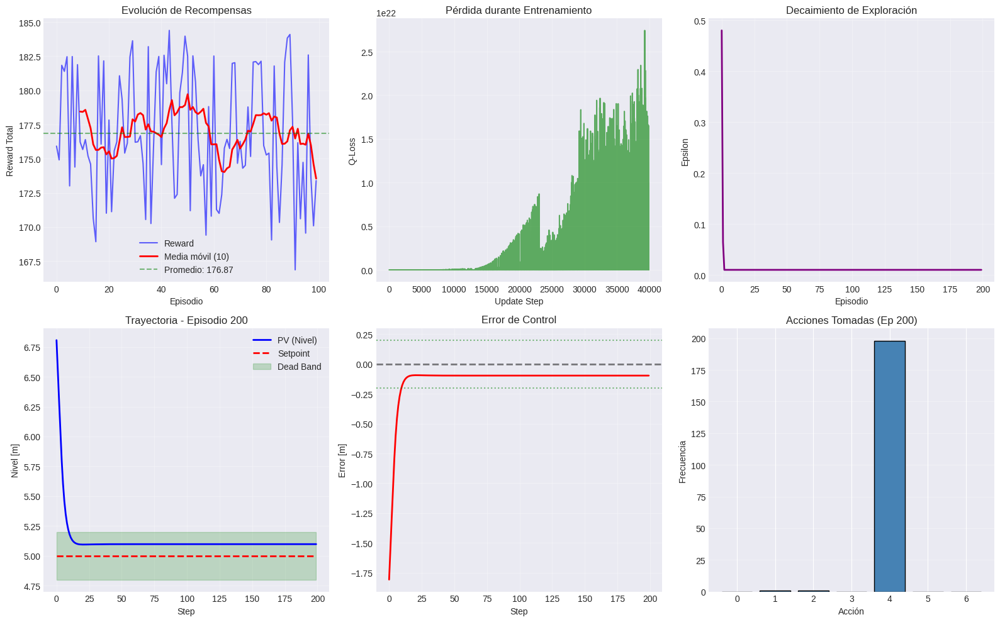


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       195
  Tasa de éxito:            97.50%
  Reward promedio (global): 176.87
  Error estado estacionario: 0.1002

  Últimos 10 episodios:
    Reward promedio:        173.54
    Desviación estándar:    4.36

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_deft-sweep-46.pth

✅ Run completado: deft-sweep-46
   Reward promedio: 176.87
   Tasa de éxito: 97.50%


avg_episode_reward,█▆▅▃▄▂▃▃▃▃▄▄▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
episode,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██
episode_reward,▃▅▄▄▁█▄▅▄▄▄▃▄▆▃▄▆▂▃▃▃▃▆▃▄▄▆▆▃▄▄▆▆▆▂▄▂▆▆▆
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▂▂▂▂▃▃▃▃▄▅▇▇▆▇▇██
steady_state_error,▆▁▂▂█▁▁▂▁▁▂▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
success_rate,█▅▁▃▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇████████████
+1,...


wandb: Agent Starting Run: 7a49fzre with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.37 | Avg:  189.37 | ε: 0.930 | Succe

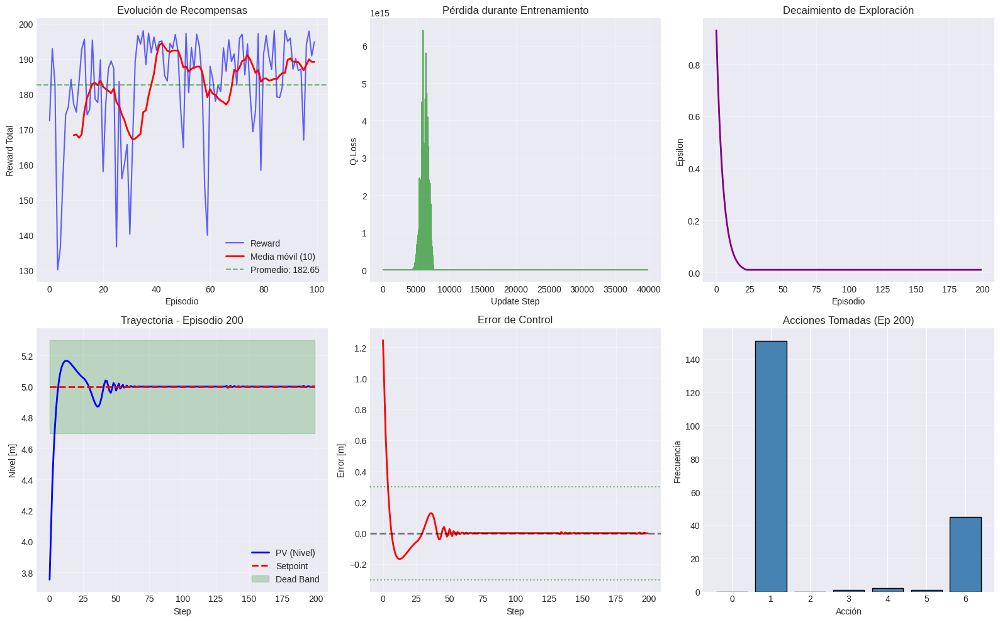


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       146
  Tasa de éxito:            73.00%
  Reward promedio (global): 182.65
  Error estado estacionario: 0.1928

  Últimos 10 episodios:
    Reward promedio:        189.15
    Desviación estándar:    8.30

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_vocal-sweep-47.pth

✅ Run completado: vocal-sweep-47
   Reward promedio: 182.65
   Tasa de éxito: 73.00%


avg_episode_reward,██▆▆▄▃▂▂▂▁▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▃▃▃▄▄▄▄▄▄▄▄▄▅▅
episode,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇█
episode_reward,▇▇█▇▇▅▃▄▃▃▃▆▄▅▅▇▇▆▆▇▁█▆▃▇▇▄▄█▇▄▇▃▇▆▇▆██▆
epsilon,█▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▂█▆▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▃▁▇▇▁▂▇▅▅▅▄▁▁▁▂▁▁▁▁█▁▁▁▂▁▁▇▁▁▁▂▁▁▂▁▁▂▂▁
success_rate,█▇▆▄▃▁▂▂▁▁▂▂▂▃▃▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
+1,...


wandb: Agent Starting Run: 9xnqybp0 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.33 | Avg:  189.33 | ε: 0.480 | Succ

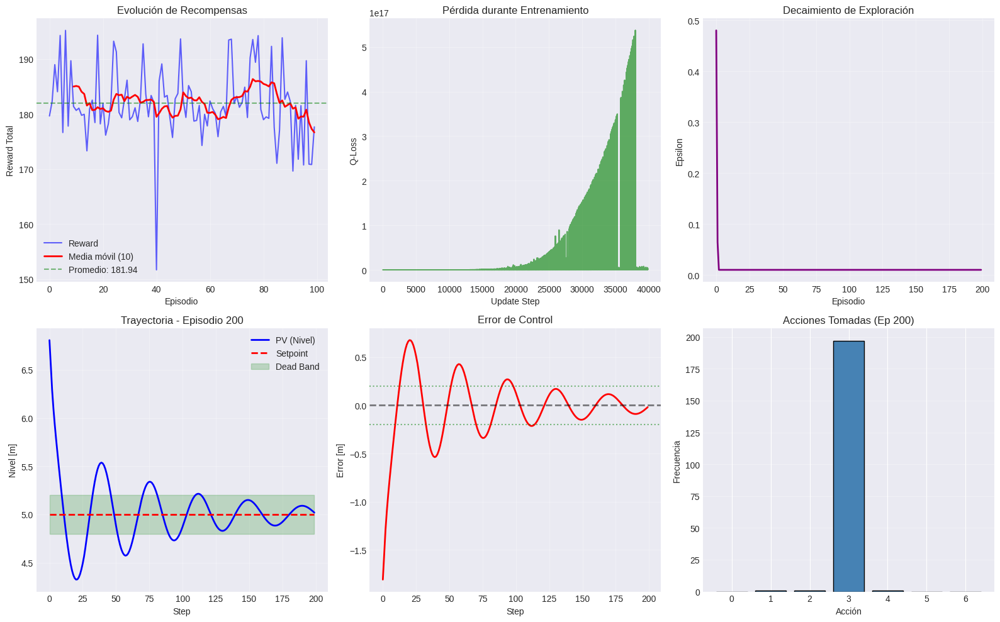


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       185
  Tasa de éxito:            92.50%
  Reward promedio (global): 181.94
  Error estado estacionario: 0.0500

  Últimos 10 episodios:
    Reward promedio:        176.65
    Desviación estándar:    6.52

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_dazzling-sweep-48.pth

✅ Run completado: dazzling-sweep-48
   Reward promedio: 181.94
   Tasa de éxito: 92.50%


avg_episode_reward,▇▃▄▄▃▂▂▂▁▁▁▂▂▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▇▇▇▇▇▇▇███
episode,▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
episode_reward,▄▆▄▆▅▅▅▄▇▇▇▅▅▆▇▆▅▅▆▇█▅▆▆█▅▆▇▆▆▁▆▆▆▅▆▆█▅▄
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▁▃▄▂▂▃▅▂▄█▂
steady_state_error,▁▁▂▂▂▂▂▂▂▂█▁▁▁█▁▁▁▁▁▁▁▁▁▁▁█▁▂▁▁▁▁▁▂▁▁▁▁▂
success_rate,█▂▁▄▅▄▄▄▂▃▂▃▃▃▃▃▃▃▄▃▃▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅
+1,...


wandb: Agent Starting Run: c9omrcgm with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  181.30 | Avg:  181.30 | ε: 0.844 |

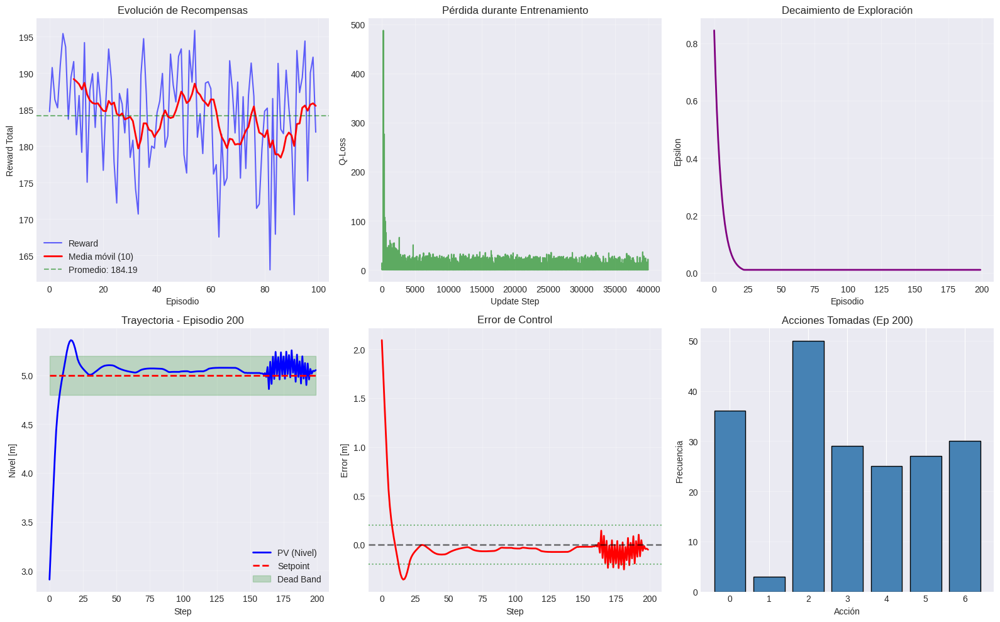


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       174
  Tasa de éxito:            87.00%
  Reward promedio (global): 184.19
  Error estado estacionario: 0.1039

  Últimos 10 episodios:
    Reward promedio:        185.53
    Desviación estándar:    7.63

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_usual-sweep-49.pth

✅ Run completado: usual-sweep-49
   Reward promedio: 184.19
   Tasa de éxito: 87.00%


avg_episode_reward,▁██▇▆▆▆▆▅▅▅▅▅▅▄▄▄▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
episode,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇████
episode_reward,▅▆▆▇▆▆▂▄▆▄▃▁▃▆▁▅▆▆▄▄▅▇▆▇▆▆▆▆▄▂▄▆▃█▆▆▃▆▇▄
epsilon,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▂▆▇▅█▆▆▁▄▅▅▂▃▄▅▃▄▂▄▅▄▃▂▄▅▂▃▃▅▃▄▃▃▂▃▁▅▃▃▃
steady_state_error,▁▁▁▁▂▁▃▄▃█▁▁▁▂▄▂▁▄▂▂▁▁▂▂▃▃▂▃▁▁▂▂▃▃▃▂▅▃▁▁
success_rate,▁▇▇████▇▇▇▇▇▇▇▇▇▇▇▇▇███▇███▇████████▇▇▇▇
+1,...


wandb: Agent Starting Run: j032xtio with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.22 | Avg:  186.22 | ε: 0.844 | 

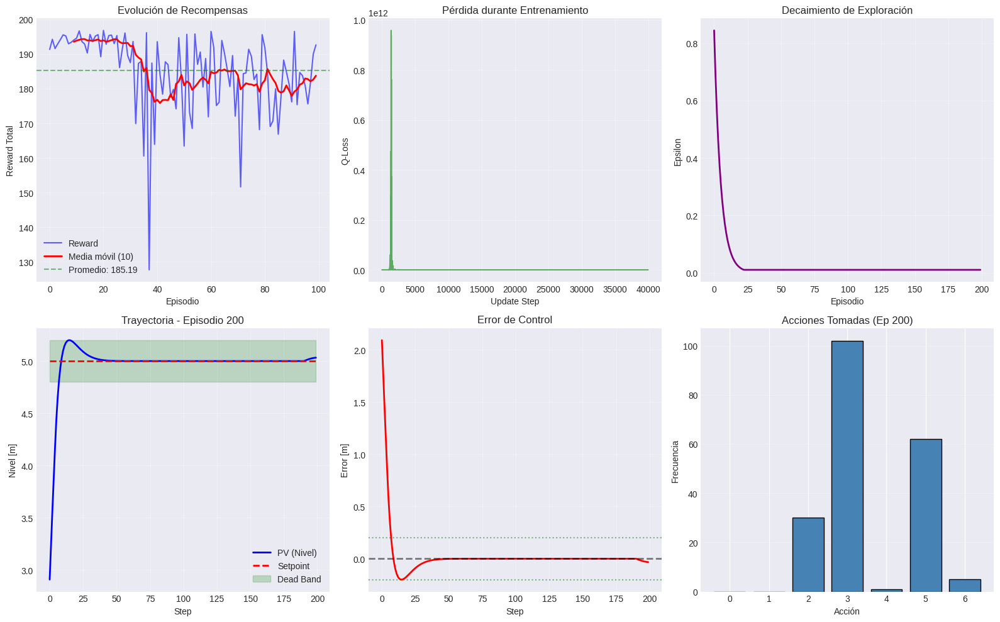


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       179
  Tasa de éxito:            89.50%
  Reward promedio (global): 185.19
  Error estado estacionario: 0.1965

  Últimos 10 episodios:
    Reward promedio:        183.74
    Desviación estándar:    6.97

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_sunny-sweep-50.pth

✅ Run completado: sunny-sweep-50
   Reward promedio: 185.19
   Tasa de éxito: 89.50%


avg_episode_reward,▆▆▂▁▃▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇███████▇▆▅▅▅▅▄▃▃▃▃▂
episode,▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▆▆▆▆▆▆▆▆▇▇▇█
episode_reward,█▆▆▄▄▄▇▇█▇█▇▇█▇█▇▇███▇▇▇▇▇▆▆▆▁▄▄▅█▅▇▅▂▆▆
epsilon,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▃▁▁▁▁▁▂▁▇▁▁▁▁▁▁▁▁▁█
success_rate,██▁▃▄▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▄▄
+1,...


wandb: Agent Starting Run: 17zzy3ln with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.37 | Avg:  189.37 | ε: 0.930 | Succ

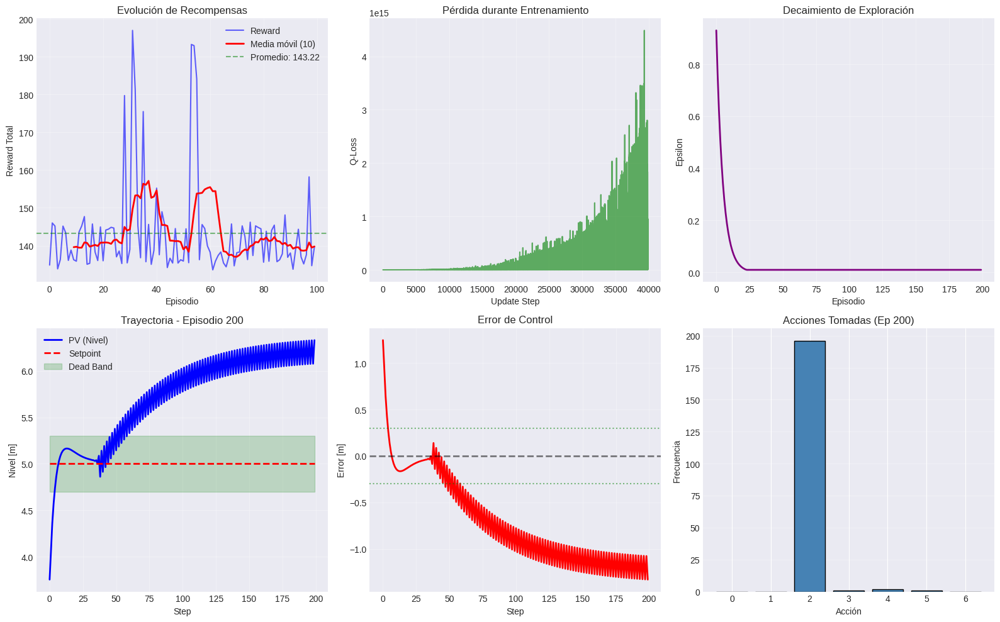


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       26
  Tasa de éxito:            13.00%
  Reward promedio (global): 143.22
  Error estado estacionario: 1.1116

  Últimos 10 episodios:
    Reward promedio:        139.77
    Desviación estándar:    6.78

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_expert-sweep-51.pth

✅ Run completado: expert-sweep-51
   Reward promedio: 143.22
   Tasa de éxito: 13.00%


avg_episode_reward,█▇▇▄▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
episode,▁▁▂▂▂▂▂▂▂▂▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██
episode_reward,█▃▅▁▂▂▂▁▂▂▄▄▂▂▂▁▁▂▁▂▁▂▁▃▁▂▁▁▁▁▃▃▁▂▁▂▁▂▁▂
epsilon,█▄▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▃▃▄▄▅▆█
steady_state_error,▇▇█▇▇▇██▁▇▂▁█▇██▇█▇██▇▇▇▇▂█▇███▇▇▇█▇▇▅█▆
success_rate,██▃▃▃▂▂▂▂▂▁▂▂▂▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: zkm1e18c with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  187.98 | Avg:  187.98 | ε: 0.872 |

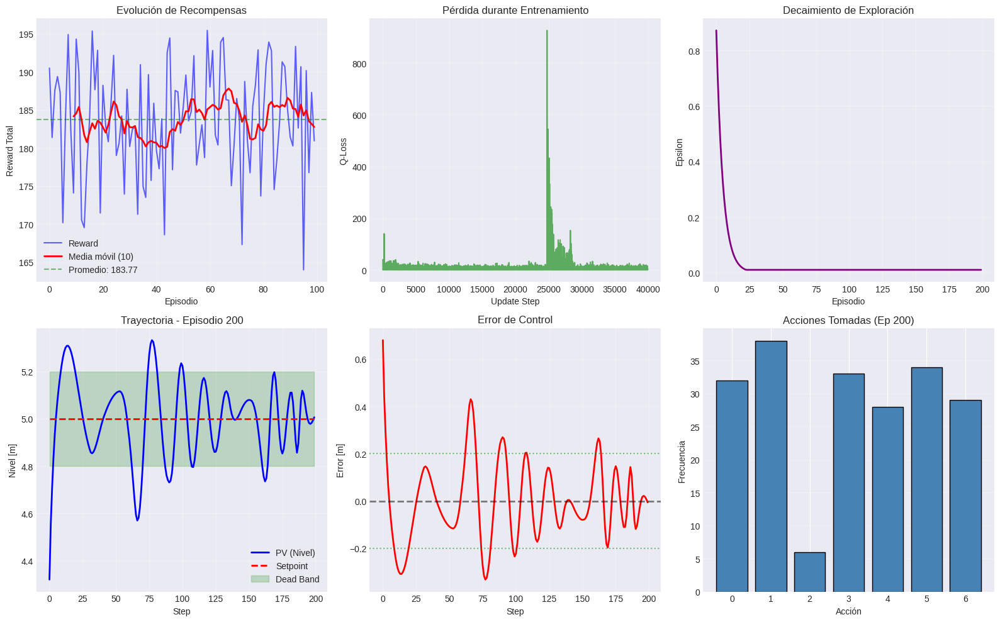


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       158
  Tasa de éxito:            79.00%
  Reward promedio (global): 183.77
  Error estado estacionario: 0.1450

  Últimos 10 episodios:
    Reward promedio:        182.76
    Desviación estándar:    8.06

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_misty-sweep-52.pth

✅ Run completado: misty-sweep-52
   Reward promedio: 183.77
   Tasa de éxito: 79.00%


avg_episode_reward,▇█▄▁▁▂▃▄▄▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▁▂▂▂▂▃▂▂▂▂▃
episode,▁▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇███
episode_reward,▆▅▆▅▅▇▇▆▆▆▅▅▂▃▆▄▄▆▅█▄▇▇█▆▅▄▄▄▇▅▄▆▃▅▇▅▅▅▁
epsilon,█▇▆▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▂▂▂▁▂▁▁▁▂▁▁▂▁▁▂▁▁▁▁▁▁▁▂▁▁▅▃▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▂▁▄▁▃▂▁▂▁▃▃▄▂▁▂▁▂▁▂▁▄▁▃▂▂▄▂▁▁▁▁█▁▁▂▄▂▃▁
success_rate,██▂▁▁▃▃▃▄▄▅▅▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
+1,...


wandb: Agent Starting Run: 01fss9o0 with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  181.30 | Avg:  181.30 | ε: 0.844 |

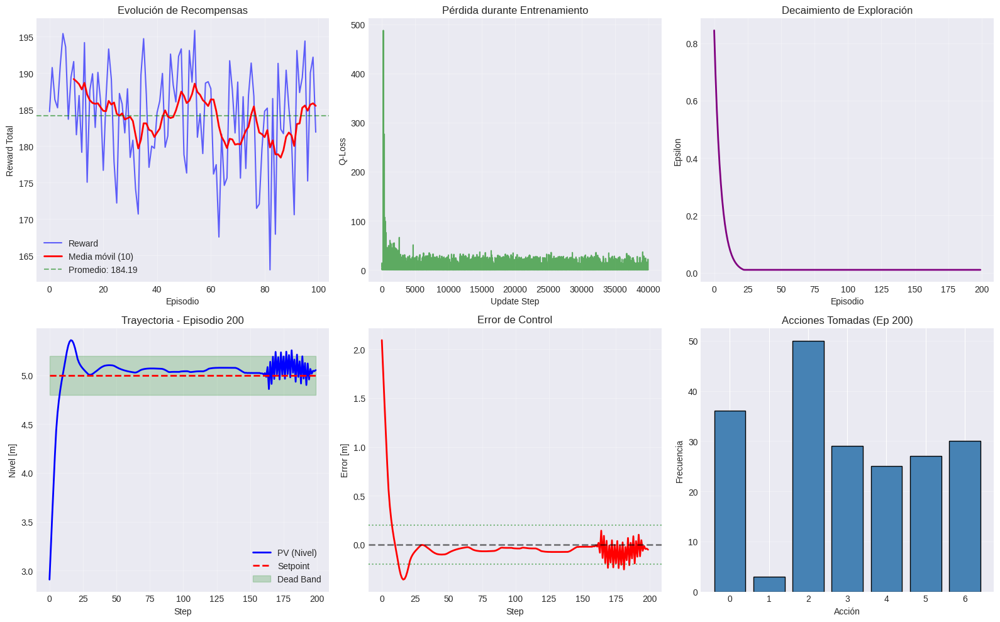


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       174
  Tasa de éxito:            87.00%
  Reward promedio (global): 184.19
  Error estado estacionario: 0.1039

  Últimos 10 episodios:
    Reward promedio:        185.53
    Desviación estándar:    7.63

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_desert-sweep-53.pth

✅ Run completado: desert-sweep-53
   Reward promedio: 184.19
   Tasa de éxito: 87.00%


avg_episode_reward,█▇▆▆▄▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▂▂▁▁▁▁▁
episode,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▅▆▇▇▇▇▇▇████
episode_reward,▆▆▁▅▅█▇▄▅▄▇▁▄▃▅▅▄▄▇▆▄▂▇▅▅▄▆▃▆▆▃▃▃▆▄▅▆▄▆▄
epsilon,█▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▃▁▄▃▂▅▂▃▃▃▂▂▃▃▂▂▂▃▂▃▂▃▂▃▄▁▃▂▁▄▃▂▃▃▂▁▂▁▂
steady_state_error,▂▃▂▂▃▃▁▄▁▁▁▂▄▇▆▂▃▁█▁▄▂▁▇▃▁▂▅█▅▃▂▇▂▄▃█▂▅▁
success_rate,▁▇▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
+1,...


wandb: Agent Starting Run: oudch9g0 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.33 | Avg:  189.33 | ε: 0.480 | Succ

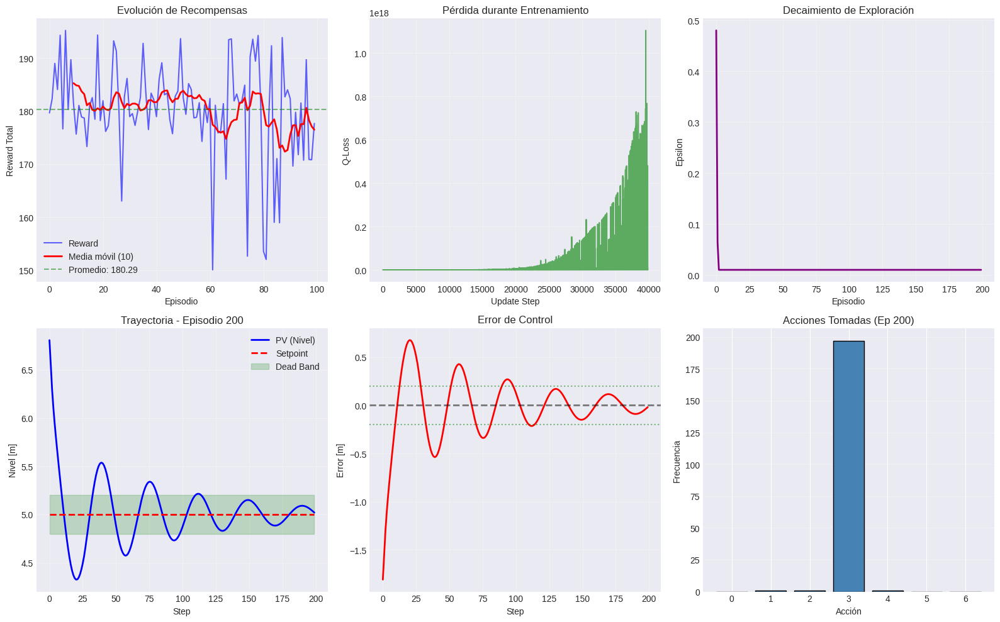


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       181
  Tasa de éxito:            90.50%
  Reward promedio (global): 180.29
  Error estado estacionario: 0.1106

  Últimos 10 episodios:
    Reward promedio:        176.47
    Desviación estándar:    6.41

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_lucky-sweep-54.pth

✅ Run completado: lucky-sweep-54
   Reward promedio: 180.29
   Tasa de éxito: 90.50%


avg_episode_reward,▃▄▃▃▁▁▁▂▂▃▃▄▄▄▄▄▄▄▅▅▆▇▇▇▇████████▇▇▇▇▇▇▇
episode,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇████
episode_reward,█▇▅▅▆▇▅▅▇▃▅▇▇▆▆▆▆▁▇▆▆▆▆▆▆▆▃▆▆▇▆▆▆▁▆▇█▆▅▅
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▁▂▅██▅
steady_state_error,▁▂▂▂▂▂▂▂▂▇█▁▁█▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁██▂
success_rate,▁▅▅▇▇██▆▆▇▆▄▄▄▃▄▅▅▅▅▆▅▆▆▆▇▇▇▇▇▇▇▇▇▇█▇▇▇▇
+1,...


wandb: Agent Starting Run: bkxjnpde with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.37 | Avg:  189.37 | ε: 0.930 |

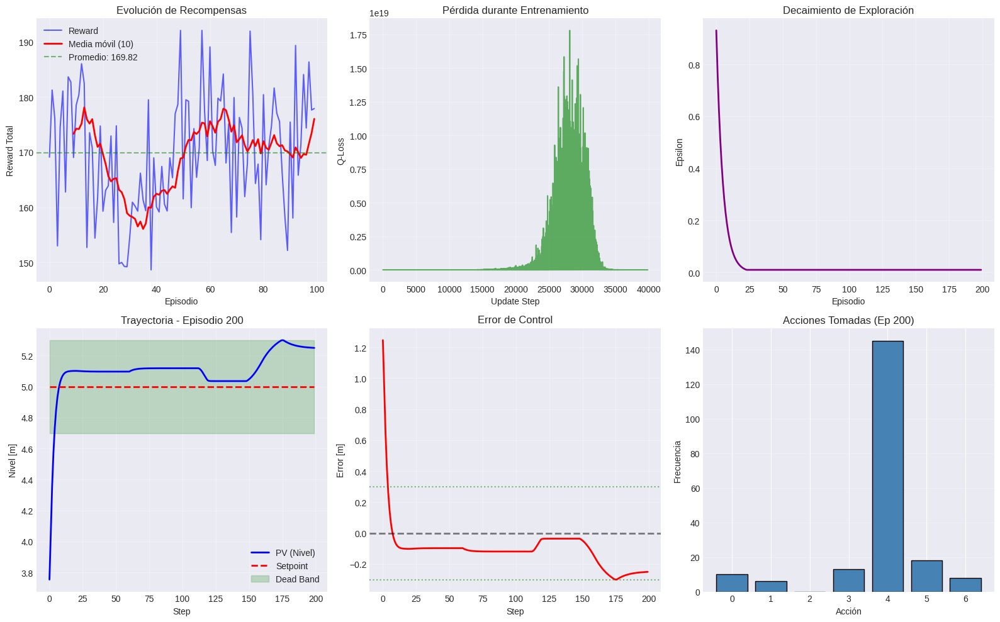


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       94
  Tasa de éxito:            47.00%
  Reward promedio (global): 169.82
  Error estado estacionario: 0.6442

  Últimos 10 episodios:
    Reward promedio:        176.05
    Desviación estándar:    8.98

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_leafy-sweep-55.pth

✅ Run completado: leafy-sweep-55
   Reward promedio: 169.82
   Tasa de éxito: 47.00%


avg_episode_reward,█▇▇▇▇▇▇▇▆▆▆▆▆▆▅▄▄▄▄▄▄▄▄▄▄▄▂▂▂▁▁▂▂▂▂▁▁▁▁▁
episode,▁▁▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇█████
episode_reward,▆▆▆▇▆▇▇▃▂▂▄▅▄▅▄▆██▄▆▆▁▄▅▅▂▆▄▂▂▃▄▄▅▅▁▃▆▂▇
epsilon,█▇▅▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▄▄▆▅██▁▁▁▁▁▁▁▁
steady_state_error,▁▂▁▂▁▁▃▃▂▇▂▅█▇▁▇▃▂▂▃▆▅▂▇▂██████▅▁▂▅▁▇▁██
success_rate,██████▇▇▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁▂▂▁▂▂
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ns08oafi with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  188.43 | Avg:  188.43 | ε: 0.844 | 

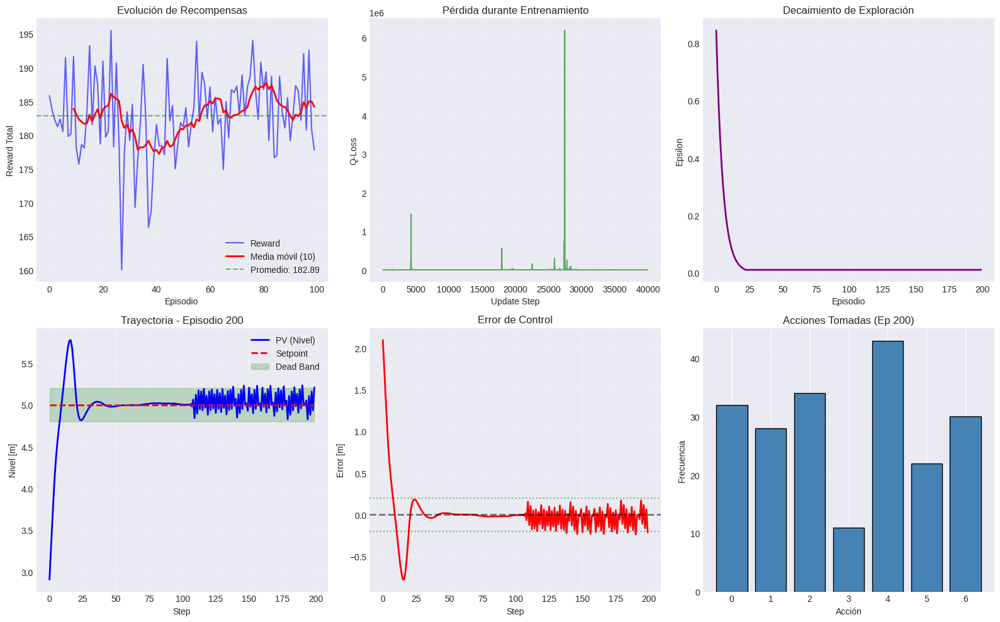


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       162
  Tasa de éxito:            81.00%
  Reward promedio (global): 182.89
  Error estado estacionario: 0.1446

  Últimos 10 episodios:
    Reward promedio:        184.20
    Desviación estándar:    4.93

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_restful-sweep-56.pth

✅ Run completado: restful-sweep-56
   Reward promedio: 182.89
   Tasa de éxito: 81.00%


avg_episode_reward,█▇█▇▇▄▅▅▅▅▅▅▄▄▄▅▅▅▅▅▄▄▄▄▄▃▄▄▄▄▃▂▂▂▁▁▁▁▁▂
episode,▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇█████
episode_reward,█▇▇▅▂▅▅██▅▃█▇▅▅▄▆▄▅▇▇▆▆▃▄▃▄▅▇▄▃▁▄▃▅▆▅▆▆▄
epsilon,█▇▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▄█▁▁▁▁▁▁▅▁▃▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▃▁▃▁▁▂▁▂▁▁▂▁▆▁▂▁▂▁▂▂▂▂▂▂▃▂▁█▃▂▁▁▃▁▃▁▂▃▁
success_rate,████▃▃▃▃▃▃▃▃▃▂▃▃▃▂▂▂▂▂▁▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: whlqd623 with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.65 | Avg:  189.65 | ε: 0.872 | 

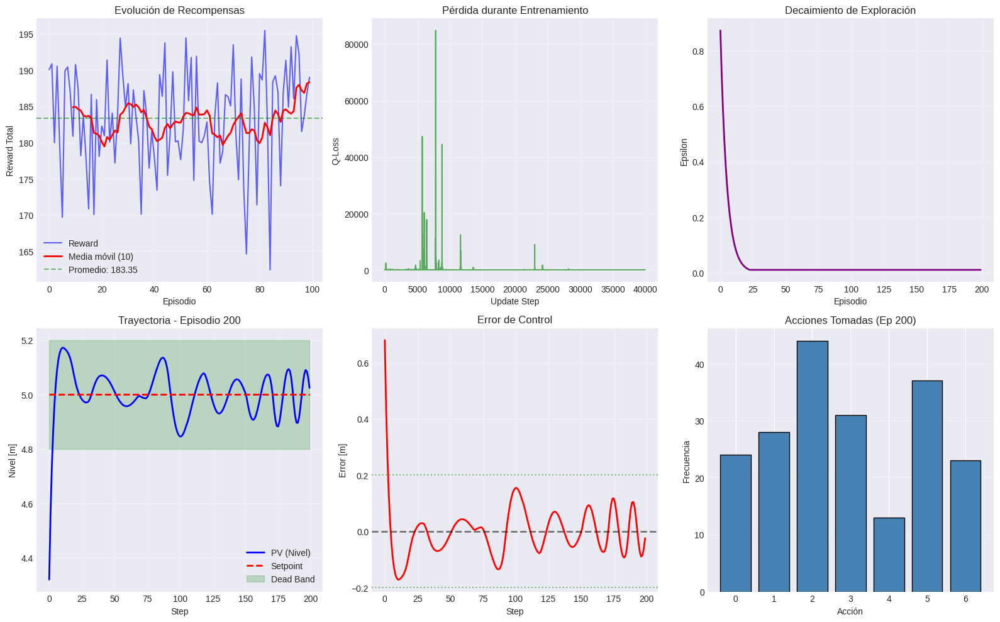


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       162
  Tasa de éxito:            81.00%
  Reward promedio (global): 183.35
  Error estado estacionario: 0.1408

  Últimos 10 episodios:
    Reward promedio:        188.34
    Desviación estándar:    4.22

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_misunderstood-sweep-57.pth

✅ Run completado: misunderstood-sweep-57
   Reward promedio: 183.35
   Tasa de éxito: 81.00%


avg_episode_reward,▇▇▇█▇▅▅▃▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▂▂▁▂▂▂▂▂▂▂▂
episode,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████
episode_reward,▆▇▅█▃▆▄▃▁▁█▄▃▅▆█▃▂▂▂▇▃▇▃▄▃▅▂▆▂▃▅▅█▁▇▄▇▅▆
epsilon,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▂▁▃▁▁▁▁▁▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▂▁▁▂▄▁▂▂▁▅▁▁▂▁▁▁▁▁▃▃█▂▃▁▁▂▂▂▁▁▅▁▂▃▁▁▆▁▁▁
success_rate,████▆▄▃▃▂▃▃▃▃▃▃▂▂▃▁▁▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: 8nh9lu3b with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.99 | Avg:  189.99 | ε: 0.503 | Succ

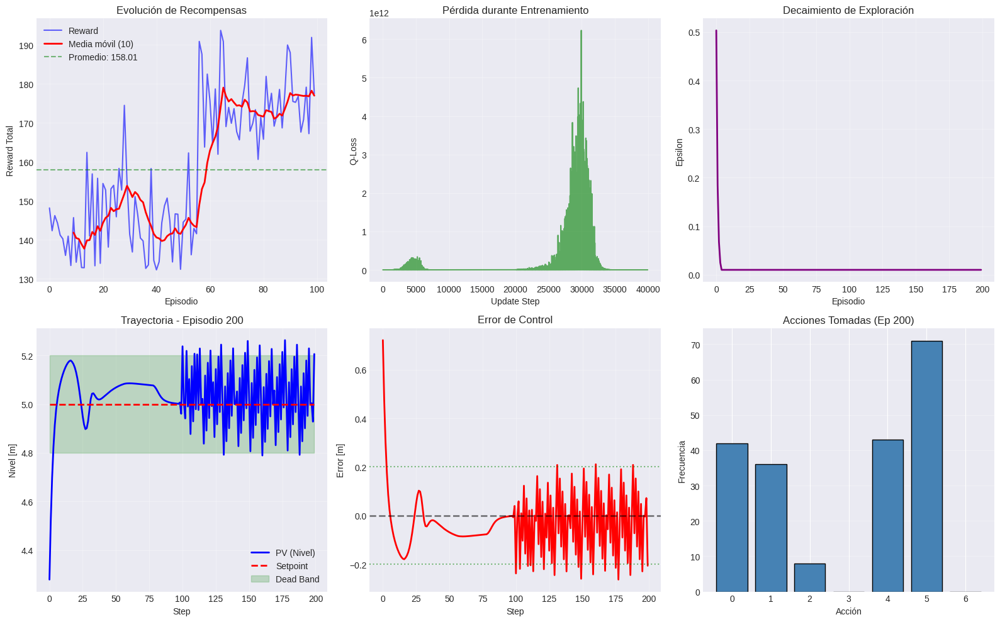


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       70
  Tasa de éxito:            35.00%
  Reward promedio (global): 158.01
  Error estado estacionario: 0.7308

  Últimos 10 episodios:
    Reward promedio:        176.98
    Desviación estándar:    7.59

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_clear-sweep-58.pth

✅ Run completado: clear-sweep-58
   Reward promedio: 158.01
   Tasa de éxito: 35.00%


avg_episode_reward,█▆▃▂▁▁▁▂▂▃▃▄▃▃▃▄▄▄▄▄▄▄▄▄▄▂▂▂▂▂▃▃▃▃▃▃▂▂▃▃
episode,▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇█
episode_reward,█▆▅▁▂▆▁▆▇▇▇▅▆▂▂▂▆▅▆▅█▇▆▅▃▂▂▂▂▂▄▃▃▂▄▆▆▆▆▆
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▃▄█▇▅▃▂▁▁▁▁▁
steady_state_error,▁▇▇▇▆▂▁█▂▃█▇▃▁▁▇▁▁▄▃█▇██▇▇██▇▆▂▁▁▁▂▆▂▁▁▁
success_rate,▇▅▄▄▃▂▁▁▂▄▇▆▆▅▅▅▆▆▆▇██▇▇▇▅▄▄▄▄▄▅▆▆▆▆▆▇▇█
+1,...


wandb: Agent Starting Run: cuqrybz4 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  187.56 | Avg:  187.56 | ε: 0.694 | Succ

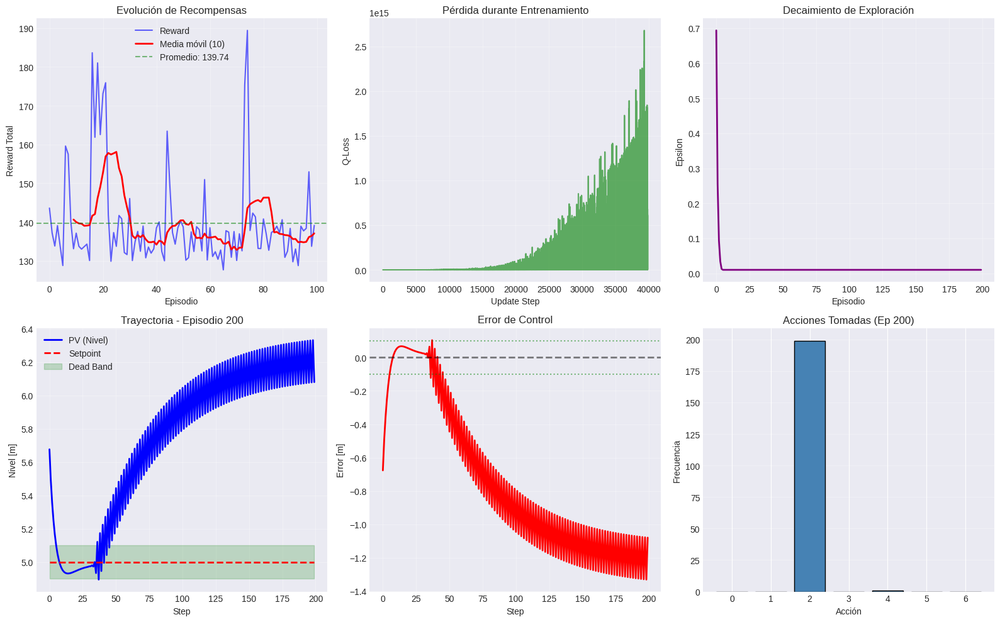


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       19
  Tasa de éxito:            9.50%
  Reward promedio (global): 139.74
  Error estado estacionario: 1.0778

  Últimos 10 episodios:
    Reward promedio:        137.07
    Desviación estándar:    6.43

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_dark-sweep-59.pth

✅ Run completado: dark-sweep-59
   Reward promedio: 139.74
   Tasa de éxito: 9.50%


avg_episode_reward,█▆▆▄▆▆▆▆▆▆▅▅▆▇▇▇▇███▆▆▅▄▅▇▇▇▅▅▅▅▄▃▃▂▁▁▁▁
episode,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▅▅▅▅▅▅▅▅▆▆▇▇▇▇▇█████
episode_reward,▃▁▂▁▁▄▃▁▁▆▁▁█▁▁▂▂▁▂▂▂▁▅▂▇▁▂▂▂▁▁▁▁▄▂▁▃▁▁▂
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▂▂▂▂▃▃▃▄▄▃▄▄▄▆▆▇██
steady_state_error,██▇▅██▆█▁▁▇████▄█▇▇█▇▁▂█▇██▇▆▇█▇██▂██▇▅▇
success_rate,██▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: 9tce0ull with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.14 | Avg:  186.14 | ε: 0.930 | 

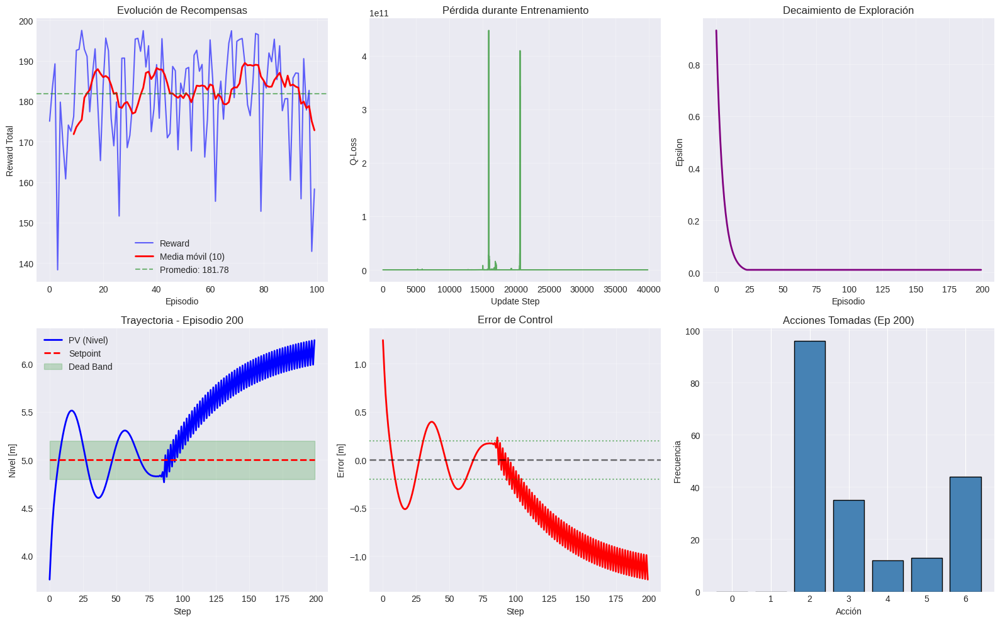


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       144
  Tasa de éxito:            72.00%
  Reward promedio (global): 181.78
  Error estado estacionario: 0.2494

  Últimos 10 episodios:
    Reward promedio:        172.81
    Desviación estándar:    15.96

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_floral-sweep-60.pth

✅ Run completado: floral-sweep-60
   Reward promedio: 181.78
   Tasa de éxito: 72.00%


avg_episode_reward,███▆▆▆▆▅▄▄▄▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▂▂▂▂▂▃▃▃▃▃
episode,▁▁▁▁▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇█████
episode_reward,▇▆▅▇▇▆▇▇▇▆▁▇▇▅▃▆▆▆▃▇▄▅▃▇█▇▇▆▄▆▇█▁▅▄▅█▅█▇
epsilon,█▆▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▂▂▁▁▁▂▃▁▁▂▁▁▃▅▁▇▆▃▂▃▂▁▂▂▄▃▁▁▂▂▁▁▁▁▁▁█▃▁▁
success_rate,████▆▇▅▄▄▃▃▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂
+1,...


wandb: Agent Starting Run: 63az38af with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.33 | Avg:  189.33 | ε: 0.480 | Succ

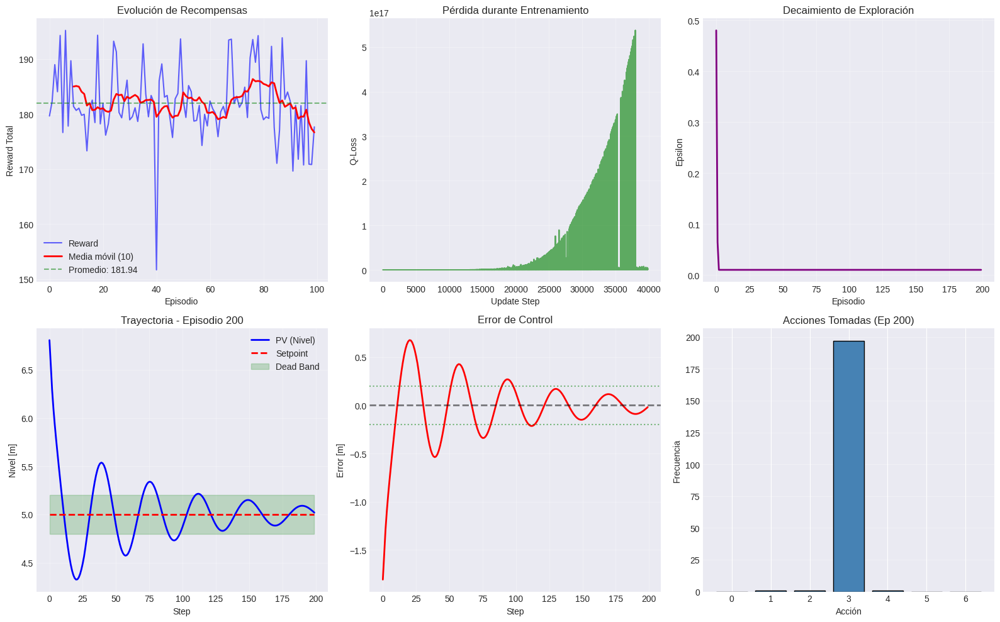


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       185
  Tasa de éxito:            92.50%
  Reward promedio (global): 181.94
  Error estado estacionario: 0.0500

  Últimos 10 episodios:
    Reward promedio:        176.65
    Desviación estándar:    6.52

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_dauntless-sweep-61.pth

✅ Run completado: dauntless-sweep-61
   Reward promedio: 181.94
   Tasa de éxito: 92.50%


avg_episode_reward,▇▇▂▃▃▃▁▁▁▂▂▃▃▃▄▄▄▄▅▅▅▅▅▅▇▇▇▇▇▇▇▇▇███████
episode,▁▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇█████
episode_reward,▅▁▄▅▂▃▄▂█▅▄▃▄█▃▃▅▃▄▄▄▆▃▇▂▄▅▇▅▆▄▄▂▅▃▄▄▃▁▃
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▃▂▃▄▇▅█▅█▆▂▂
steady_state_error,▁▂▂▂▂▂▁▂█▁▁▁▁▁█▁▂▁▁▁▆▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁
success_rate,█▃▁▃▄▆▅▅▅▄▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▆▆▆▆
+1,...


wandb: Agent Starting Run: 85lc6pan with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.73 | Avg:  185.73 | ε: 0.480 | Succ

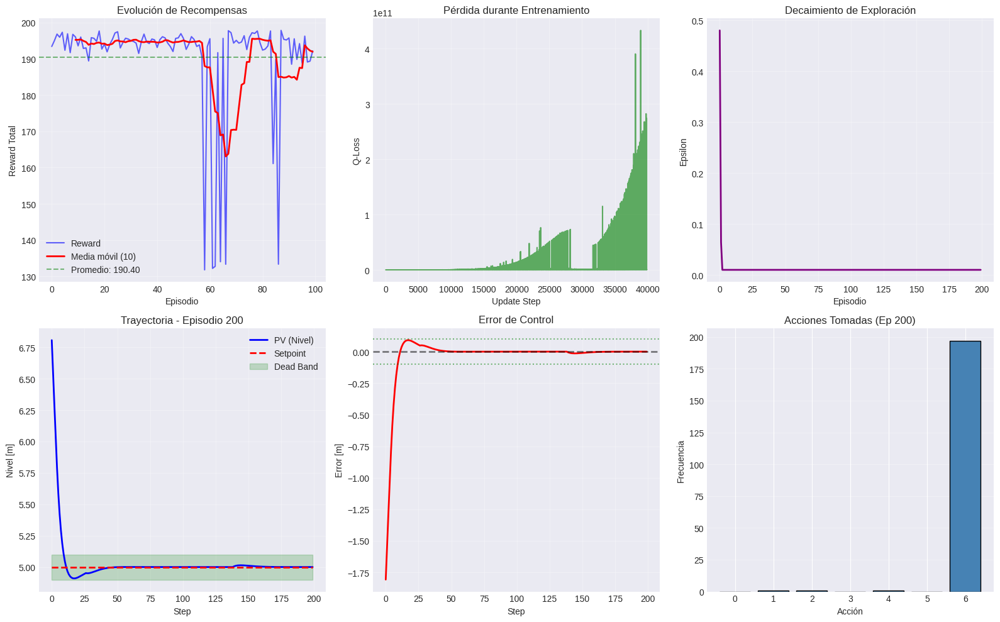


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       185
  Tasa de éxito:            92.50%
  Reward promedio (global): 190.40
  Error estado estacionario: 0.0805

  Últimos 10 episodios:
    Reward promedio:        191.93
    Desviación estándar:    3.03

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_laced-sweep-62.pth

✅ Run completado: laced-sweep-62
   Reward promedio: 190.40
   Tasa de éxito: 92.50%


avg_episode_reward,▄▁▁▁▂▃▃▃▃▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇█████▇▇▇▆▆
episode,▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
episode_reward,▇▇███▇▁▇███▇██▇█▇█████▇████████████▇▄▇██
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▂▁▂▂▁▂▁▁▁▂▃▄▅▆█
steady_state_error,▁▁▅▇▁▁█▁▁▇▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁██▁▁▁▇▁
success_rate,▁▄▅▄▅▅▆▆▅▆▇▇▇▇▇▇▇▇██████████████████████
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wm1hq84o with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [32, 32]
wandb: 	lr: 0.0001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (32, 32)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.48 | Avg:  185.48 | ε: 0.480 | Succ

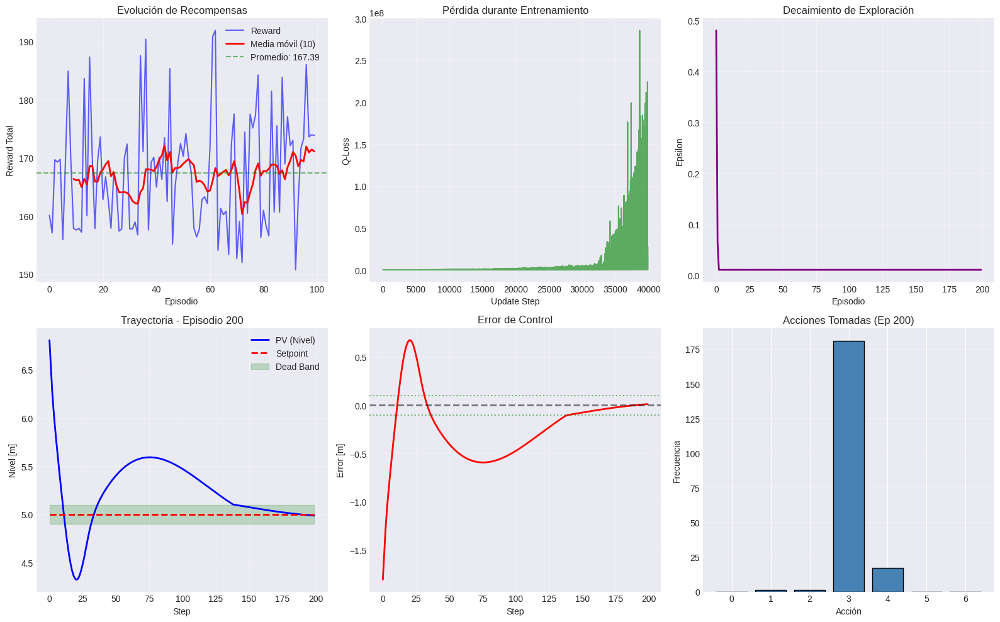


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       118
  Tasa de éxito:            59.00%
  Reward promedio (global): 167.39
  Error estado estacionario: 0.2364

  Últimos 10 episodios:
    Reward promedio:        171.09
    Desviación estándar:    8.58

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_helpful-sweep-63.pth

✅ Run completado: helpful-sweep-63
   Reward promedio: 167.39
   Tasa de éxito: 59.00%


avg_episode_reward,█▇▆▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂▁▁▂▂▂▂▂▂▂
episode,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▅▅▆▆▆▆▆▆▆▇▇▇▇▇█████
episode_reward,▇██▃█▄▇▂▅▃▂▁▄▄▂▄▂▂▄▂▁▇▂▇▄▅▂▂▇▅▂▂▁▂▅▂▂▇▃▅
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▃▄▅▇█
steady_state_error,▂▂▂▁▂▂▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂█▆▂▆▁▂
success_rate,▁██▆▇▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆
+1,...


wandb: Agent Starting Run: 2bd07iqt with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  184.16 | Avg:  184.16 | ε: 0.480 

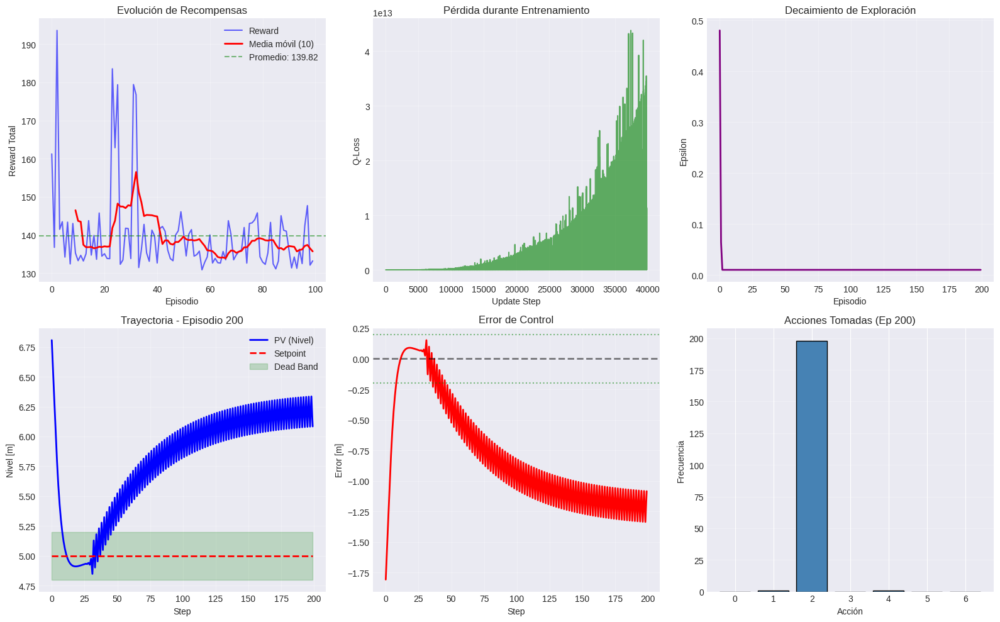


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       12
  Tasa de éxito:            6.00%
  Reward promedio (global): 139.82
  Error estado estacionario: 1.0652

  Últimos 10 episodios:
    Reward promedio:        135.69
    Desviación estándar:    5.09

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_polar-sweep-64.pth

✅ Run completado: polar-sweep-64
   Reward promedio: 139.82
   Tasa de éxito: 6.00%


avg_episode_reward,██▇▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
episode,▁▁▁▁▁▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇████
episode_reward,█▆▅▁▂▂▁▃▂▃▂▃▂▁▃▂▁▁▁▂▂▅▁▂▁▁▇▅▁▇▂▂▁▃▁▂▂▂▂▂
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▃▄▃▄▃▄▄▅▆▅▅▅▅▆██
steady_state_error,▁▁▂▃█▇▇▆██▅█▇▇█▇█▇███▁█▇▇█▇▇█▇███▇▇▇▅▇▄▇
success_rate,▇▃█▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: jsdzvywu with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.73 | Avg:  189.73 | ε: 0.872 | 

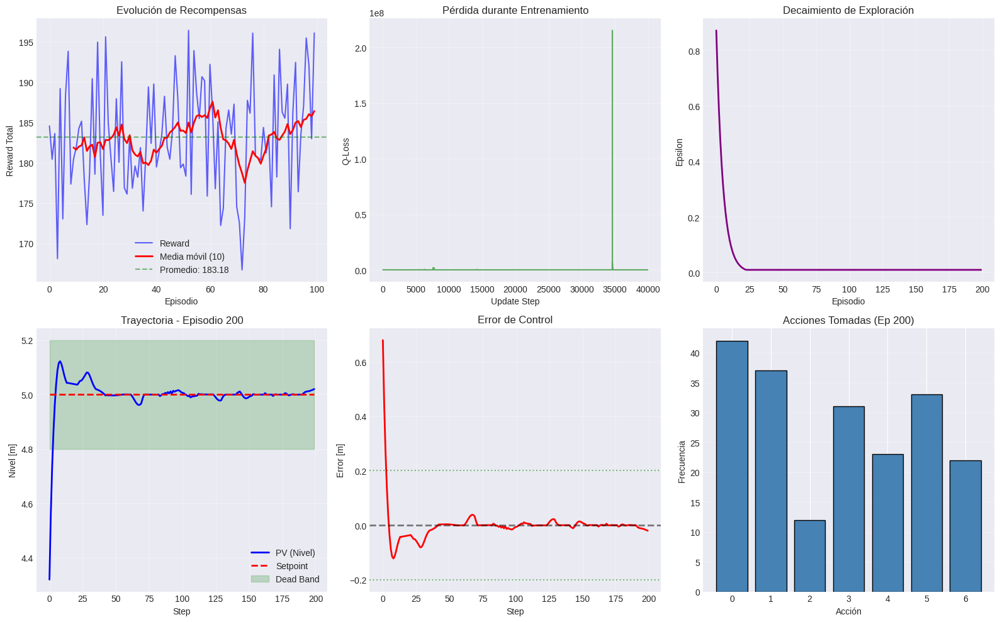


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       154
  Tasa de éxito:            77.00%
  Reward promedio (global): 183.18
  Error estado estacionario: 0.1685

  Últimos 10 episodios:
    Reward promedio:        186.39
    Desviación estándar:    7.59

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_hearty-sweep-65.pth

✅ Run completado: hearty-sweep-65
   Reward promedio: 183.18
   Tasa de éxito: 77.00%


avg_episode_reward,▇█▆▅▆▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▂▂▂▂▂▁▁▂▂
episode,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇█████
episode_reward,▇▆▃▇▆▅▄▁▆▁▇▆▃▄▅▆▄▆▆▄█▆▅▅▃▄▅▄▄▅▄█▃▁▆█▄▅▅▆
epsilon,█▆▅▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁▁▁▁▁▁
steady_state_error,▁▁▂▂▁▁▁▂▄▁▁▁▁▁▂▁▁▁▁▁▁▂▂▇▁▁▂▅▆▃▁▂█▂▁▁▁▅▂▃
success_rate,██▃▅▅▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: luept0xv with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  192.42 | Avg:  192.42 | ε: 0.872 | 

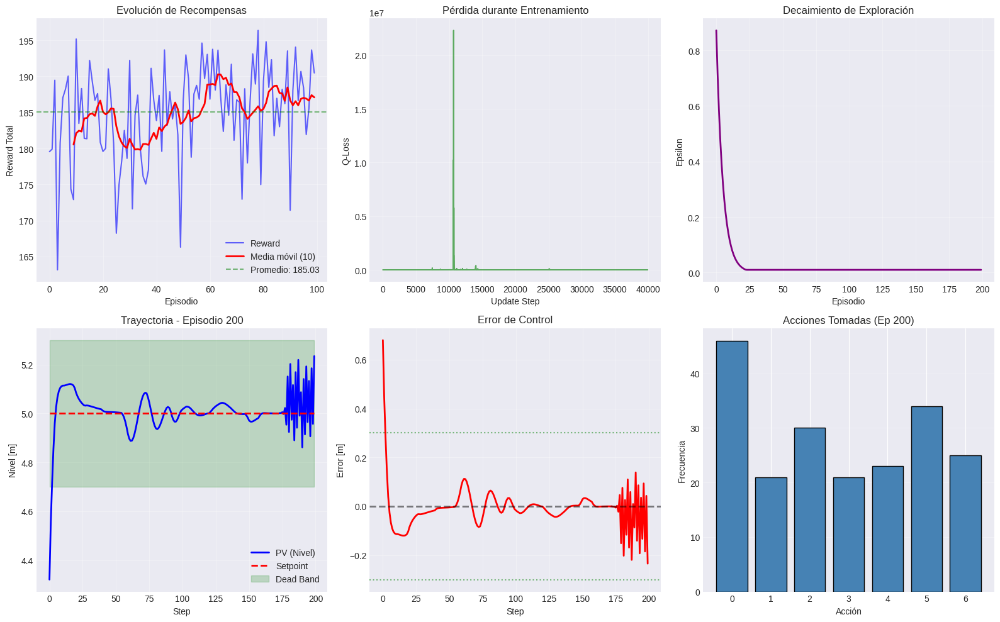


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       172
  Tasa de éxito:            86.00%
  Reward promedio (global): 185.03
  Error estado estacionario: 0.1295

  Últimos 10 episodios:
    Reward promedio:        187.09
    Desviación estándar:    6.27

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_autumn-sweep-66.pth

✅ Run completado: autumn-sweep-66
   Reward promedio: 185.03
   Tasa de éxito: 86.00%


avg_episode_reward,█▇▇▇▇▅▅▄▄▄▃▄▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▂▂▂▂▃▂▂
episode,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇██
episode_reward,▇█▅▅█▄█▃▆▇▄▅▅▇▇█▇▆█▇▅▇▁▆▇▄▆▅▄▆▆█▆▆▆▄▆▆█▆
epsilon,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▃▁▁▁▁▁▁▁▁▁▁▁▁▇▁▆▁▁▁▂▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▁▂▁▂▂▆▆▁▃▁█▁▅▁▄▂▂▂▂▁▂▃▃▆▁▂▁▁▁▅▁▁▁▁▃▃▂▂▂
success_rate,█████▄▄▄▃▃▂▂▂▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: z1oem5as with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.73 | Avg:  185.73 | ε: 0.480 | Succ

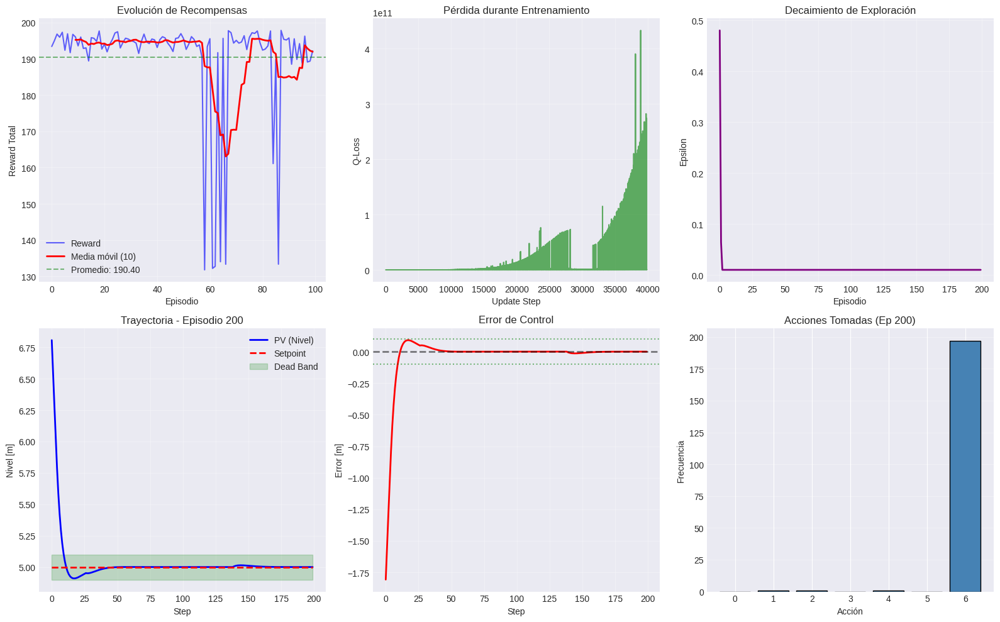


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       185
  Tasa de éxito:            92.50%
  Reward promedio (global): 190.40
  Error estado estacionario: 0.0805

  Últimos 10 episodios:
    Reward promedio:        191.93
    Desviación estándar:    3.03

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_iconic-sweep-67.pth

✅ Run completado: iconic-sweep-67
   Reward promedio: 190.40
   Tasa de éxito: 92.50%


avg_episode_reward,▅▁▃▃▂▃▃▃▄▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇████████▇▇▇▇▇▇
episode,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇█████
episode_reward,▂▇▇██▇▁██▁███████▇▇████████▇████▇▁▇███▇▇
epsilon,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▁▁▁▁▁▁▁▂▂▂▃▃▅▄█
steady_state_error,▁▁▁██▁▁▇▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
success_rate,██▁▂▃▃▃▃▃▃▄▄▄▄▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆
+1,...


wandb: Agent Starting Run: 3hqebkhg with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  190.29 | Avg:  190.29 | ε: 0.694 | Suc

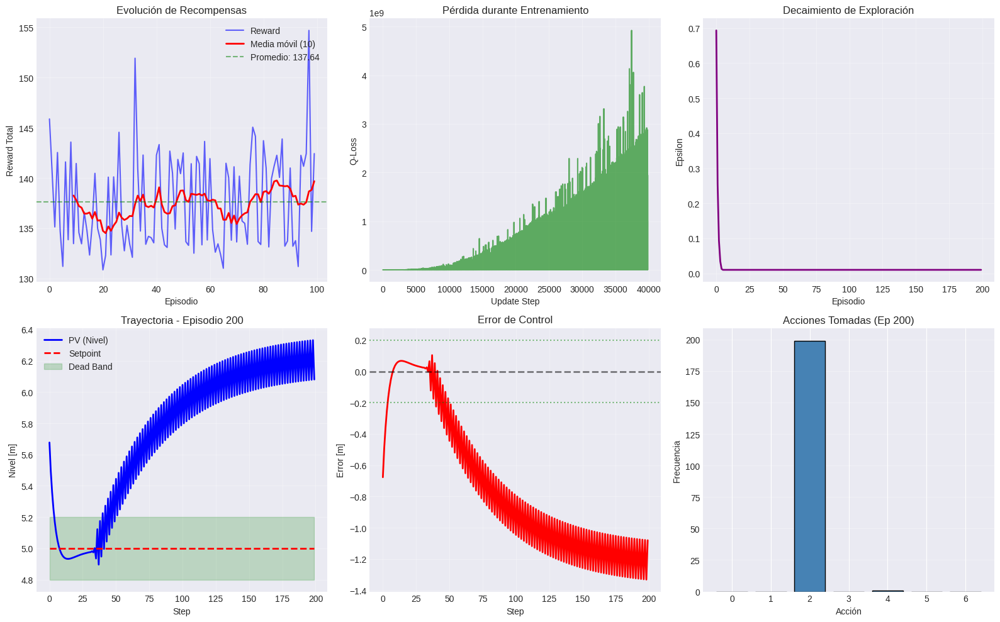


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       14
  Tasa de éxito:            7.00%
  Reward promedio (global): 137.64
  Error estado estacionario: 1.1419

  Últimos 10 episodios:
    Reward promedio:        139.68
    Desviación estándar:    6.52

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_fine-sweep-68.pth

✅ Run completado: fine-sweep-68
   Reward promedio: 137.64
   Tasa de éxito: 7.00%


avg_episode_reward,███▇▆▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
episode,▁▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇█████
episode_reward,█▆▁▂▁▁▁▂▂▁▃▂▁▁▂▂▂▁▁▁▁▁▁▁▁▃▁▁▂▁▂▁▂▁▂▁▁▂▂▄
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▅▅▆▅▆▆▇▇▆██▇
steady_state_error,▁██▇█▇████▄██▇██▁▇██▇▇▇▇▇▃▇▇▂▆█▇▇▇▇█▇▇▇█
success_rate,██▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: jyiijzz2 with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  182.01 | Avg:  182.01 | ε: 0.844 |

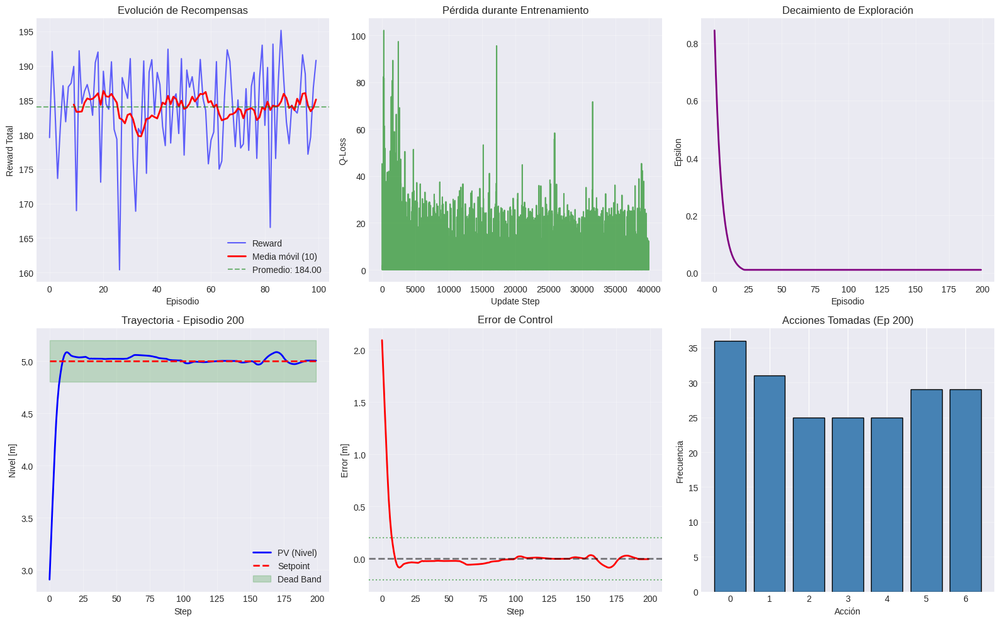


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       164
  Tasa de éxito:            82.00%
  Reward promedio (global): 184.00
  Error estado estacionario: 0.0966

  Últimos 10 episodios:
    Reward promedio:        185.11
    Desviación estándar:    4.37

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_devout-sweep-69.pth

✅ Run completado: devout-sweep-69
   Reward promedio: 184.00
   Tasa de éxito: 82.00%


avg_episode_reward,▁█▆▂▃▃▃▃▄▄▅▄▅▅▄▄▄▄▄▃▄▄▄▄▃▄▄▄▃▃▃▃▃▃▃▃▄▄▄▄
episode,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇██
episode_reward,▇█▄▅▇▅▆▇▇▅▇▄▇▆▆▅█▅▇▇█▅█▄▇▇▄▁▇▇▅█▅█▄▅▅▅▂▅
epsilon,█▆▃▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▇▅█▄▇▄▅▄▂▁▃▄▃▄▃▂▄▂▂▃▃▃▁▅▂▃▄▃▄▃▂▂▂▂▄▂▅▂▃▆
steady_state_error,▁▂▁▂▂▂▆▁▁▁▃▁▁▃▁▄█▁▂▃▁▄▂▂▆▂█▃▃▃▁▁▃▁▂▁▁▁▃▁
success_rate,█▃▅▄▂▃▄▅▄▄▄▃▃▃▃▂▂▂▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃
+1,...


wandb: Agent Starting Run: 6jld96f3 with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.99
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 5000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.99
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  188.20 | Avg:  188.20 | ε: 0.872 |

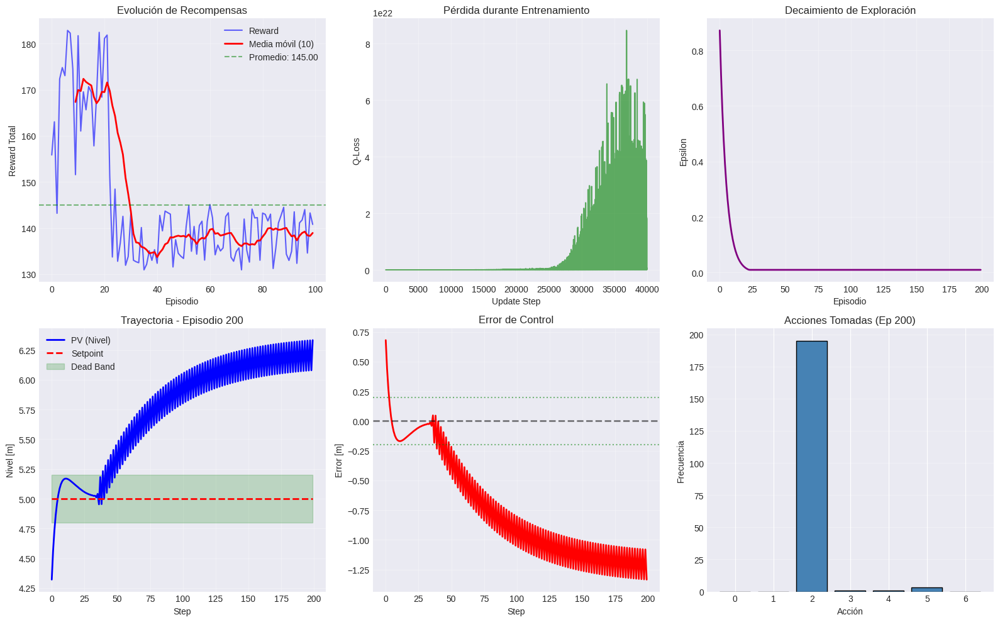


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       53
  Tasa de éxito:            26.50%
  Reward promedio (global): 145.00
  Error estado estacionario: 1.0008

  Últimos 10 episodios:
    Reward promedio:        138.92
    Desviación estándar:    4.42

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   5000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_valiant-sweep-70.pth

✅ Run completado: valiant-sweep-70
   Reward promedio: 145.00
   Tasa de éxito: 26.50%


avg_episode_reward,████▇▆▆▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁
episode,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇███
episode_reward,▇█▅▃▂▃▄▆▅▆▆▂▇▂▆▆▆▆▇▁▆▇▄▆▆▅▁▃▂▂▁▁▂▂▁▂▁▁▁▁
epsilon,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▃▃▄▅▆█▇▆▆
steady_state_error,▁▂▁▂▆▁▆▇▇▇▆▇▆▇▁▆▁▅▁▁▁▁█▁▆▁▁▁▁██▇▇▇▇▇▇▇██
success_rate,▂██▆▅▂▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: ukjyjdsj with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.58 | Avg:  185.58 | ε: 0.930 | 

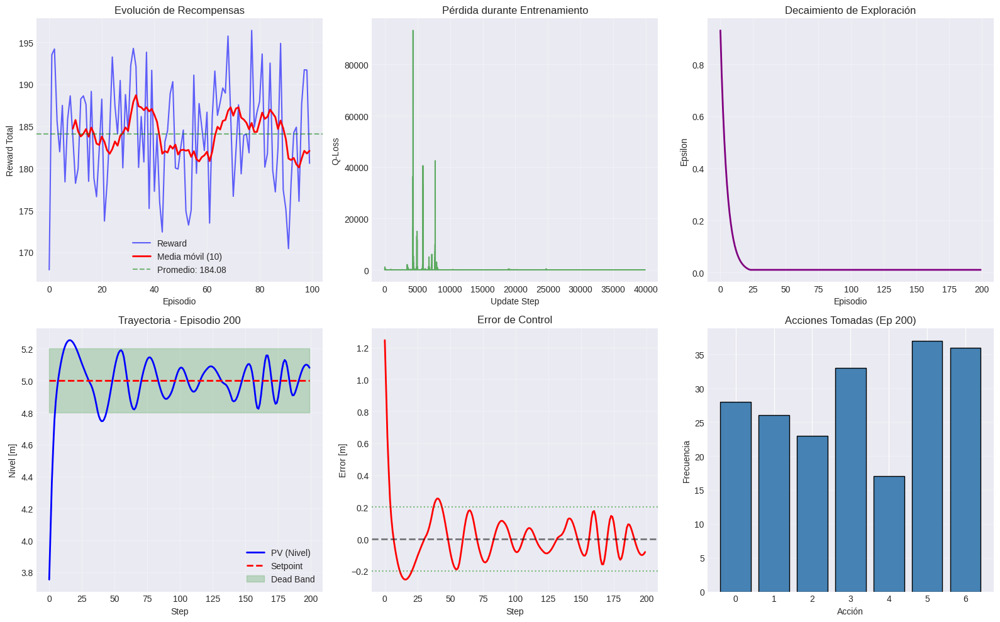


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       163
  Tasa de éxito:            81.50%
  Reward promedio (global): 184.08
  Error estado estacionario: 0.0978

  Últimos 10 episodios:
    Reward promedio:        182.05
    Desviación estándar:    6.82

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_summer-sweep-71.pth

✅ Run completado: summer-sweep-71
   Reward promedio: 184.08
   Tasa de éxito: 81.50%


avg_episode_reward,▇▆▆██▄▄▂▂▂▂▂▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▂▂▂▂▂▂▂
episode,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇█████
episode_reward,▆▅▄▁▄▃▅▂▅▇▆▅▄▅▅▅▆▄▅▄▇▅▆▄▂▇▆▅▂▆▂▄▂█▅▇▄▂▅▇
epsilon,█▆▅▄▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▂▁▁▁▁█▄▁▅▁▁▁▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▃▁▂▁▃█▃▇▁▁▁▁▃▂▂▁▃▃▃▂▁▂▁▁▁▂▁▂▁▁▁▁▂▂▂▁▁▁▁
success_rate,███████▆▅▅▁▁▂▂▃▂▂▂▂▂▂▃▂▂▂▂▂▃▃▃▃▃▃▃▂▂▂▂▂▂
+1,...


wandb: Agent Starting Run: g21hmmc1 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.37 | Avg:  189.37 | ε: 0.930 |

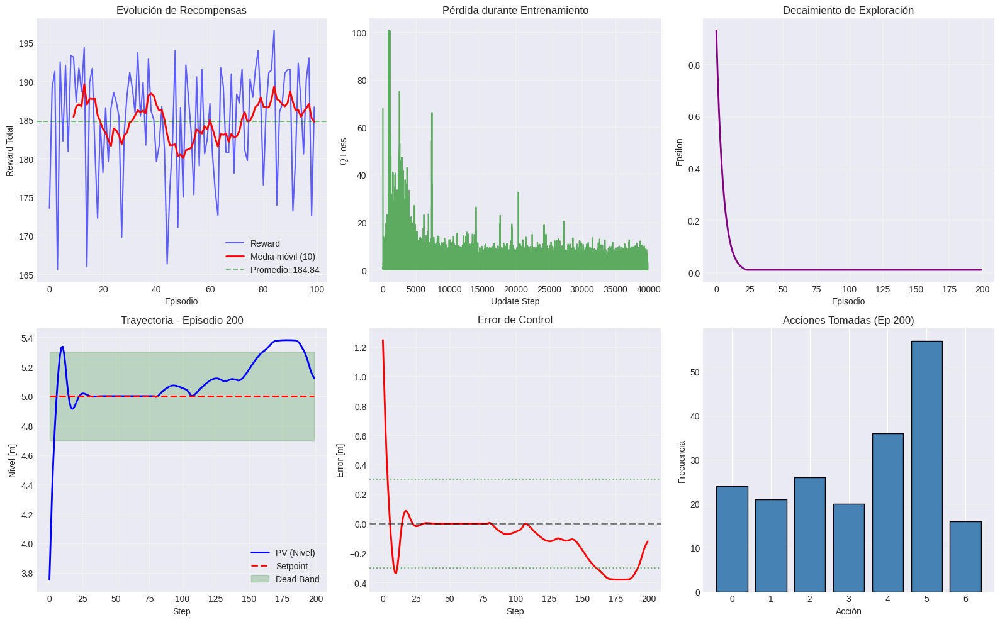


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       184
  Tasa de éxito:            92.00%
  Reward promedio (global): 184.84
  Error estado estacionario: 0.1055

  Últimos 10 episodios:
    Reward promedio:        184.75
    Desviación estándar:    7.30

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_likely-sweep-72.pth

✅ Run completado: likely-sweep-72
   Reward promedio: 184.84
   Tasa de éxito: 92.00%


avg_episode_reward,█▅▅▄▃▂▂▂▂▁▂▁▁▂▂▂▁▁▂▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃
episode,▁▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇███
episode_reward,▇▄▄▇▂▆▆▅▂▁▅▂▅▅▂▇▄▆▇▂▇▁██▆▇▁▃▆▅▇▅▇▅▄▆▇▇▆▄
epsilon,█▇▆▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▄▂▄▃▂▃▂▂▁▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁
steady_state_error,▂▃▁▂▂▃▁▂▃▃▁▂▂▂▃▁▁▂▇▄▃▁▁▂▁▃▁▃▁▁▁▁▂▁▂▁▃█▂▁
success_rate,█▃▁▁▂▃▃▃▄▄▄▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅
+1,...


wandb: Agent Starting Run: 956hxudr with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  191.98 | Avg:  191.98 | ε: 0.872 | 

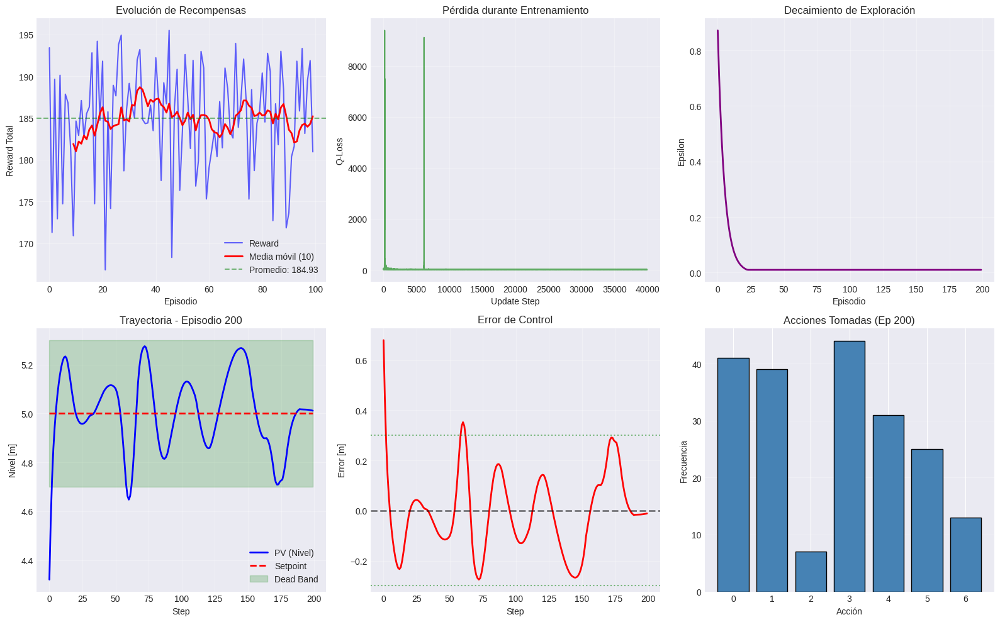


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       180
  Tasa de éxito:            90.00%
  Reward promedio (global): 184.93
  Error estado estacionario: 0.1256

  Últimos 10 episodios:
    Reward promedio:        185.19
    Desviación estándar:    6.04

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_vibrant-sweep-73.pth

✅ Run completado: vibrant-sweep-73
   Reward promedio: 184.93
   Tasa de éxito: 90.00%


avg_episode_reward,█▄▃▅▃▂▂▂▂▂▁▂▂▂▂▂▂▂▃▃▂▂▂▂▂▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁
episode,▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇█
episode_reward,▆▅▃▆▇▆▅▄▅▃▆▄▂▅▅█▅▁▅▄▆▇▇▂▆▅▇▅▃▅▇▃▇▄▄▆▂▅▇▁
epsilon,█▅▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▇▂▂▂▂▃▃▆▁▁▁▂▂▁▂▂▂▂▂▂▁▁▂▂▁▁▂▂▂▂▂▁▁▂▁▁▁▂▂
steady_state_error,▂▂▂▁▁▅▁▂▂▁█▁▁▁▄▄▂▂▁▁▂▂▂▂▁▃▁▃▂▃▁▁▁▁▁▁▃▇▁▁
success_rate,██▅▄▅▅▃▂▃▁▂▂▂▂▂▂▂▂▃▃▃▃▃▂▂▂▂▂▃▂▂▂▂▂▂▁▂▂▁▁
+1,...


wandb: Agent Starting Run: mbc53prd with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.25 | Avg:  189.25 | ε: 0.872 | Succ

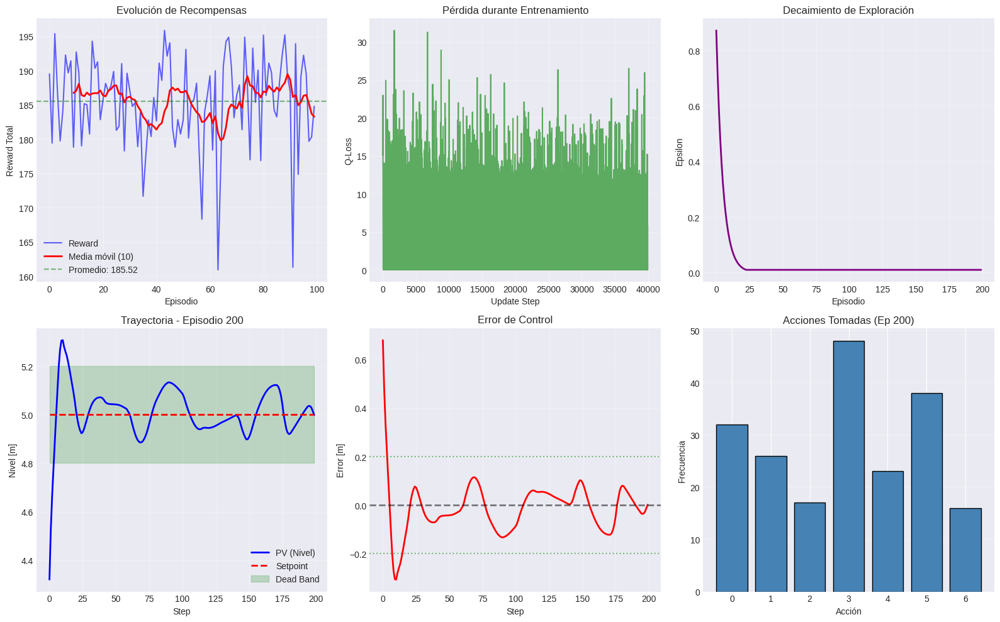


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       168
  Tasa de éxito:            84.00%
  Reward promedio (global): 185.52
  Error estado estacionario: 0.0974

  Últimos 10 episodios:
    Reward promedio:        183.26
    Desviación estándar:    9.25

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_visionary-sweep-74.pth

✅ Run completado: visionary-sweep-74
   Reward promedio: 185.52
   Tasa de éxito: 84.00%


avg_episode_reward,▇▆▃▄▄▄▄▅▃▂▂▁▁▁▁▁▂▂▂▃▃▃▃▃▄▅▅▅▅▅▄▅▆▇▇▇▇███
episode,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▆▆▆▆▆▇▇▇▇▇▇████
episode_reward,▆▆▇▅▁▅▁▇▆▂▆▅▃▅▄▇▄▆▇▅▆▇▆▄▅▅▅▆█▅▆▅▆█▇▃▇▇█▅
epsilon,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▆▆▇▆█▅▆▆▅▄▅▄▅▃▅▄▅▃▇▅▇▅▅▃▄▄▆▄▄▁▃▃▆▅▄▅▅▄▅▃
steady_state_error,▁▂▂▁▁▁▁▂▁▁▁▁▁▁▂▃▁▁▁▁▁▁▂▁▁▁▁▂▁▂▃▁▅▁▂▂▁█▁▁
success_rate,▁▅▆█▇█▆▇▇█▇▇▇▇▆▆▆▇▇▇▇███████████████████
+1,...


wandb: Agent Starting Run: h77rzzkg with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.52 | Avg:  186.52 | ε: 0.480 | Succe

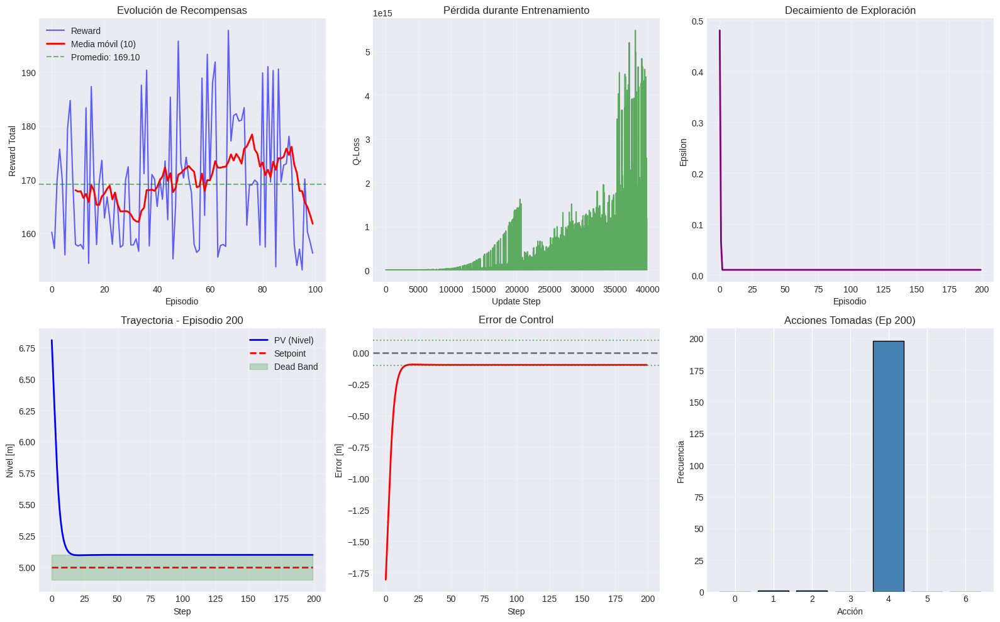


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       153
  Tasa de éxito:            76.50%
  Reward promedio (global): 169.10
  Error estado estacionario: 0.1123

  Últimos 10 episodios:
    Reward promedio:        161.74
    Desviación estándar:    8.16

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_golden-sweep-75.pth

✅ Run completado: golden-sweep-75
   Reward promedio: 169.10
   Tasa de éxito: 76.50%


avg_episode_reward,▄▅▆▇▇████▇▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▂▂▂▁▁▁▁▁▁▁▂▁▁▂▁
episode,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████
episode_reward,▆▅▆▆██▇█▇█▇▄▆▁▃▄▄▁▃▁▁▅▄▁▆▁▁▁▇▄▂▃▄▄▁▇▆▇▇▂
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▃▃▃▄▃▄▄▄▅▅▆▇▆▆█
steady_state_error,▁▁▁▁▁▁▁▁▂▁▁█▇▇▇▇▆█▇▇▇▇▇▇▇██▇▇▆██▇▇▁▄█▇█▇
success_rate,█▁▃▃▆▆▆▇▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: ut8nku83 with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  191.60 | Avg:  191.60 | ε: 0.844 | 

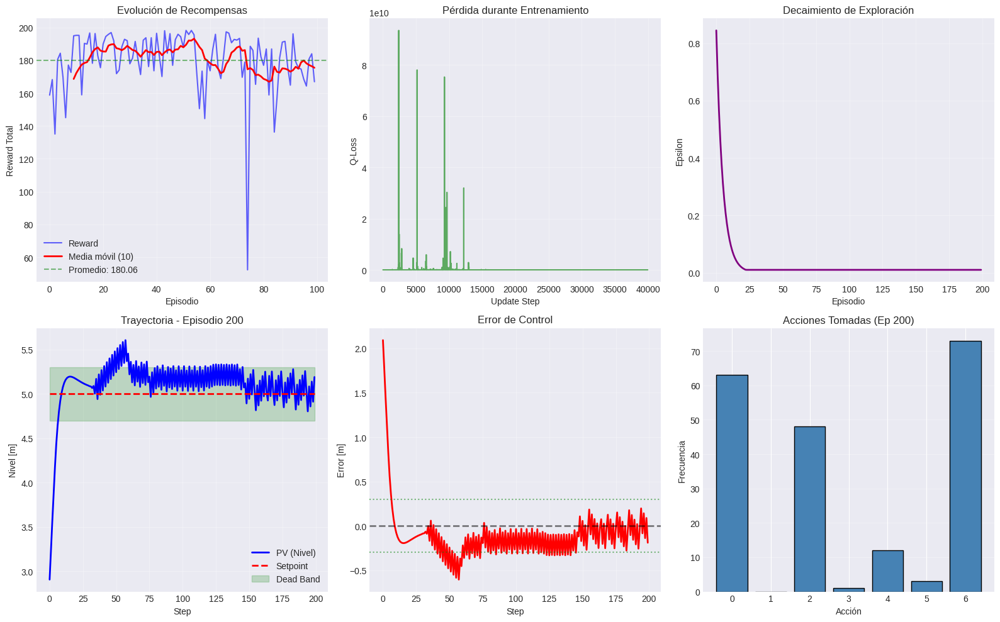


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       161
  Tasa de éxito:            80.50%
  Reward promedio (global): 180.06
  Error estado estacionario: 0.2089

  Últimos 10 episodios:
    Reward promedio:        175.44
    Desviación estándar:    9.47

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_trim-sweep-76.pth

✅ Run completado: trim-sweep-76
   Reward promedio: 180.06
   Tasa de éxito: 80.50%


avg_episode_reward,███▁▁▂▃▃▃▃▄▄▃▃▃▃▃▄▄▄▄▄▃▃▃▃▄▄▄▄▄▄▄▄▅▄▄▄▄▄
episode,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇█████
episode_reward,█▁▇█▇▇██▇█████▇██▇█▇▇███████▇█▇██▃██▇▇█▇
epsilon,█▄▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁█▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▂▄▂▁▁▂▁▂▁▁▂▅▃▁▂▁▁▃▂▂█▂▅▁▁▁▁▁▂▁▁▂▁▁▆▂▁▁▃
success_rate,█▅▁▁▂▄▄▄▄▄▄▄▄▃▄▃▄▄▄▃▃▃▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▄▄
+1,...


wandb: Agent Starting Run: s3gafl34 with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  191.86 | Avg:  191.86 | ε: 0.872 |

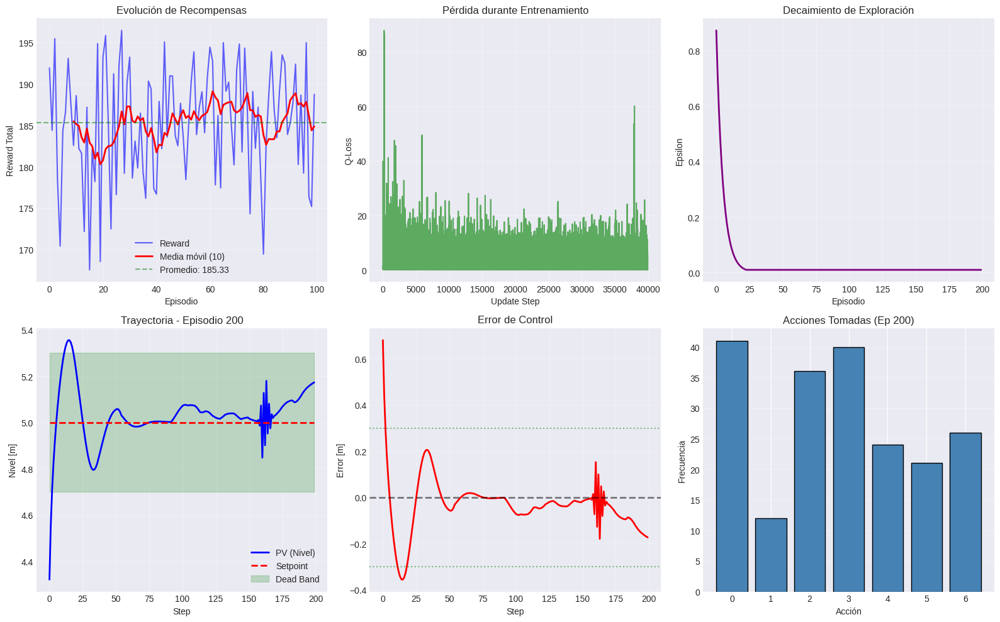


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       183
  Tasa de éxito:            91.50%
  Reward promedio (global): 185.33
  Error estado estacionario: 0.1391

  Últimos 10 episodios:
    Reward promedio:        184.86
    Desviación estándar:    6.44

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_easy-sweep-77.pth

✅ Run completado: easy-sweep-77
   Reward promedio: 185.33
   Tasa de éxito: 91.50%


avg_episode_reward,█▆▆▆▇▃▃▃▂▂▁▁▁▁▁▁▂▂▂▁▂▁▂▂▁▂▂▂▂▂▂▂▂▂▂▂▃▂▃▃
episode,▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇▇██
episode_reward,▅▆▇▆▃▂▅█▇▃▄▇▇▅▅▅▆▅▆▆█▇▇█▆▄█▃▄▃▄▇▆█▇█▃▁▆▄
epsilon,█▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▇▅█▆▂▃▃▂▁▂▃▂▄▂▂▂▃▃▃▂▂▂▃▁▃▃▃▃▂▂▂▃▂▂▂▂▂▂▁▂
steady_state_error,▁▂▁▁▂▂▁▁▃▁▃▁▂▁▂▁▁▁▂▁▂▃▂▁▁▅▁▂▃▅▁▃▂▁▁█▁▁▃▄
success_rate,█████▄▅▅▆▆▄▅▅▅▄▅▅▅▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▁
+1,...


wandb: Agent Starting Run: rf6h7m2g with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  187.60 | Avg:  187.60 | ε: 0.844 | Succe

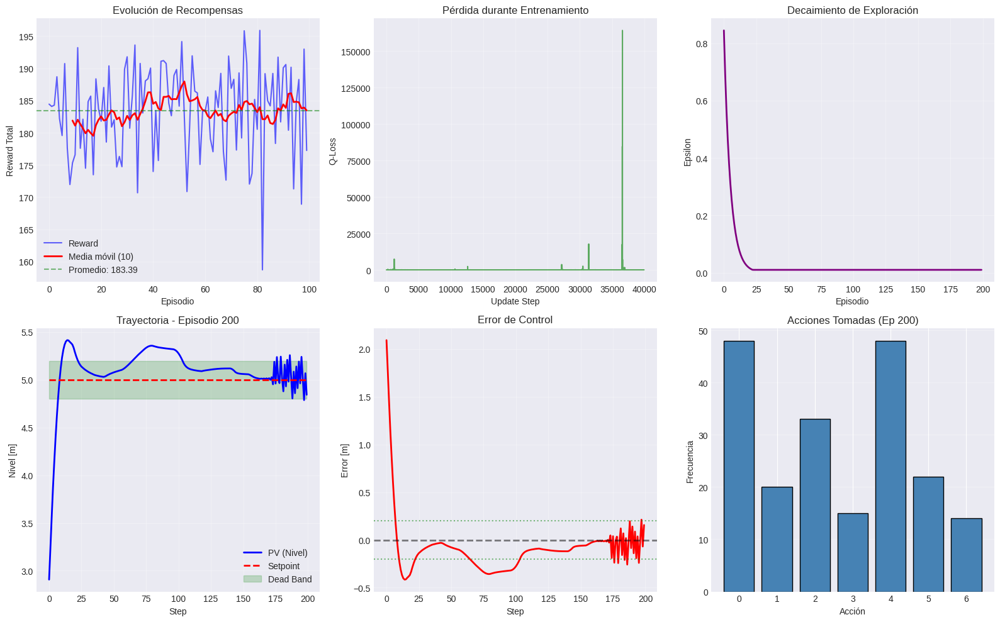


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       172
  Tasa de éxito:            86.00%
  Reward promedio (global): 183.39
  Error estado estacionario: 0.1301

  Últimos 10 episodios:
    Reward promedio:        183.46
    Desviación estándar:    8.14

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_cosmic-sweep-78.pth

✅ Run completado: cosmic-sweep-78
   Reward promedio: 183.39
   Tasa de éxito: 86.00%


avg_episode_reward,█▅▅▅▃▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
episode,▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇█
episode_reward,▇▇▅▆▇▆▆▆▅█▅▆▄▇▅▆▇▄▇▄▄▇▆▅▅▅▅▇▃▇▇▆█▃▇█▁▆▅▄
epsilon,█▆▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▂▂▁▁▂▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁█▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▁▁▁▂▃▁▂▁▁█▁▂▂▂▁▂▂▂▁▁▁▁▁▁▁▃▃▇▁▂▁▂▁▁▂▁▁▁▁
success_rate,▁▃▆▇▆▅▆▅▅▇▅▅▅▆▆▆▇▇▇█▇██▇▇▇▇▇▆▆▆▆▆▆▆▆▅▅▅▅
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: nnlnepnj with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.37 | Avg:  189.37 | ε: 0.930 | 

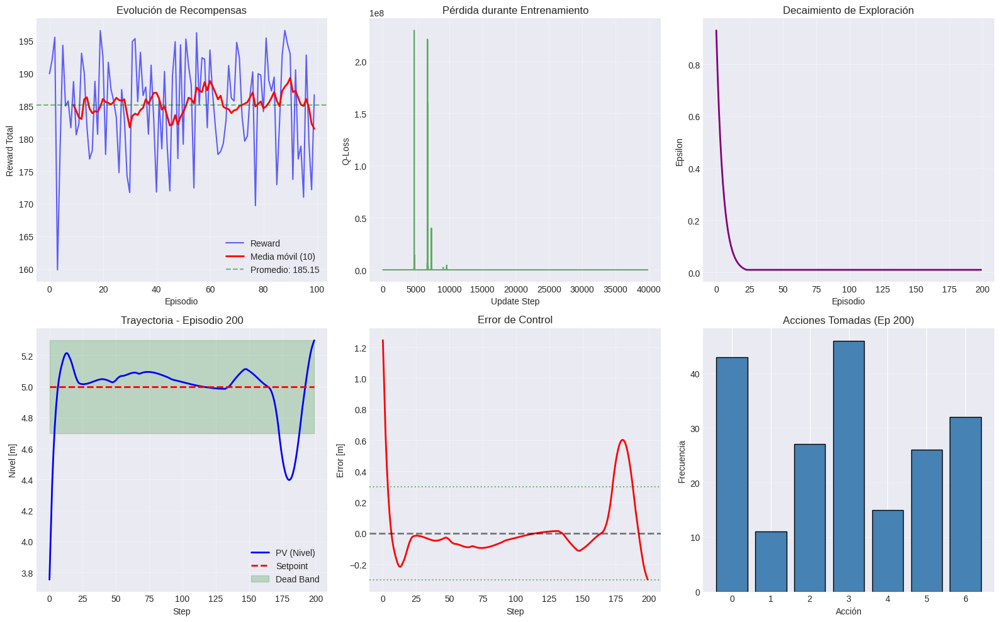


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       174
  Tasa de éxito:            87.00%
  Reward promedio (global): 185.15
  Error estado estacionario: 0.1153

  Últimos 10 episodios:
    Reward promedio:        181.50
    Desviación estándar:    8.12

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_curious-sweep-79.pth

✅ Run completado: curious-sweep-79
   Reward promedio: 185.15
   Tasa de éxito: 87.00%


avg_episode_reward,█▇▅▅▅▄▃▃▃▂▂▂▂▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▅▄▅▄▄▄▄
episode,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▆▆▆▆▇▇▇▇▇▇████
episode_reward,▆█▅▆▂▄▅▄▃▁▃▁▂▄▇▅▆█▇███▄▇▆▆▃▄█▆█▆▇▆█▁▇▇▃▂
epsilon,█▆▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▂▁▁▁▃█▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▁▁▁▂▁▃▁█▃▁▂▁▁▄▁▁▂▂▂▂▁▁▂▁▂▁▄▃▂▂▁▁▂▄▁▂▁▁▁
success_rate,████▆▃▃▃▃▃▂▂▁▁▂▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅
+1,...


wandb: Agent Starting Run: pu8dk6hv with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.52 | Avg:  186.52 | ε: 0.480 | Succe

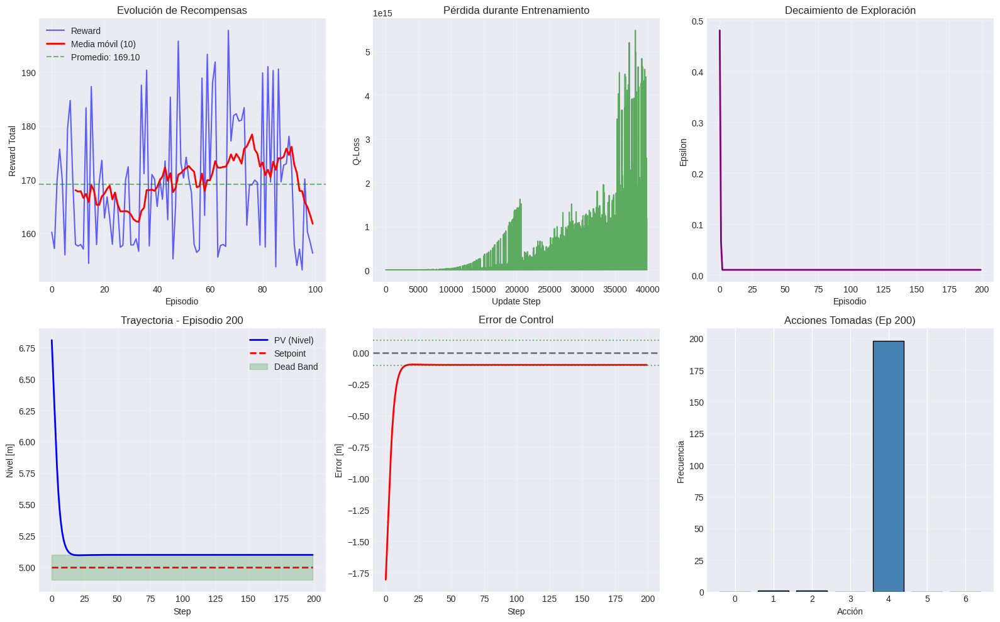


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       153
  Tasa de éxito:            76.50%
  Reward promedio (global): 169.10
  Error estado estacionario: 0.1123

  Últimos 10 episodios:
    Reward promedio:        161.74
    Desviación estándar:    8.16

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_apricot-sweep-80.pth

✅ Run completado: apricot-sweep-80
   Reward promedio: 169.10
   Tasa de éxito: 76.50%


avg_episode_reward,▆▆▆▄▅▇▇████▆▆▆▅▅▅▄▄▄▄▄▄▄▃▂▂▂▁▁▁▁▁▁▁▁▂▂▂▁
episode,▁▁▁▂▂▂▂▂▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
episode_reward,▆▇▇█▇▇▇▇█▇▄▃▄▂▅▂▂▂▆▂▂▃▃▄▂▄▄▃▄▄▂▆▁▆▃▂▇▇▁▁
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▄▄▅▆▅▆▇▆▆█
steady_state_error,▁▁▁▁▁▁▁▁▅▇▆▇▆▆▅▇█▇▆▆▆▆▆█▆▇▆▆▅▆▇▆▇▆▇▆▄▄▃▆
success_rate,██▂▄▆▆▅▄▄▄▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁
+1,...


wandb: Agent Starting Run: dj4cts9v with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  190.42 | Avg:  190.42 | ε: 0.872 |

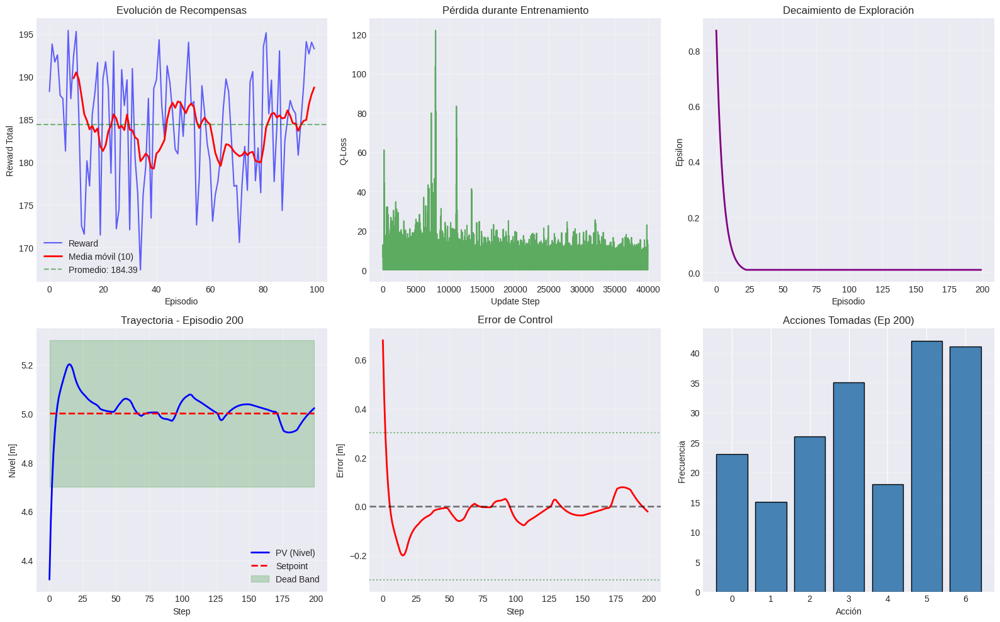


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       184
  Tasa de éxito:            92.00%
  Reward promedio (global): 184.39
  Error estado estacionario: 0.1437

  Últimos 10 episodios:
    Reward promedio:        188.73
    Desviación estándar:    4.36

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_lyric-sweep-81.pth

✅ Run completado: lyric-sweep-81
   Reward promedio: 184.39
   Tasa de éxito: 92.00%


avg_episode_reward,█▆▆▇▇▆▇▆▆▅▅▄▄▄▃▃▃▃▃▄▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁
episode,▁▂▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇██
episode_reward,▅▃▆█▅▆▆▄▁▂▃▅▅▇▇▆▄▃▃▆█▅▁▃▁▆▆▅▄▅▁▆▂▂▄▇▆▃▂▅
epsilon,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▆▇▆█▆▆▆▅▅▅▂▅▄▃▂▄▃▂▄▅▄▃▁▃▄▄▃▅▃▂▁▃▃▂▄▂▃▂▁▂
steady_state_error,▂▂▁▁▂▄▃▁▂▁▁▁▁▃▂▁▂▂▁▂▃▁▆▁▃▁▁▂▂█▁▁▁▁▁▂▁▁▂▁
success_rate,█████▁▂▂▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▄▄▄▃▃▃▃▃▃▃▂▃▃▃▂▂▃
+1,...


wandb: Agent Starting Run: obgoy1xf with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.995
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.995)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  191.52 | Avg:  191.52 | ε: 0.694 | 

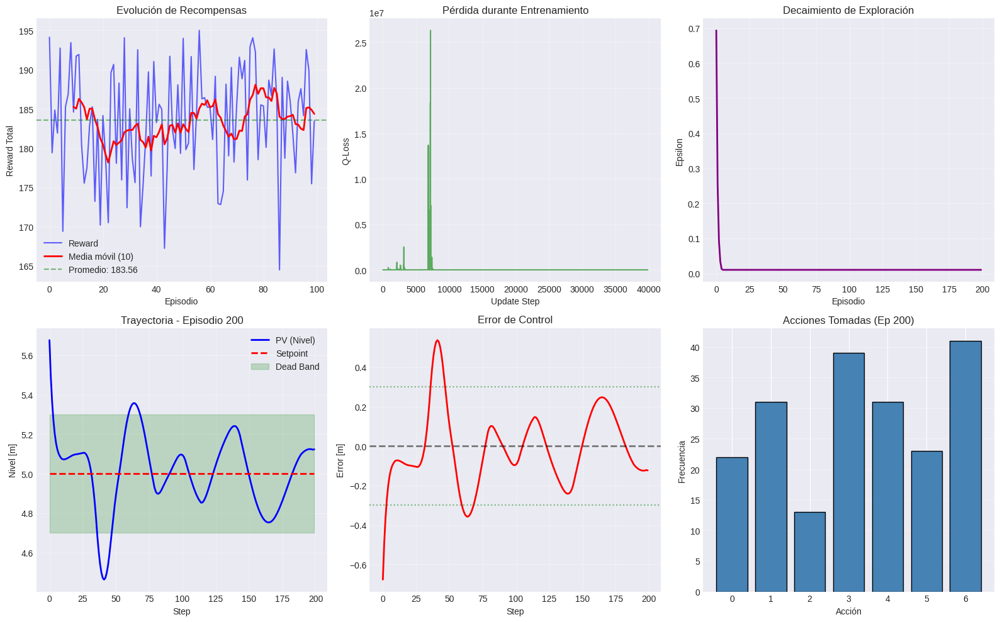


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       181
  Tasa de éxito:            90.50%
  Reward promedio (global): 183.56
  Error estado estacionario: 0.1186

  Últimos 10 episodios:
    Reward promedio:        184.36
    Desviación estándar:    5.06

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_giddy-sweep-82.pth

✅ Run completado: giddy-sweep-82
   Reward promedio: 183.56
   Tasa de éxito: 90.50%


avg_episode_reward,███▅▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▃▂▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁
episode,▁▁▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▆▆▆▆▆▆▆▇▇▇▇▇███
episode_reward,▆▃▂▃▇▇▄▇▂▆▃▃▂▃▅▂▅▄▃█▅▅▄▂▆▄▇▃▁▄▆▇█▅▆▇█▅▆▁
epsilon,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▂▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▁▂▇▁▇▂▄▃▁▁█▁▄▂▂▁▂▂▂▅▂▁▂▁▄▁▂▄▁▁▁▂▁▁▂▁▂▂▂
success_rate,██▅▁▁▂▂▂▂▂▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄
+1,...


wandb: Agent Starting Run: d16f0qw8 with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  191.86 | Avg:  191.86 | ε: 0.872 |

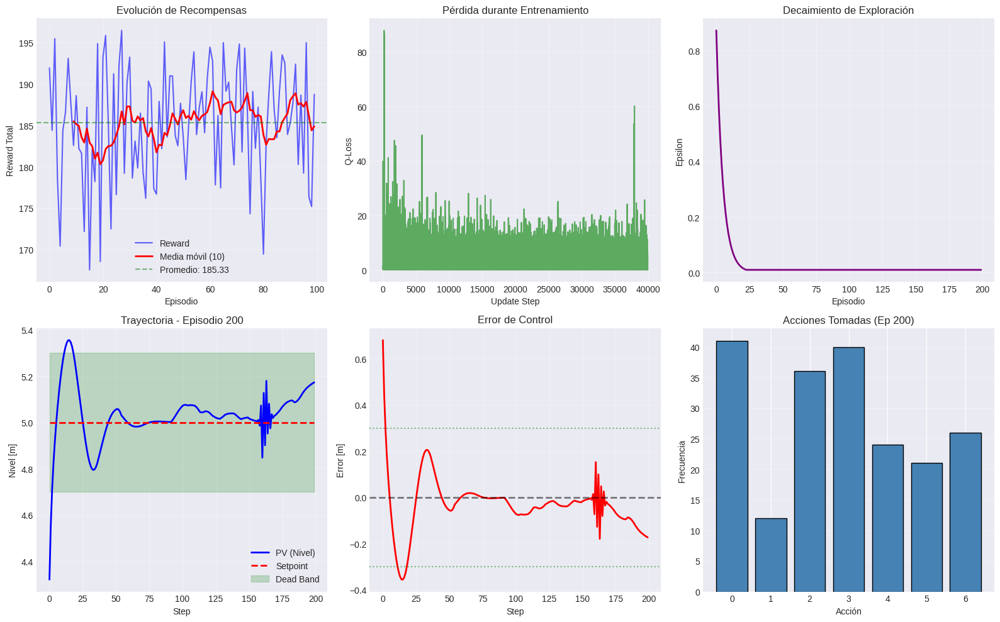


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       183
  Tasa de éxito:            91.50%
  Reward promedio (global): 185.33
  Error estado estacionario: 0.1391

  Últimos 10 episodios:
    Reward promedio:        184.86
    Desviación estándar:    6.44

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_driven-sweep-83.pth

✅ Run completado: driven-sweep-83
   Reward promedio: 185.33
   Tasa de éxito: 91.50%


avg_episode_reward,█▅▆▆▆▃▃▁▂▂▁▂▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▁▂▂▂▁▂▂▂▂▂▂▂▂
episode,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
episode_reward,▇▆▇▅▃▃█▇▄▅▇▇▅▅▁▇▆▅▇▇▅▂▅▄▁▅▆▃▆▅▅▅▇▅▇▆▅▆▆▄
epsilon,█▅▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▆▅▇▃▁▄▁▂▃▃▃▂▃▂▂▁▃▂▂▂▂▂▁▄▂▂▂▂▃▂▃▃▃▂▂▃▃▁▃
steady_state_error,▁▁▂▂▂▁▃▂▁▁▂▃▃▁▂▁▁▁▂▂▂▁▂▂▁▁▃▁▂▁▁▃▁▁▁█▁▁▁▁
success_rate,███▄▅▆▆▆▆▅▅▅▅▅▅▆▆▆▆▆▅▅▅▅▄▃▄▃▃▃▃▃▃▃▂▂▂▂▂▁
+1,...


wandb: Agent Starting Run: 8x393oc8 with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.73 | Avg:  189.73 | ε: 0.872 | 

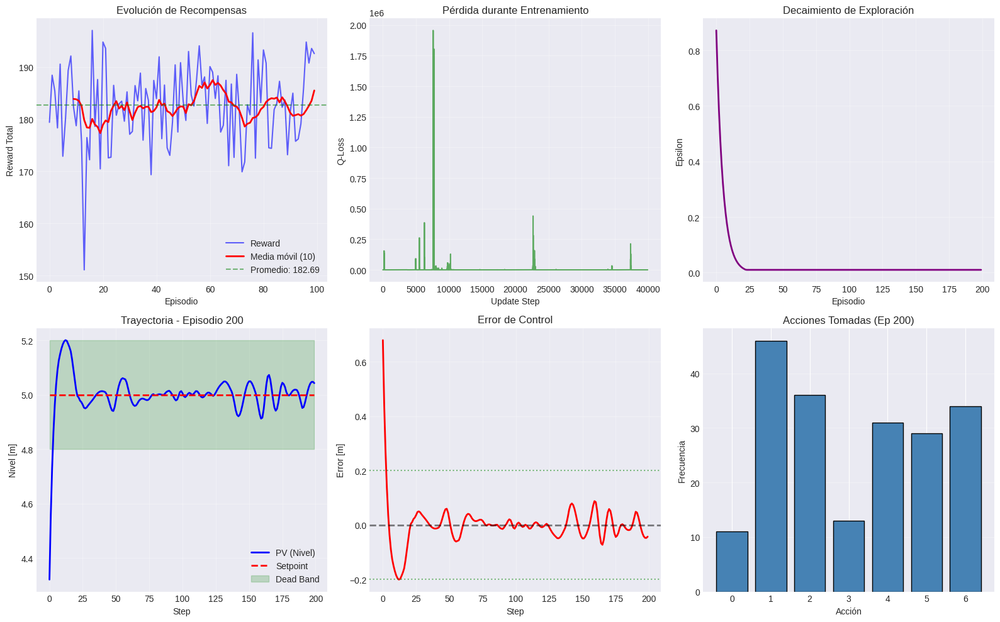


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       158
  Tasa de éxito:            79.00%
  Reward promedio (global): 182.69
  Error estado estacionario: 0.1747

  Últimos 10 episodios:
    Reward promedio:        185.52
    Desviación estándar:    6.85

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_lemon-sweep-84.pth

✅ Run completado: lemon-sweep-84
   Reward promedio: 182.69
   Tasa de éxito: 79.00%


avg_episode_reward,▇█▆▇▆▅▄▄▃▂▂▂▂▂▂▂▂▃▂▂▂▂▂▂▂▁▁▁▁▂▂▂▁▂▂▁▁▁▁▁
episode,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▄▄▅▆▆▆▆▆▆▇▇▇█████
episode_reward,▅▄▆▃▅▂▄▄▃▂▇▆▃▂▆█▄▅▄▄▃▁▂▄▅▃▁▅▂▄▅▆▃▆▅▄▇▄▆█
epsilon,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▂▁▂▃▂▆▁▁▁▁▂▃▃▁▁▁▂▂▃▂▂▁▆▂█▃▁▃▁▁▁▁▃▂▁▁▁▅▁
success_rate,█▅▅▄▅▂▂▃▃▃▂▃▂▃▃▃▃▃▃▃▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂
+1,...


wandb: Agent Starting Run: ue1x6a4b with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.63 | Avg:  185.63 | ε: 0.480 | Succ

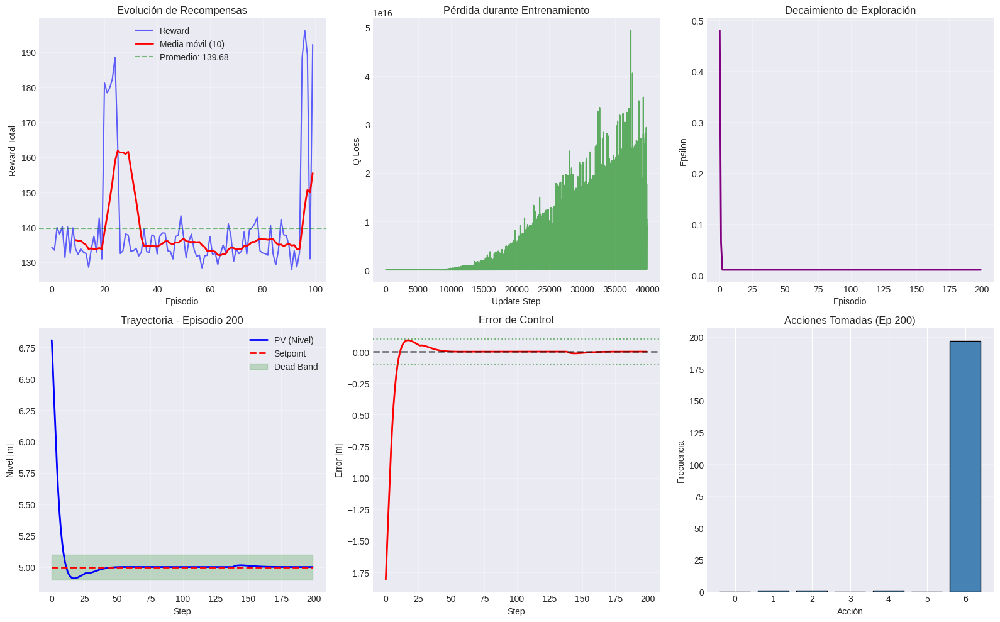


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       27
  Tasa de éxito:            13.50%
  Reward promedio (global): 139.68
  Error estado estacionario: 1.0390

  Últimos 10 episodios:
    Reward promedio:        155.42
    Desviación estándar:    29.57

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_elated-sweep-85.pth

✅ Run completado: elated-sweep-85
   Reward promedio: 139.68
   Tasa de éxito: 13.50%


avg_episode_reward,███▆▆▆▆▅▅▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
episode,▁▁▁▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇██
episode_reward,▆█▅▃▂▁▃▂▂▂▂▁▂▂▁▁▁▂▂▂▂▁▂▆█▁▁▂▁▁▂▁▁▁▂▁▂▁▁█
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▃▃▃▃▄▄▅▄▅▅▅▆█▇██▇█▇
steady_state_error,▂▁▂▂▇███▇▇▇█▆████████▇█▇█▇▇▇▇▇███▇▇█▇▇▄▁
success_rate,▇█▆▆▆▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: twf8ru76 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.33 | Avg:  189.33 | ε: 0.480 | Suc

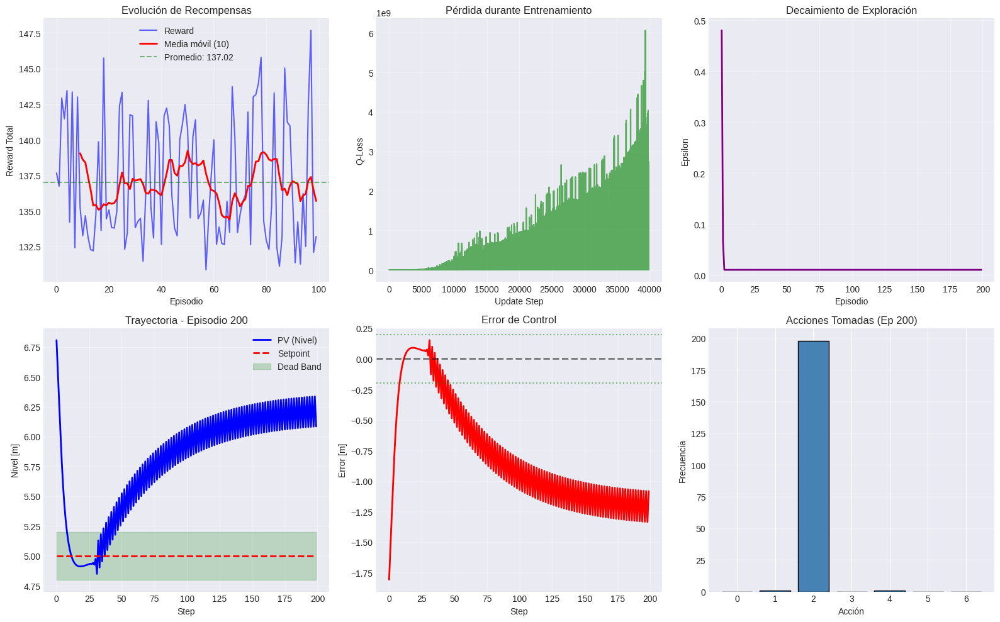


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       21
  Tasa de éxito:            10.50%
  Reward promedio (global): 137.02
  Error estado estacionario: 1.1324

  Últimos 10 episodios:
    Reward promedio:        135.69
    Desviación estándar:    5.09

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_dark-sweep-86.pth

✅ Run completado: dark-sweep-86
   Reward promedio: 137.02
   Tasa de éxito: 10.50%


avg_episode_reward,▇██▇▇▆▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
episode,▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇████
episode_reward,██▇▆▅▂▂▃▁▁▂▁▁▂▃▂▁▁▁▁▂▁▁▁▁▂▂▁▁▂▂▂▁▂▂▂▁▁▁▁
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▆▅▆▆▆▇▇▇█
steady_state_error,▁▁▇██▇█▇▇▇▇▇██▇▆█▄▇▇█▇█▇▇▇██████▇▇▇█▇█▇▇
success_rate,███▇▆▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Agent Starting Run: xm4trv2a with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.52 | Avg:  186.52 | ε: 0.480 | Succe

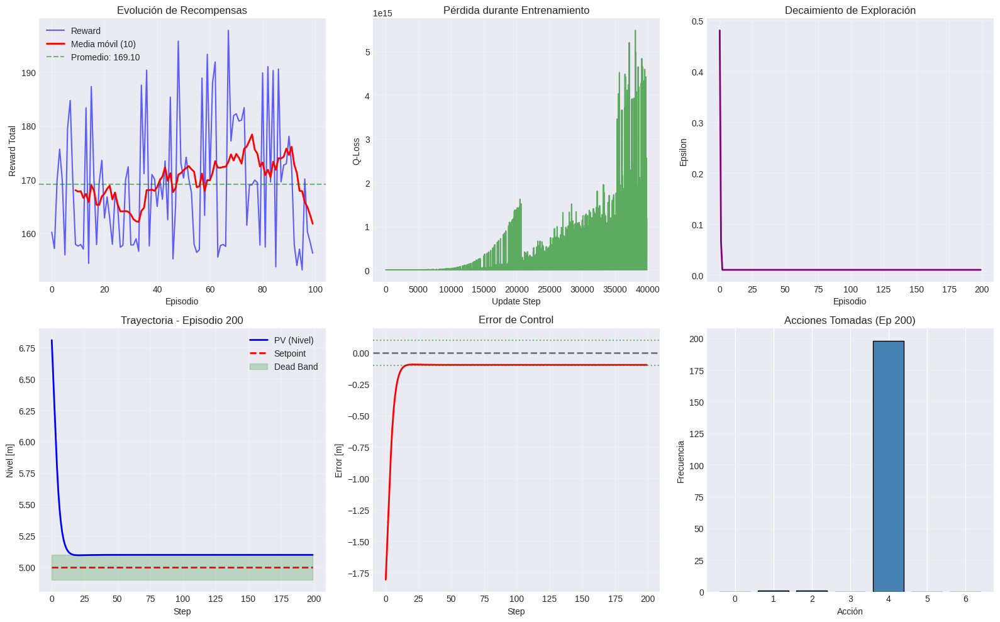


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       153
  Tasa de éxito:            76.50%
  Reward promedio (global): 169.10
  Error estado estacionario: 0.1123

  Últimos 10 episodios:
    Reward promedio:        161.74
    Desviación estándar:    8.16

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_morning-sweep-87.pth

✅ Run completado: morning-sweep-87
   Reward promedio: 169.10
   Tasa de éxito: 76.50%


avg_episode_reward,▆▆███████▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▂▁▁▁▁▁▁▁▁▁▁▂▂▁▁
episode,▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▄▅▆▆▆▇▇▇▇▇▇▇▇████
episode_reward,▆▆▆███▇█▇▄▆▃▃▄▇▃▄▃▆▂▄▃▂▂▃▄▆▁█▄▂▆▅▂▃▄▅▄▁▄
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▆▅▅▅▆▇▆██
steady_state_error,▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂█▂▂▁▂
success_rate,██▅▆▆▆▆▆▇▇▆▅▅▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
+1,...


wandb: Agent Starting Run: 64p0eyxo with config:
wandb: 	batch_size: 32
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  182.01 | Avg:  182.01 | ε: 0.844 |

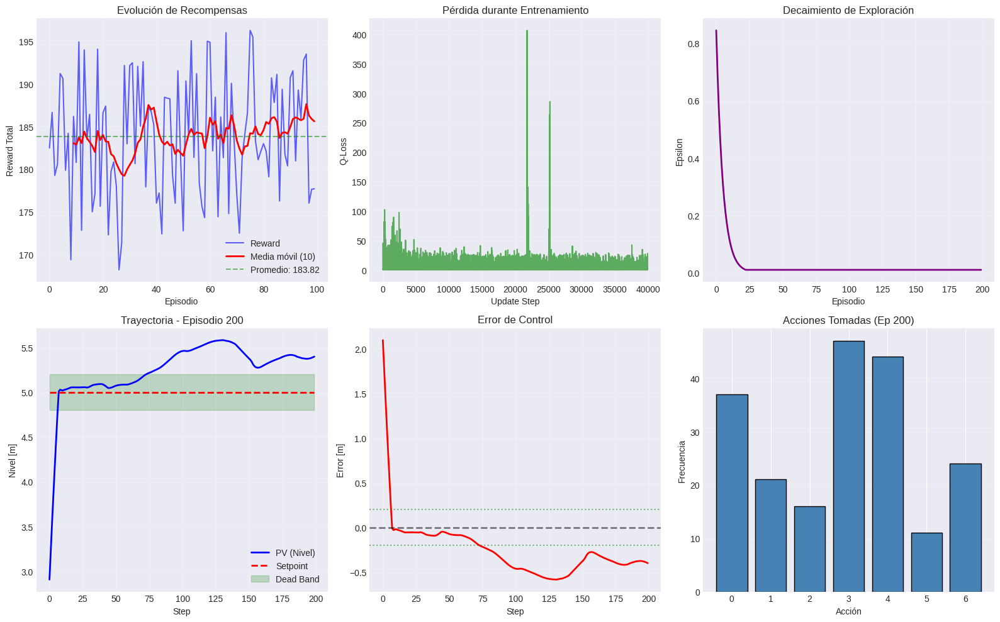


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       159
  Tasa de éxito:            79.50%
  Reward promedio (global): 183.82
  Error estado estacionario: 0.1329

  Últimos 10 episodios:
    Reward promedio:        185.60
    Desviación estándar:    6.55

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39969

💾 Agente guardado en: models/pid_dqn_serene-sweep-88.pth

✅ Run completado: serene-sweep-88
   Reward promedio: 183.82
   Tasa de éxito: 79.50%


avg_episode_reward,█▇▅▂▂▂▃▃▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▂▂▂▂▂
episode,▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇████
episode_reward,▆▄▆▅▇▅▅▄▄▃▂▇▇█▂▆▄▁▆▃▂▄▁▂▇▆▃▇▃█▃▂▅▆█▄▅▇▄▃
epsilon,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁█▄▆▆▅▁▅▁▁▃▂▃▂▄▂▁▂▂▂▃▂▂▃▁▇▂▄▁▁▂▃▁▂▂▁▂▁▂▂
steady_state_error,▁▂▃▂▃▁▁▂▁▁▂▂▂▂▁▁▃▁▁▂▂▅▁▁▁▁▁▆▁█▄▁▁▂▂▁▃▁▂▄
success_rate,█▂▄▁▅▆▇▇▄▄▅▅▅▄▄▃▄▄▄▅▄▄▃▄▄▃▃▂▁▁▁▂▁▁▁▂▁▁▁▁
+1,...


wandb: Agent Starting Run: ts8jpjsn with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.37 | Avg:  189.37 | ε: 0.930 | 

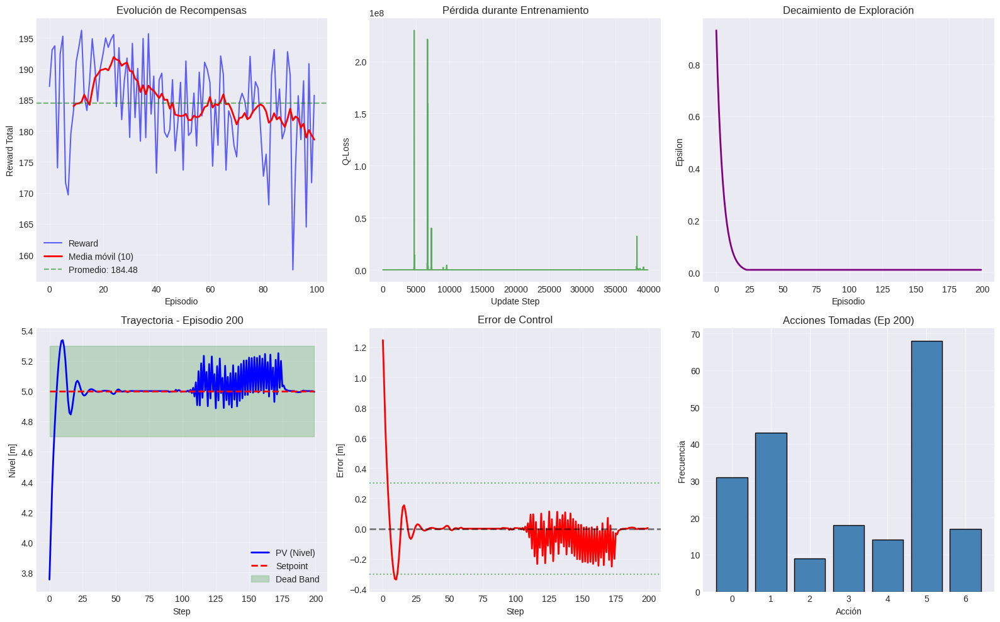


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       164
  Tasa de éxito:            82.00%
  Reward promedio (global): 184.48
  Error estado estacionario: 0.1311

  Últimos 10 episodios:
    Reward promedio:        178.59
    Desviación estándar:    10.76

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_swift-sweep-89.pth

✅ Run completado: swift-sweep-89
   Reward promedio: 184.48
   Tasa de éxito: 82.00%


avg_episode_reward,▇█▅▄▃▂▂▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▄▄▄▄▄▄▄
episode,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇█████
episode_reward,█▁▂▃▅▅▃▆▃▄▅▃▄▅▆▆▄▆▆▅▄▄▄▅▇▇▁█▆█▆▃▄▅▇▅▅▆▃▆
epsilon,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁█▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂
steady_state_error,▂▁▂▂▁▇▂▁▂▁█▁▅▂▁▁▂▂▂▂▁▁▁▁▃▁▃▁▃▂▃▁▁▂▁▁▁▂▃▁
success_rate,███▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▄▄▄▄▄▄▄▄▄▃▃▄
+1,...


wandb: Agent Starting Run: 2ti2h2fb with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.37 | Avg:  189.37 | ε: 0.930 |

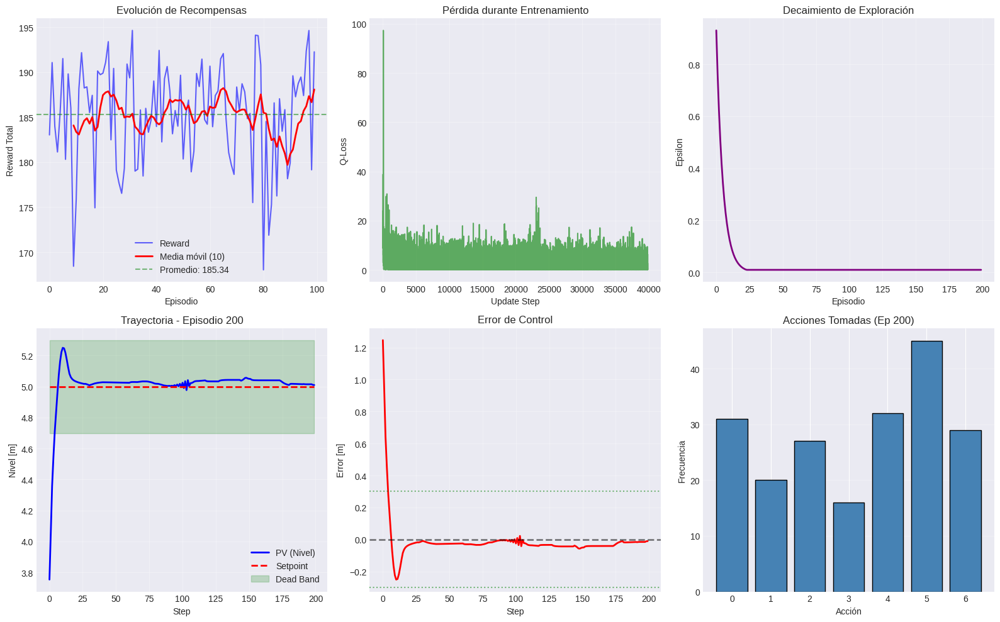


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       185
  Tasa de éxito:            92.50%
  Reward promedio (global): 185.34
  Error estado estacionario: 0.0842

  Últimos 10 episodios:
    Reward promedio:        188.09
    Desviación estándar:    4.80

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_pretty-sweep-90.pth

✅ Run completado: pretty-sweep-90
   Reward promedio: 185.34
   Tasa de éxito: 92.50%


avg_episode_reward,█▃▃▃▁▂▂▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▃▃▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃
episode,▁▁▁▂▂▂▂▂▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇████
episode_reward,▇▆▂▄█▅▆▄▇▄██▇▆▇▆▇▇▇▇▆▅▆▇▇▆▃█▆▆▇▇▆▇▆▆▁▃▆▄
epsilon,█▅▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▆█▅▄▅▃▃▃▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▄▂▂▂▂▂▂▁▂▁▁▂▂▂▁▂
steady_state_error,▂▁▁▃▄▂▇▁▁▁▁▁▇▁▂▅▁▂▁▂▂▁▂▂▂▃▁█▁▁▁▁▁▁▁▃▃▅▂▁
success_rate,██▅▅▃▁▁▂▂▂▂▂▂▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▄▄
+1,...


wandb: Agent Starting Run: 1y3xnar6 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.58 | Avg:  185.58 | ε: 0.930 | 

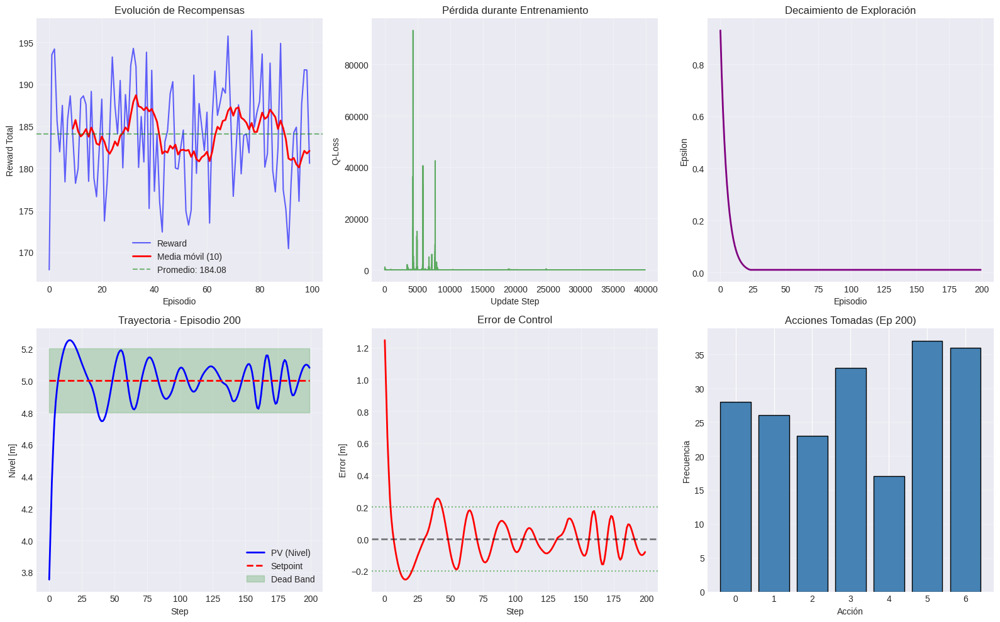


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       163
  Tasa de éxito:            81.50%
  Reward promedio (global): 184.08
  Error estado estacionario: 0.0978

  Últimos 10 episodios:
    Reward promedio:        182.05
    Desviación estándar:    6.82

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_faithful-sweep-91.pth

✅ Run completado: faithful-sweep-91
   Reward promedio: 184.08
   Tasa de éxito: 81.50%


avg_episode_reward,██▇▇█▄▃▂▂▁▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▃▃▃▂▂▂▃▂▂▂▂▃▃▃▂
episode,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇████
episode_reward,▆▆▅▅▃▅▆▆▁▆▆▇▄▃▄▃▇▆▃▆▆▃▆▇▄▄▃▂▄▆▅▇▄▅▇▆█▃▂▆
epsilon,█▆▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▂▁▂▁▁█▆▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▂▁▁▁▃▄▃▂▂▂▂▁▁▁▃▃▂▁▃▃▁▂▁▂▂▂▁▁▁▁▁█▁▁▁▁▂▁▁▂
success_rate,█████▁▂▂▂▂▂▁▁▁▂▂▁▂▂▂▂▂▂▂▂▂▂▃▃▃▂▂▂▂▂▂▁▁▁▂
+1,...


wandb: Agent Starting Run: 7rq3gn9e with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.82 | Avg:  189.82 | ε: 0.480 | Succe

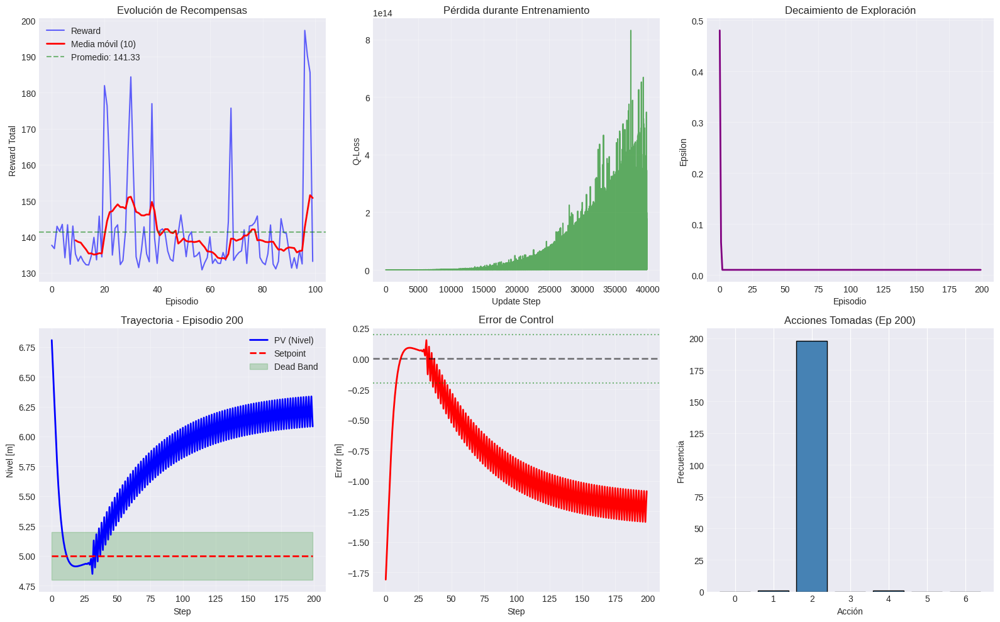


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       14
  Tasa de éxito:            7.00%
  Reward promedio (global): 141.33
  Error estado estacionario: 1.0572

  Últimos 10 episodios:
    Reward promedio:        150.77
    Desviación estándar:    26.51

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_whole-sweep-92.pth

✅ Run completado: whole-sweep-92
   Reward promedio: 141.33
   Tasa de éxito: 7.00%


avg_episode_reward,█▅▄▄▄▃▂▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▁▁▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂
episode,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇██
episode_reward,▁▃▁▂▂▁▇█▃▃▃█▂▁▁▂▂▁▂▁▁▂▁▁▂▅▃▂▂▁▂▁▁▇▂▁▃▂▁▁
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▃▃▃▂▃▄▄▅▅▅▇▅▆▇█
steady_state_error,▁▇▅██▂█▅▇▂█▇██▇▇▆▇█▇▇▇▇███▇█▇██▇▂██▇▇█▄▁
success_rate,█▆▃▂▂▂▁▁▁▁▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: u5gnie6h with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.62 | Avg:  189.62 | ε: 0.930 | 

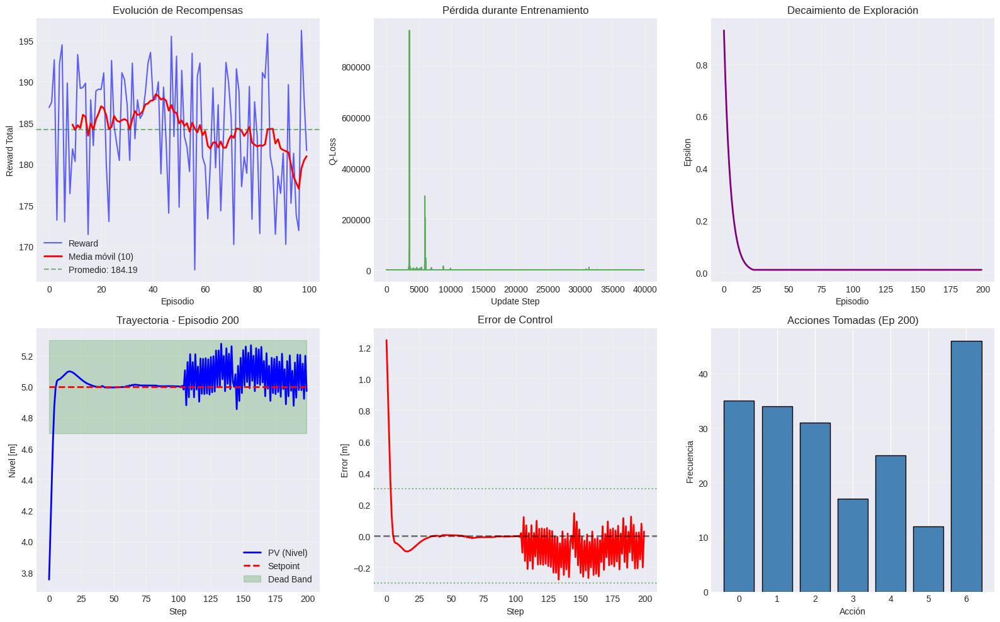


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       174
  Tasa de éxito:            87.00%
  Reward promedio (global): 184.19
  Error estado estacionario: 0.1470

  Últimos 10 episodios:
    Reward promedio:        180.96
    Desviación estándar:    8.00

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_feasible-sweep-93.pth

✅ Run completado: feasible-sweep-93
   Reward promedio: 184.19
   Tasa de éxito: 87.00%


avg_episode_reward,▆█▇▇▇▄▄▂▁▁▁▁▁▁▁▁▁▁▂▂▂▁▁▁▁▂▃▃▃▃▃▃▂▂▂▂▂▂▁▁
episode,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇████
episode_reward,▇▇▇▇▆▄▅▆▃▁▇▄▃▇▄▆▄▅█▆█▅▆▆▆▄▇▆▅▅█▅▇▄▄▃▃▆▁▄
epsilon,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▇█▁▇▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▄▁▁▁▁▁▁▁
steady_state_error,▁▁▁▂▁▃▃▄▄▃▂▁▁▂▂▁▁▁▃▁▁▁▁▁▁▁▁▁▂▁▁▁▁▃▇▃▁█▂▁
success_rate,█▆▆▅▃▁▁▂▂▂▂▂▂▃▂▂▃▃▃▃▃▃▃▃▃▃▃▄▄▄▄▄▃▃▃▂▂▂▂▂
+1,...


wandb: Agent Starting Run: dw9es7l2 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.37 | Avg:  189.37 | ε: 0.930 | 

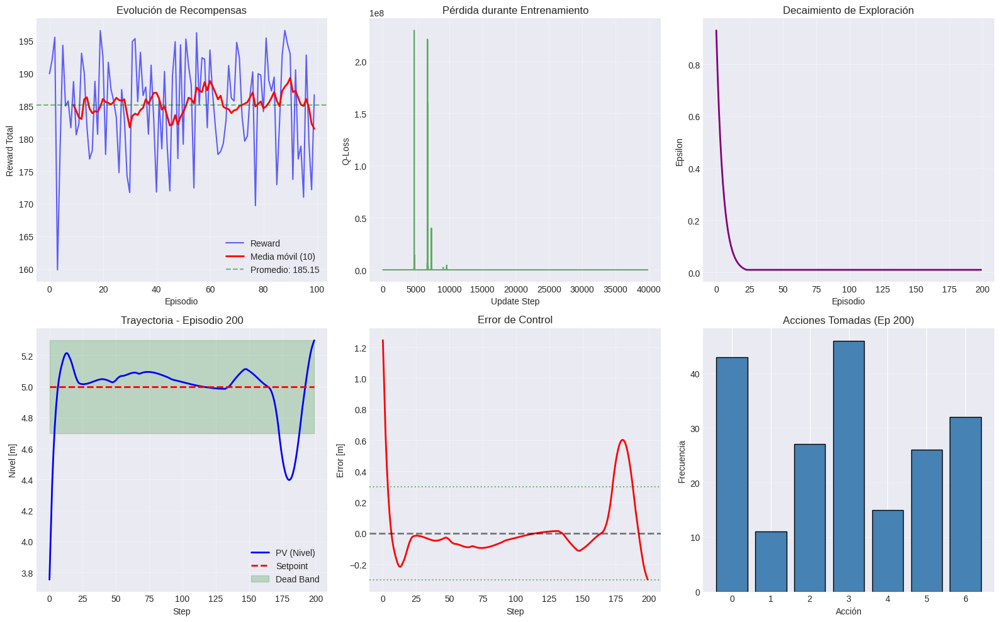


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       174
  Tasa de éxito:            87.00%
  Reward promedio (global): 185.15
  Error estado estacionario: 0.1153

  Últimos 10 episodios:
    Reward promedio:        181.50
    Desviación estándar:    8.12

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_fragrant-sweep-94.pth

✅ Run completado: fragrant-sweep-94
   Reward promedio: 185.15
   Tasa de éxito: 87.00%


avg_episode_reward,█▇▇▅▅▃▃▂▂▂▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▄▅▅▄▄▄▄▄
episode,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇██
episode_reward,▅▂▅▇▄▁▇▃▅▁▄▇▆▅█▆▅██▆▇▄▇▃▆▄▂█▄█▇▆▄▅▆▆▇▅▆▂
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▂▁▁▅▃▂█▃▅▁▁▁▁▁▁▁▁▂▂▁▁▂▂▂▁▁▂▂▄▂▁▁▁▁▁▂▂▂▁
success_rate,████▇▃▃▂▂▂▁▁▂▂▂▂▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅
+1,...


wandb: Agent Starting Run: 8b0lkqsd with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.14 | Avg:  186.14 | ε: 0.930 |

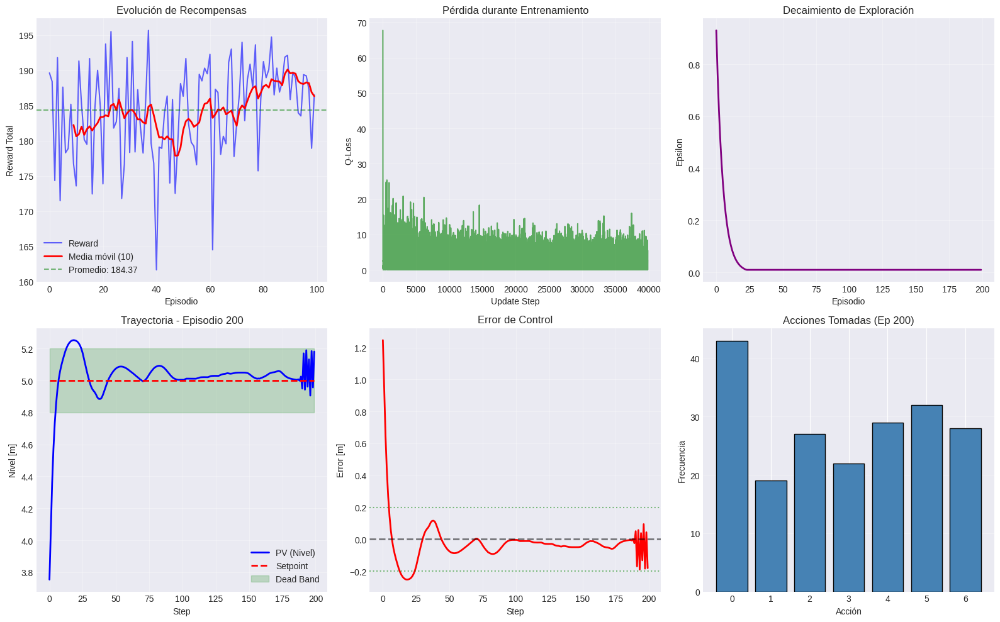


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       171
  Tasa de éxito:            85.50%
  Reward promedio (global): 184.37
  Error estado estacionario: 0.0932

  Últimos 10 episodios:
    Reward promedio:        186.30
    Desviación estándar:    3.24

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_eager-sweep-95.pth

✅ Run completado: eager-sweep-95
   Reward promedio: 184.37
   Tasa de éxito: 85.50%


avg_episode_reward,▇█▄▄▄▄▄▂▂▂▂▁▂▂▂▂▁▂▂▂▂▂▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▄▄▅
episode,▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇█
episode_reward,▃▅▅▅▆▁▄▆▆▃▆▄▂▅▅▆▆█▇▃▆▃▄▅▄▆▃▆▇▇▇▆▅▆▇▆▇▆▅▆
epsilon,█▅▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▅▅▅▄▃▃▃▁▃▃▂▃▂▂▃▂▂▂▂▂▂▂▂▁▂▃▂▂▃▂▂▂▃▁▂▂▃▁▁
steady_state_error,▃▁▂▂▁▂▂█▂▁▂▂▂▁▁▁▁▁▂▁▁▂▁▁▁▁▁▁▂▁▁▂▅▁▁▁▁▁▁▁
success_rate,▁▁▂▄▄▇▆▅▅▅▅▄▅▅▅▆▆▆▆▇▆▆▇▇▇▇▇▇▇███▇███████
+1,...


wandb: Agent Starting Run: p9ue3pic with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  186.14 | Avg:  186.14 | ε: 0.930 | 

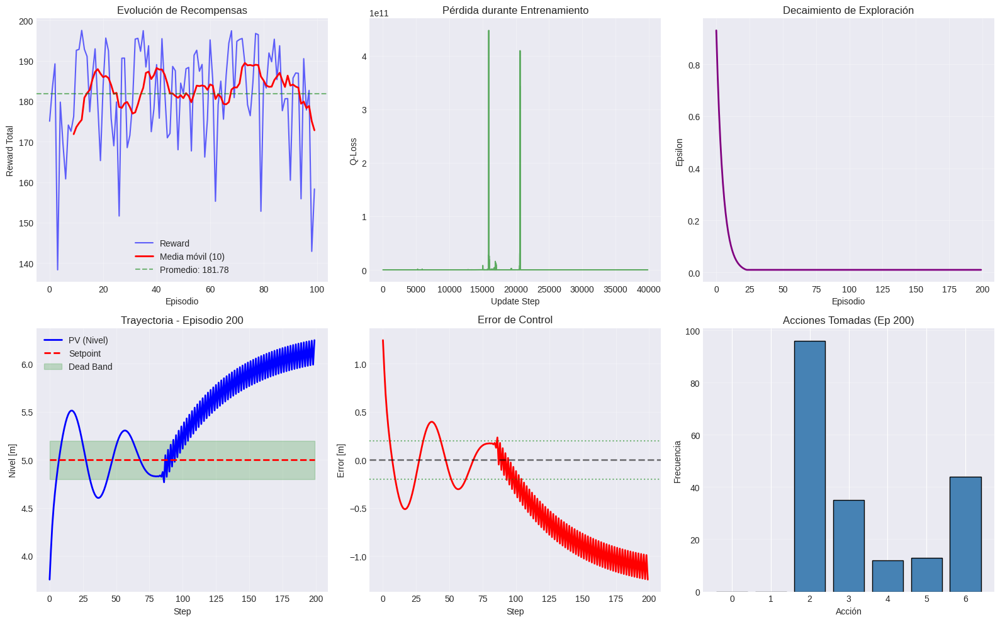


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       144
  Tasa de éxito:            72.00%
  Reward promedio (global): 181.78
  Error estado estacionario: 0.2494

  Últimos 10 episodios:
    Reward promedio:        172.81
    Desviación estándar:    15.96

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_hearty-sweep-96.pth

✅ Run completado: hearty-sweep-96
   Reward promedio: 181.78
   Tasa de éxito: 72.00%


avg_episode_reward,▇▇▇██▇▇▆▆▄▄▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▂▃▃▃▃▃
episode,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇███
episode_reward,█▆▇▇▆▇▆▇▄▃▅▄▄▄▇▅▅▆▅▇▃▄▇▅▄▄▃▃▅▇▅█▄▇▂▆▄▄▅▁
epsilon,█▇▃▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▁▁▂▂▁▃▁▁▁▆▁▂▁▃▂▁▁▂▁▂▂▂▇▂▁▁▂▁▇▂▃▁▂▇▁▁▂▁█
success_rate,███▆▇▄▄▄▃▃▃▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂
+1,...


wandb: Agent Starting Run: lljwasj5 with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.1
wandb: 	delta_percent: 0.2
wandb: 	epsilon_decay: 0.99
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [128, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 64)
   Learning rate: 0.0001
   Gamma: 0.999
   Epsilon: 1.0 → 0.01 (decay: 0.99)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.63 | Avg:  185.63 | ε: 0.480 | Suc

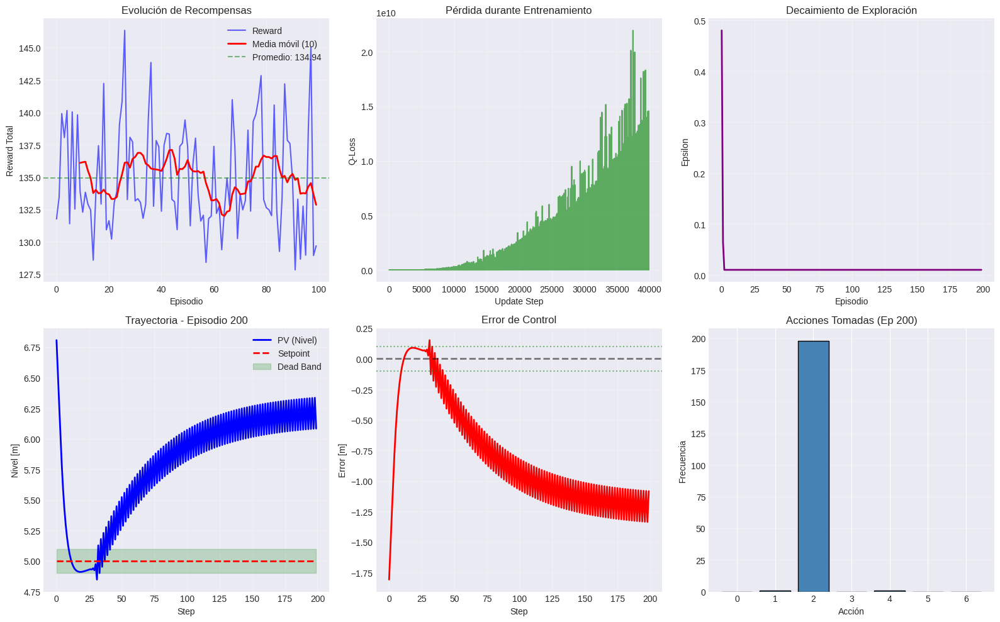


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       16
  Tasa de éxito:            8.00%
  Reward promedio (global): 134.94
  Error estado estacionario: 1.1417

  Últimos 10 episodios:
    Reward promedio:        132.85
    Desviación estándar:    5.19

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39873

💾 Agente guardado en: models/pid_dqn_stellar-sweep-97.pth

✅ Run completado: stellar-sweep-97
   Reward promedio: 134.94
   Tasa de éxito: 8.00%


avg_episode_reward,███▇▇▇▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
episode,▁▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇██
episode_reward,█▅█▆▂▂▂▁▂▂▂▁▂▁▁▂▂▂▂▁▁▁▂▁▁▁▂▁▁▂▁▂▁▁▂▁▁▁▃▁
epsilon,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▄▄▄▅▄▅▅▆▆▅▇▇▇███
steady_state_error,▁▁▂▂▇▇▇▂▇█▇██▇▇███▇█▆██▇██▇▇▁█▇▇██▇▇▇███
success_rate,█▇▇▆▆▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: c45wbzco with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 100


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.65 | Avg:  189.65 | ε: 0.872 | 

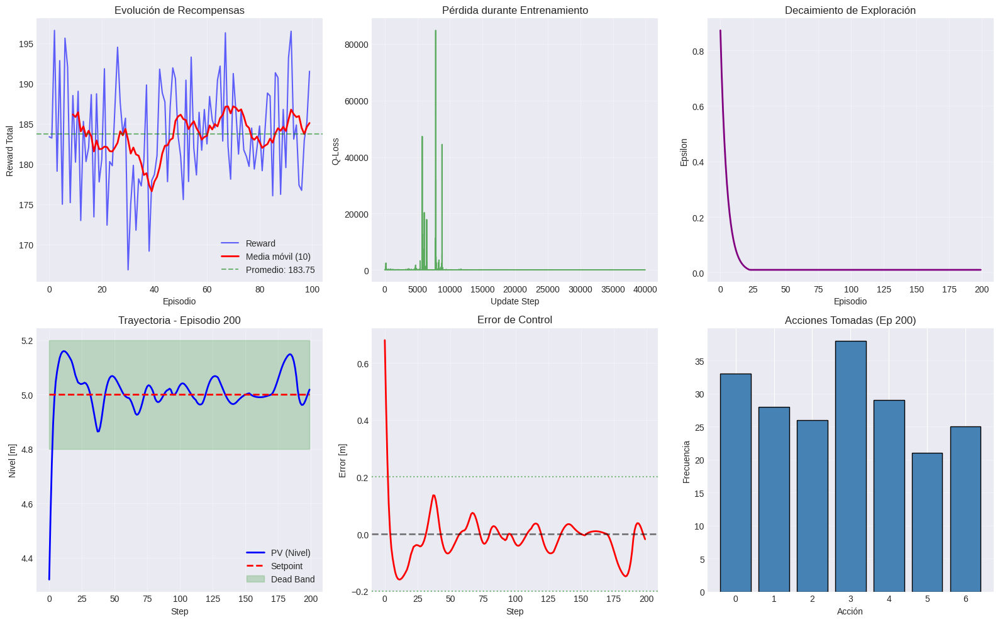


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       166
  Tasa de éxito:            83.00%
  Reward promedio (global): 183.75
  Error estado estacionario: 0.1315

  Últimos 10 episodios:
    Reward promedio:        185.08
    Desviación estándar:    6.37

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_fast-sweep-98.pth

✅ Run completado: fast-sweep-98
   Reward promedio: 183.75
   Tasa de éxito: 83.00%


avg_episode_reward,▇▇▇██▆▅▄▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂
episode,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇█████
episode_reward,▅▆▅▄▄▇▂▁▆▃▄█▇▁▅██▂▆▆▅▆▇▄▇▂▃▃▆▅▅▄▄▄▄▃▃▄▃▇
epsilon,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▁▁▁▁▁▁▂▁█▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▂▁▂▁▃▁▁▁▁▁▂▂▁▁▁▆▂▁▁▁▂▁▅▂▃█▂▃▂▂▂▂▃▁▂▂▂▁▅
success_rate,███▄▃▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▂▂▁
+1,...


wandb: Agent Starting Run: xeu61qs5 with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [256, 128, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (256, 128, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.16 | Avg:  185.16 | ε: 0.872 |

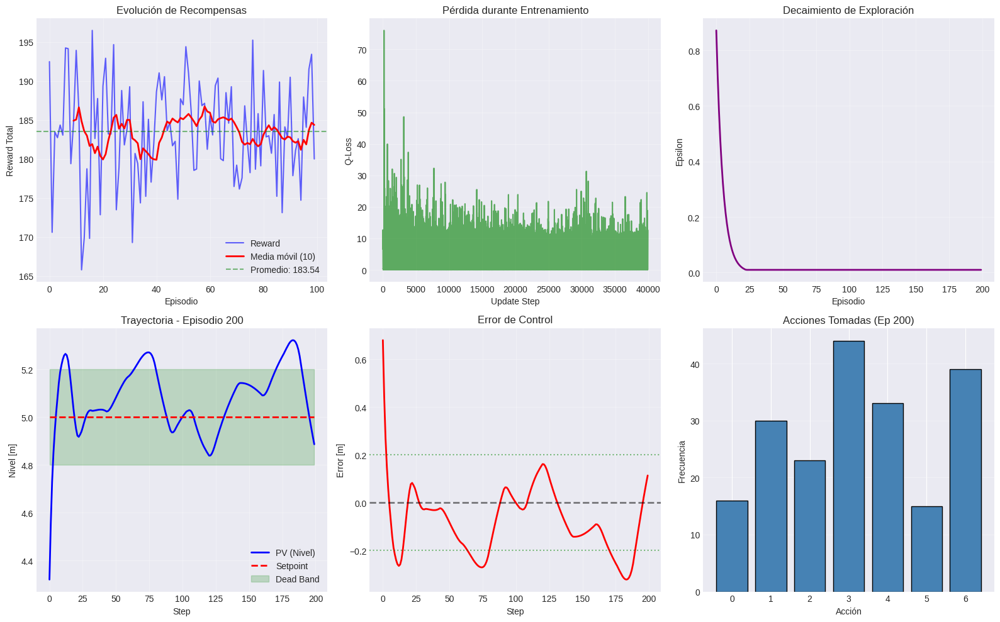


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       176
  Tasa de éxito:            88.00%
  Reward promedio (global): 183.54
  Error estado estacionario: 0.0990

  Últimos 10 episodios:
    Reward promedio:        184.36
    Desviación estándar:    5.92

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_lucky-sweep-99.pth

✅ Run completado: lucky-sweep-99
   Reward promedio: 183.54
   Tasa de éxito: 88.00%


avg_episode_reward,█▂▂▂▃▃▃▃▁▂▂▁▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▂▂▂▂
episode,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇████
episode_reward,▆▆▃▆▆▁▄▆▂▅▇▅▄▅▇█▆█▂▅█▂▇▂▁▅▅▅▇▆▄▇▄▃█▇▅▅▃▄
epsilon,█▆▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▄▅█▇▂▃▄▄▄▄▃▃▄▃▂▂▂▄▂▃▄▂▁▂▃▄▂▂▃▃▄▃▂▃▂▁▃▁▁▂
steady_state_error,▂▂▄▁▅▅▄▄▃▂▁▂▂▁▁▂▁▂▂▁▁▁▁▂█▂▁▂▄▁▂▂▂▁▁▁▇▄▃▄
success_rate,██▂▃▃▄▄▂▃▃▂▂▁▁▂▂▂▃▃▃▂▂▂▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
+1,...


wandb: Agent Starting Run: sck0t9u4 with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (64, 64)
   Learning rate: 0.001
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  189.66 | Avg:  189.66 | ε: 0.872 | Succe

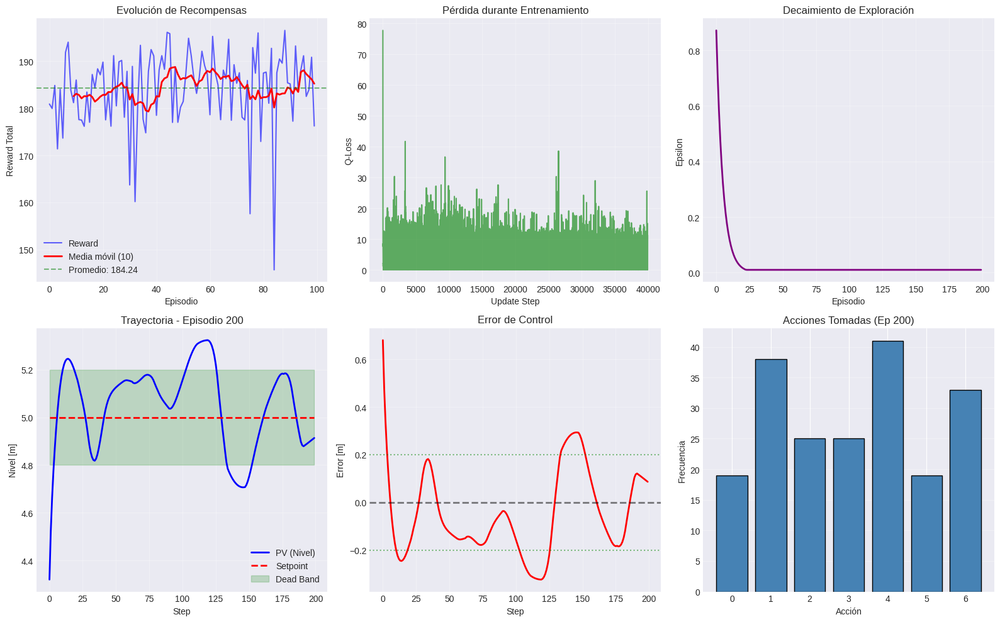


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       153
  Tasa de éxito:            76.50%
  Reward promedio (global): 184.24
  Error estado estacionario: 0.1490

  Últimos 10 episodios:
    Reward promedio:        185.23
    Desviación estándar:    5.43

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   10000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_serene-sweep-100.pth

✅ Run completado: serene-sweep-100
   Reward promedio: 184.24
   Tasa de éxito: 76.50%


avg_episode_reward,▅▅▆█▅▄▄▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▂▃▃▃▄▄▄▃▃▃▃▃
episode,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇██████
episode_reward,▄▄▆▆▇▃▆▃▄▆▃▆▁▃▂▃▂▅▂▃▇▄▄▆▃▃▂▇▆█▄▇█▅▅▆█▇▆▂
epsilon,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,▇▆▆▆▁▆█▆█▄▃▆▅▃▅▄▅▆▇▇▅▅▅▂▄▇▄▃▄▃▄▃▂▆▃▂▄▅▃▃
steady_state_error,▄▁▁▁▁▁▅▄▂▂▄▂▁▁▅▁▃▁▁▃▁▁█▃▁▄▂█▃▁▁▁▁▁▁▂▁▁▁▂
success_rate,█▅▅▅▂▁▂▂▁▁▂▁▁▂▂▂▂▂▃▃▂▂▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
+1,...


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: emxc2h0h with config:
wandb: 	batch_size: 64
wandb: 	dead_band: 0.3
wandb: 	delta_percent: 0.3
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  191.98 | Avg:  191.98 | ε: 0.872 | 

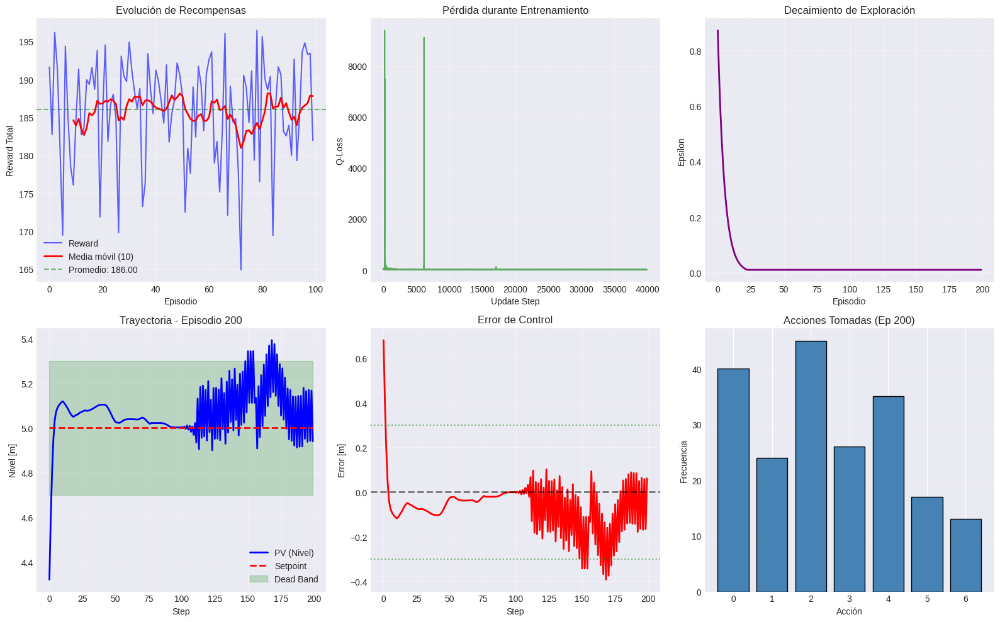


✅ ENTRENAMIENTO COMPLETADO

📊 MÉTRICAS DEL AMBIENTE (MetricsTracker):
  Total episodios:          200
  Episodios exitosos:       180
  Tasa de éxito:            90.00%
  Reward promedio (global): 186.00
  Error estado estacionario: 0.1139

  Últimos 10 episodios:
    Reward promedio:        187.80
    Desviación estándar:    6.00

🤖 MÉTRICAS DEL AGENTE:
  Epsilon final:            0.0100
  Experiencias en buffer:   20000
  Updates realizados:       39937

💾 Agente guardado en: models/pid_dqn_golden-sweep-101.pth

✅ Run completado: golden-sweep-101
   Reward promedio: 186.00
   Tasa de éxito: 90.00%


avg_episode_reward,▅▇▆█▄▄▃▂▂▃▃▂▂▂▂▁▁▁▂▂▂▂▂▂▂▂▁▁▁▂▃▂▂▃▂▃▃▂▃▃
episode,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇███
episode_reward,▅▆▄▇▅▄▆▄▇▇▇▆▅▇▇▇▇█▆▄▇▇▅▆▇▆▇▆▅▅▅▅▁▇█▇▆▅▅▇
epsilon,█▇▅▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
final_avg_reward,▁
final_epsilon,▁
final_success_rate,▁
q_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
steady_state_error,▁▂▃▃▂▁▃▁▁▁▂▁▃▁▁▁▆▁▃▁▆▂▁▁▂▂█▁▁▁▂▂▁▂▁▃▁▁▁▂
success_rate,██▆▆▆▅▆▄▄▄▂▃▂▂▂▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃
+1,...


wandb: Agent Starting Run: 2vtqrftc with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.2
wandb: 	delta_percent: 0.5
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.95
wandb: 	hidden_dims: [128, 128, 64]
wandb: 	lr: 0.01
wandb: 	memory_size: 20000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 200


✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
✅ DQN Agent creado
   Estado: 6 dims
   Acciones: 7 (DeltaPIDActionSpace)
   Hidden layers: (128, 128, 64)
   Learning rate: 0.01
   Gamma: 0.95
   Epsilon: 1.0 → 0.01 (decay: 0.999)
   Device: cpu

ENTRENAMIENTO: 200 episodios

✅ Modo: PID Tuning (Simulación)
   Acciones disponibles: 7
   PID inicial: (np.float32(1.0), np.float32(0.1), np.float32(0.05))
   PIDController interno: Activo
🚰 Simulador de Tanque creado
   Área: 1.0 m²
   Coeficiente descarga: 0.1 m^2.5/s
   Altura máxima: 10.0 m
   Caudal máximo entrada: 0.5 m³/s
   Paso de tiempo: 1.0 s
✅ Proceso simulado conectado
Ep   1/200 | Reward:  185.58 | Avg:  185.58 | ε: 0.930 | 

In [ ]:
wandb.agent(sweep_id, function=sweep_run)

In [14]:
WANDB_TEAM_NAME = "valeriaeskenazi-universidad-ort-uruguay"
WANDB_PROJECT = "Tesis_maestría"

sweep_config = {
    "name": "pid_rl_dqn_experiments_2",
    "method": "bayes",  # ← Recomendado: explora inteligentemente
    # Opciones: "grid", "random", "bayes"

    "metric": {
        "name": "final_avg_reward",  # ← Métrica principal
        "goal": "maximize"  # ← Maximizar reward
    },

    "parameters": {
        # ========== ARQUITECTURA DE RED ==========
        "hidden_dims": {
            "values": [
                [64, 64],
            ]
        },

        # ========== HIPERPARÁMETROS DE AGENTE ==========
        "lr": {
            "values": [0.0001, 0.00001, 0.000015]
        },

        "gamma": {
            "values": [0.999]
        },

        "epsilon_decay": {
            "values": [0.999]
        },

        "batch_size": {
            "values": [128]
        },

        "memory_size": {
            "values": [10000]
        },

        "target_update_freq": {
            "values": [50, 100, 200]
        },

        # ========== PARÁMETROS DE AMBIENTE ==========
        "delta_percent": {
            "values": [0.1, 0.05, 0.03, 0.01]
        },

        "dead_band": {
            "values": [0.1, 0.05]
        },

        # ========== ENTRENAMIENTO ==========
        "n_episodes": {
            "value": 200
        }
    }
}

sweep_id = wandb.sweep(sweep_config, project=WANDB_PROJECT)

Create sweep with ID: madsaqk1
Sweep URL: https://wandb.ai/valeriaeskenazi-universidad-ort-uruguay/Tesis_maestr%C3%ADa/sweeps/madsaqk1


In [16]:
def sweep_run():
    """
    Función que se ejecutará en cada run del sweep.
    """
    # Inicializar un nuevo run
    wandb.init()
    os.makedirs('results', exist_ok=True)
    os.makedirs('models', exist_ok=True)

    # ========== REPRODUCIBILIDAD ==========
    SEED = 42
    random.seed(SEED)
    np.random.seed(SEED)
    torch.manual_seed(SEED)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(SEED)
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False

    # Loguear la semilla en W&B
    wandb.config.update({"seed": SEED}, allow_val_change=True)

    # Leer la configuración del run
    config = wandb.config
    run_hidden_dims = config.hidden_dims
    run_lr = config.lr
    run_gamma = config.gamma
    run_epsilon_decay = config.epsilon_decay
    run_batch_size = config.batch_size
    run_memory_size = config.memory_size
    run_target_update_freq = config.target_update_freq
    run_delta_percent = config.delta_percent
    run_dead_band = config.dead_band
    run_n_episodes = config.n_episodes

    # ========== CONFIGURAR AMBIENTE ==========
    env_config = {
        'upper_range': 10.0,
        'lower_range': 0.0,
        'setpoint': 5.0,
        'dead_band': run_dead_band,
        'max_episode_steps': 200,
        'dt': 1.0,
        'delta_percent': run_delta_percent,
        'initial_pid': (1.0, 0.1, 0.05)
    }

    env = SimulationPIDEnv(config=env_config, control_mode='pid_tuning')
    tank = TankSimulator(area=1.0, cv=0.1, max_height=10.0, max_flow_in=0.5, dt=1.0)
    env.connect_external_process(tank)

    # ========== CONFIGURAR AGENTE ==========
    agent = DQNAgent(
        state_dim=6,
        action_dim=7,
        hidden_dims=tuple(run_hidden_dims),
        lr=run_lr,
        gamma=run_gamma,
        epsilon_start=1.0,
        epsilon_min=0.0001,
        epsilon_decay=run_epsilon_decay,
        memory_size=run_memory_size,
        batch_size=run_batch_size,
        target_update_freq=run_target_update_freq,
        device='cpu'
    )

  # ========== ENTRENAR CON LOGGING PROGRESIVO ==========
    results = train_DQN(
        n_episodes=run_n_episodes,
        env_config=env_config,
        agent=agent,
        save_path=f'results/sweep_{wandb.run.name}.png',
        log_callback=wandb_log_callback  # ← Pasar callback
    )

    # ========== LOGUEAR MÉTRICAS FINALES ADICIONALES ==========
    tracker_summary = results['tracker_summary']

    wandb.log({
        "final_avg_reward": tracker_summary['avg_episode_reward'],
        "final_success_rate": tracker_summary['success_rate'],
        "final_epsilon": results['agent_epsilon'],
        "total_episodes": tracker_summary['total_episodes']
    })

    # Guardar modelo
    model_path = f"models/pid_dqn_{wandb.run.name}.pth"
    agent.save(model_path)
    wandb.save(model_path)

    # Guardar gráfico
    wandb.save(f'results/sweep_{wandb.run.name}.png')

    print(f"\n✅ Run completado: {wandb.run.name}")
    print(f"   Reward promedio: {tracker_summary['avg_episode_reward']:.2f}")
    print(f"   Tasa de éxito: {tracker_summary['success_rate']:.2%}")

    wandb.finish()

In [ ]:
wandb.agent(sweep_id, function=sweep_run)

wandb: Agent Starting Run: 0rs70syb with config:
wandb: 	batch_size: 128
wandb: 	dead_band: 0.05
wandb: 	delta_percent: 0.1
wandb: 	epsilon_decay: 0.999
wandb: 	gamma: 0.999
wandb: 	hidden_dims: [64, 64]
wandb: 	lr: 0.0001
wandb: 	memory_size: 10000
wandb: 	n_episodes: 200
wandb: 	target_update_freq: 50
